In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
! pip install -q ..


[notice] A new release of pip is available: 23.0 -> 23.1
[notice] To update, run: pip install --upgrade pip


In [1]:
import mouse_gait_analysis
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from tqdm import tqdm
from skimage import draw

from mouse_gait_analysis.io import *
from mouse_gait_analysis.utils import *
from mouse_gait_analysis.plots import *

In [2]:
# data_folder = Path("/shared/thea/trial-analysis/")
data_folder = Path("/home/andretelfer/shared/curated/thea/v3")
! ls {data_folder}/

analysis_config.yaml  registration_points.csv  view_transforms.csv
datafiles.csv	      treatments.csv
labels		      videos


In [4]:
treatments = pd.read_csv(data_folder/'treatments.csv')
treatments['mouse'] = treatments.Animal.apply(lambda x: f"m{x:02}")
treatments['treatment'] = treatments['Treatment ']
treatments = treatments[['mouse', 'treatment']]

In [98]:
raw_videos = [
    'm01_baseline.mp4',
    'm01_recording1.mp4',
    'm01_recording2.mp4',
    'm01_recording3.mp4',
]
raw_videos = list(map(lambda x: Path(data_folder / 'videos' / x), raw_videos))

In [5]:
raw_videos = []

for mouse in treatments[treatments.treatment.isin(['PQ', 'SAL', 'LPS'])].mouse.unique():
    raw_videos.append(data_folder / 'videos' / f"{mouse}_baseline.mp4")
    raw_videos.append(data_folder / 'videos' / f"{mouse}_recording1.mp4")
    raw_videos.append(data_folder / 'videos' / f"{mouse}_recording2.mp4")
    raw_videos.append(data_folder / 'videos' / f"{mouse}_recording3.mp4")

In [ ]:
raw_videos = list(data_folder.glob('videos/*.mp4'))
print(len(raw_videos))
raw_videos = list(filter(lambda x: 'labeled' not in x.parts[-1], raw_videos))

64
Video 1/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3635/3635 [00:13<00:00, 275.36it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m01_baseline, steps: 801 -- left_back_paw, stride-length: 4.04 +/- 2.42, duration: 11.38 +/- 7.80


100%|██████████| 3809/3809 [00:13<00:00, 282.46it/s]


m01_baseline, steps: 914 -- right_back_paw, stride-length: 4.09 +/- 2.46, duration: 12.56 +/- 7.47


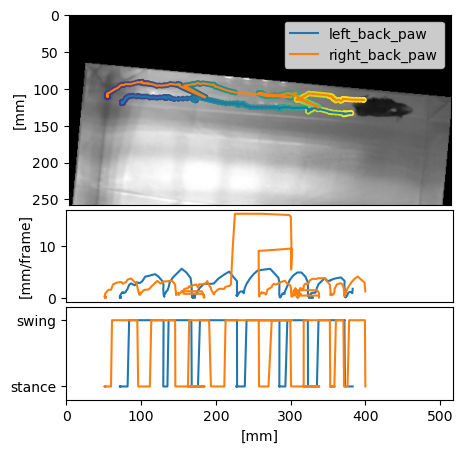

100%|██████████| 64083/64083 [00:00<00:00, 239777.04it/s]


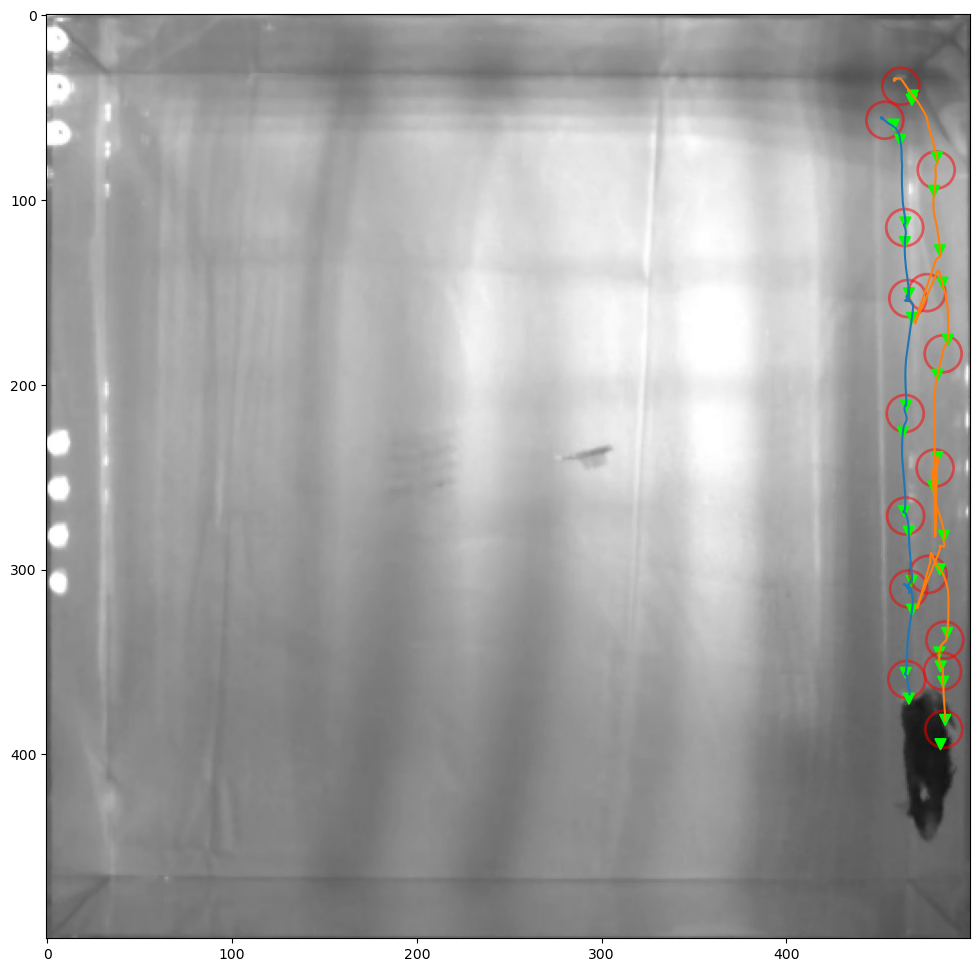

Video 2/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2105/2105 [00:06<00:00, 312.97it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m01_recording1, steps: 412 -- left_back_paw, stride-length: 4.20 +/- 2.55, duration: 12.05 +/- 7.57


100%|██████████| 2161/2161 [00:06<00:00, 316.18it/s]


m01_recording1, steps: 438 -- right_back_paw, stride-length: 4.67 +/- 3.04, duration: 14.12 +/- 8.13


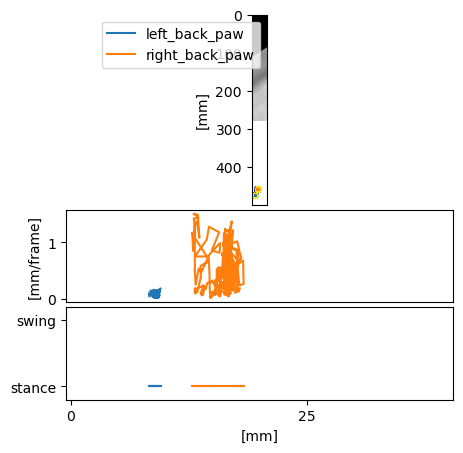

100%|██████████| 56137/56137 [00:00<00:00, 256603.63it/s]


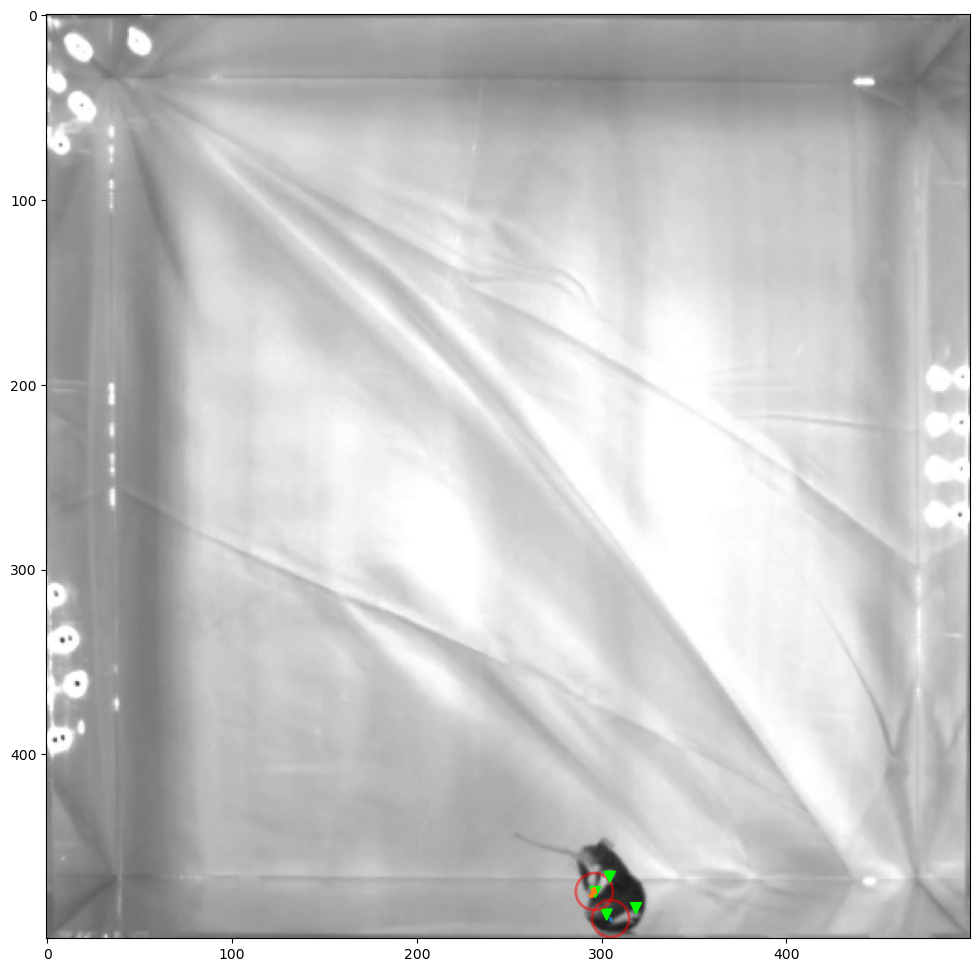

Video 3/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3013/3013 [00:11<00:00, 272.78it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m01_recording2, steps: 644 -- left_back_paw, stride-length: 4.39 +/- 2.57, duration: 11.77 +/- 7.66


100%|██████████| 3059/3059 [00:10<00:00, 281.60it/s]


m01_recording2, steps: 649 -- right_back_paw, stride-length: 4.55 +/- 2.50, duration: 13.87 +/- 7.56


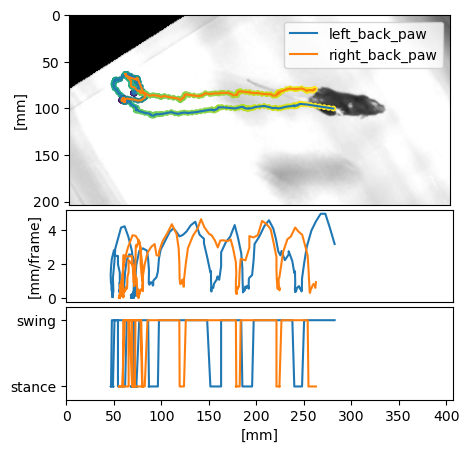

100%|██████████| 65143/65143 [00:00<00:00, 247986.50it/s]


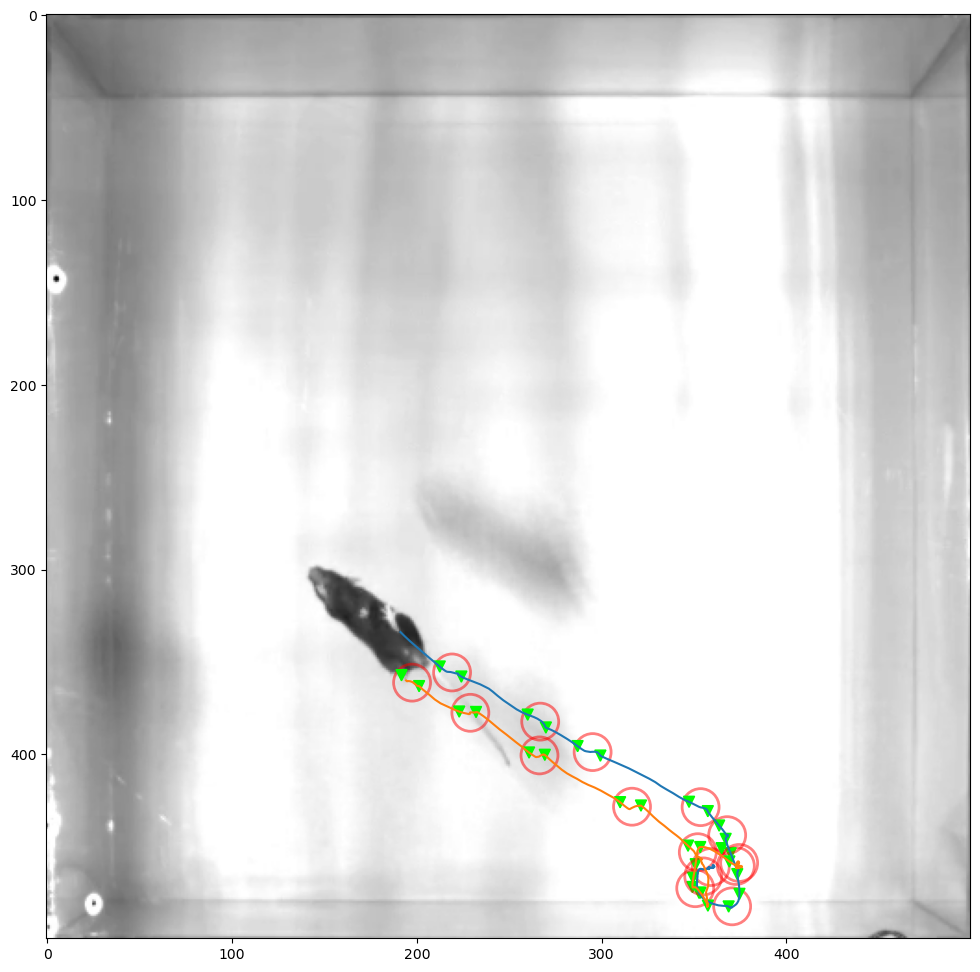

Video 4/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2123/2123 [00:07<00:00, 275.22it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m01_recording3, steps: 422 -- left_back_paw, stride-length: 4.91 +/- 2.77, duration: 12.63 +/- 8.02


100%|██████████| 2285/2285 [00:08<00:00, 278.51it/s]


m01_recording3, steps: 444 -- right_back_paw, stride-length: 4.78 +/- 2.62, duration: 14.25 +/- 8.31


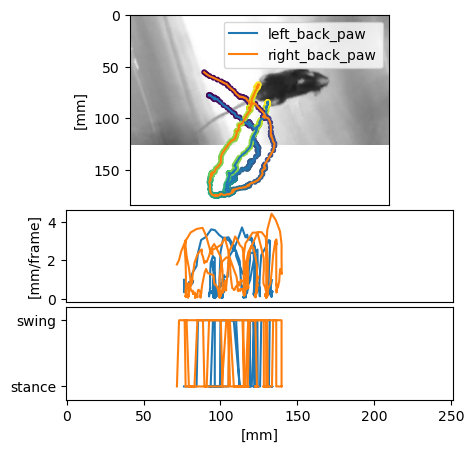

100%|██████████| 66000/66000 [00:00<00:00, 256987.94it/s]


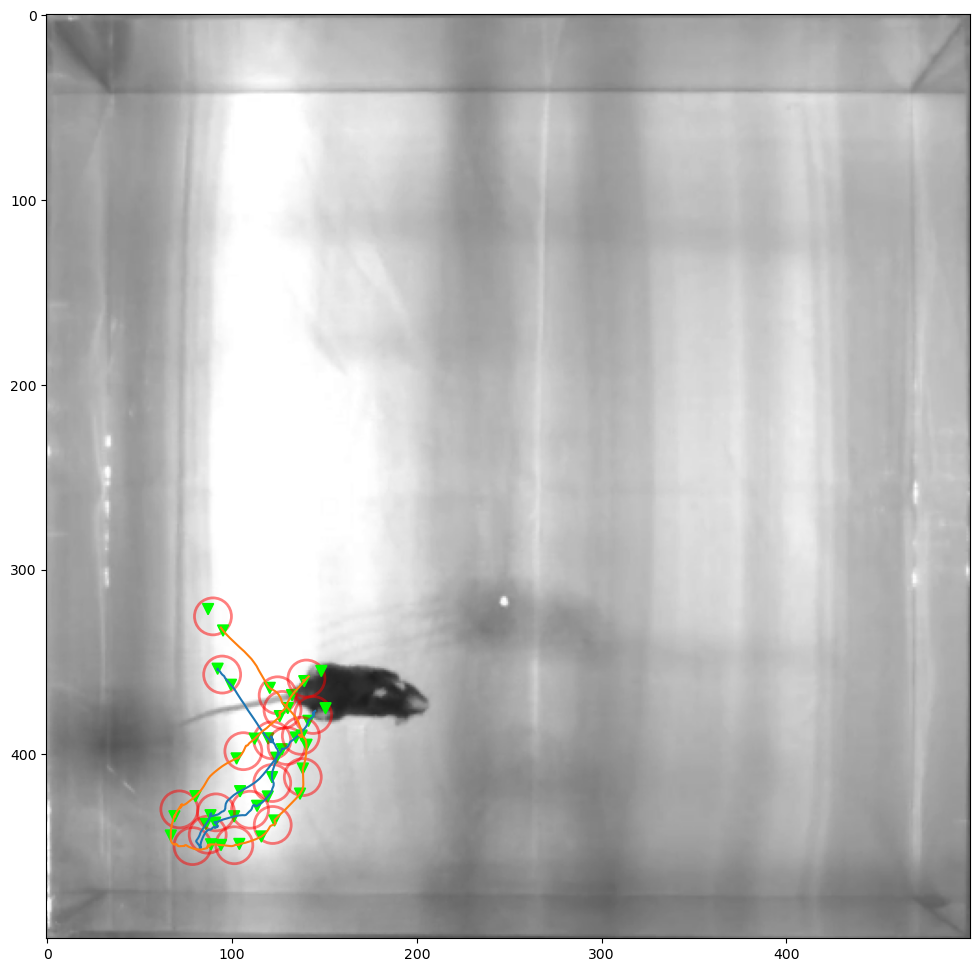

Video 5/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2977/2977 [00:10<00:00, 271.02it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m02_baseline, steps: 629 -- left_back_paw, stride-length: 4.06 +/- 2.34, duration: 10.80 +/- 7.68


100%|██████████| 2775/2775 [00:10<00:00, 266.70it/s]


m02_baseline, steps: 561 -- right_back_paw, stride-length: 4.30 +/- 2.54, duration: 10.99 +/- 7.46


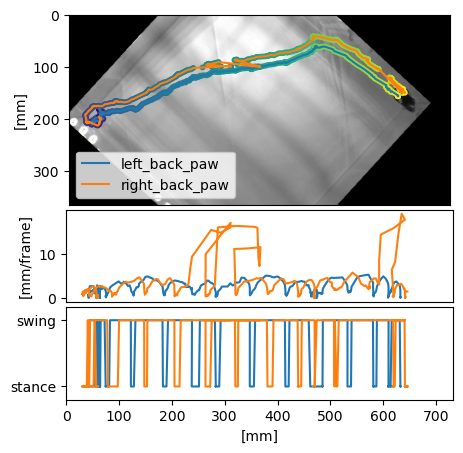

100%|██████████| 64668/64668 [00:00<00:00, 253890.20it/s]


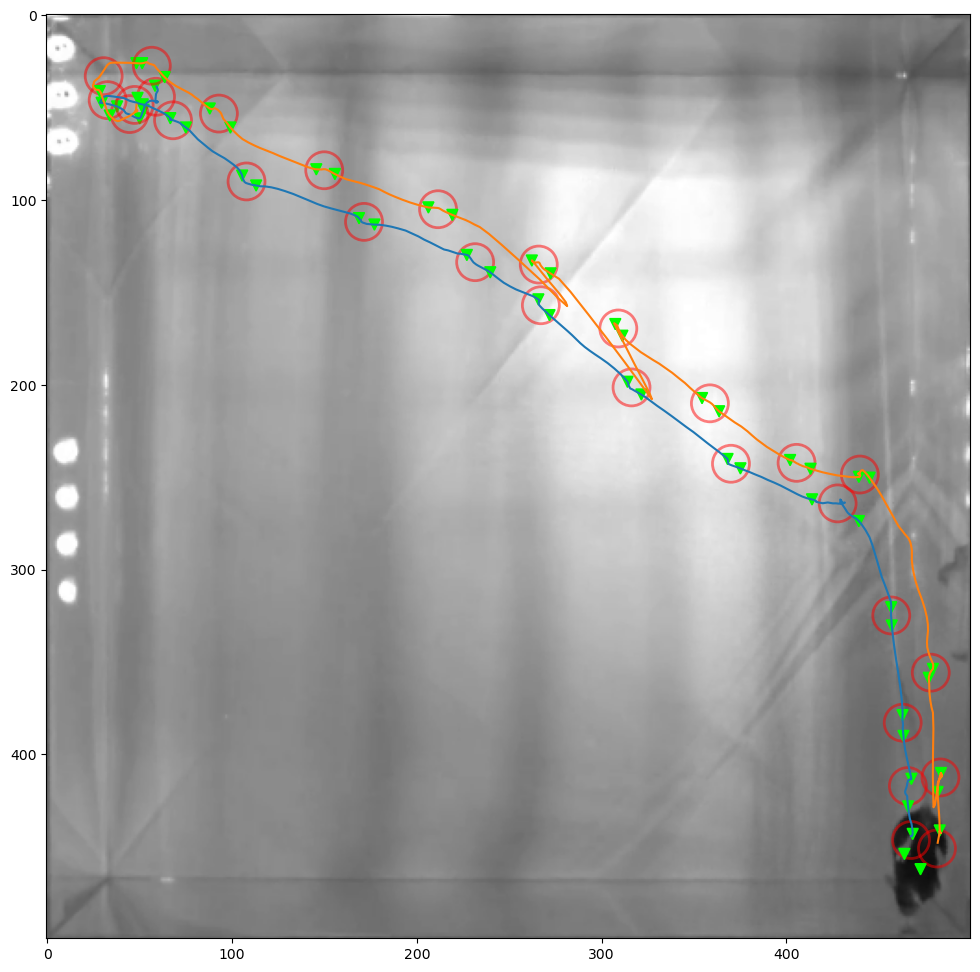

Video 6/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2103/2103 [00:07<00:00, 272.27it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m02_recording1, steps: 367 -- left_back_paw, stride-length: 4.46 +/- 2.44, duration: 11.91 +/- 7.73


100%|██████████| 1889/1889 [00:06<00:00, 274.68it/s]


m02_recording1, steps: 324 -- right_back_paw, stride-length: 4.75 +/- 2.78, duration: 12.58 +/- 8.07


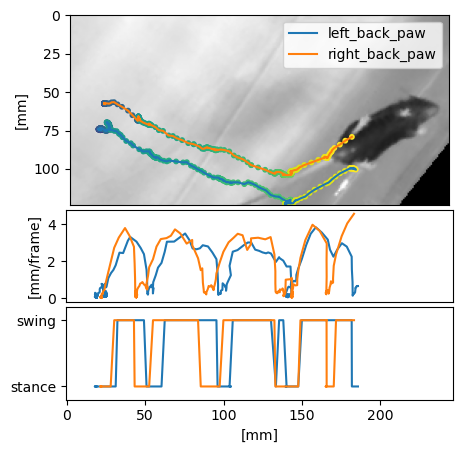

100%|██████████| 65041/65041 [00:00<00:00, 256677.74it/s]


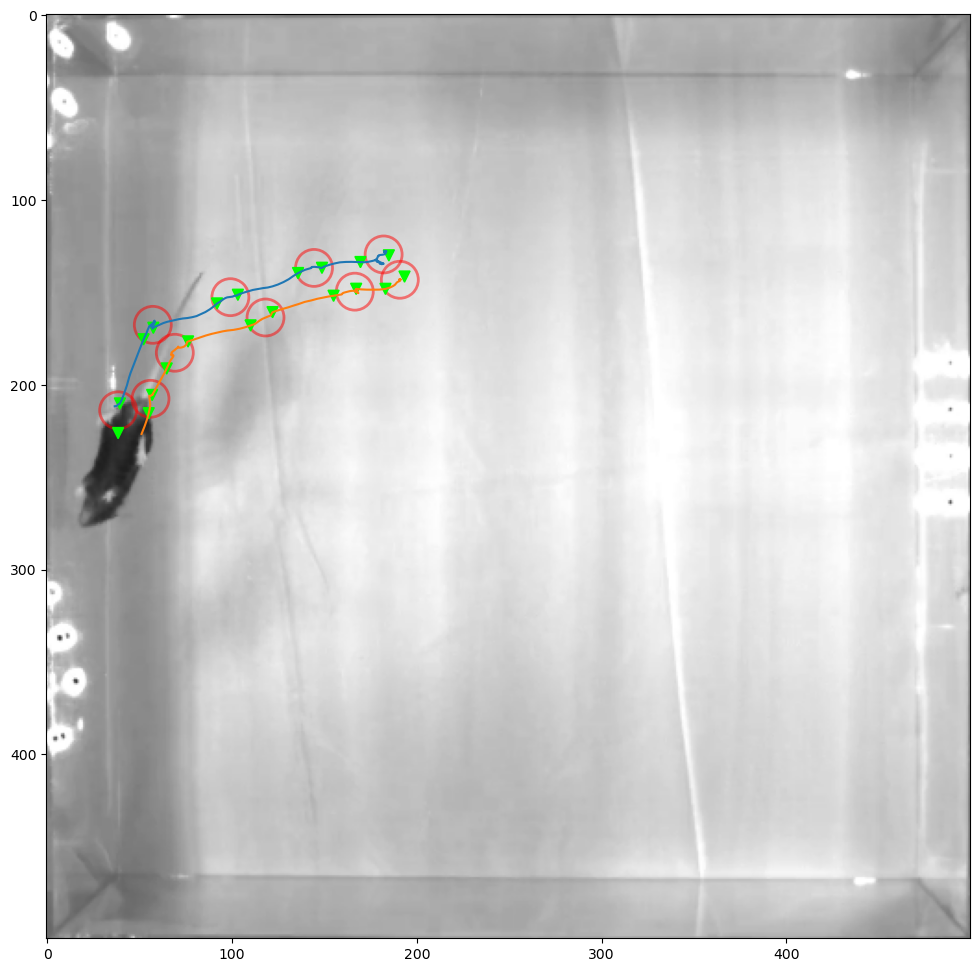

Video 7/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2883/2883 [00:10<00:00, 265.39it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m02_recording2, steps: 538 -- left_back_paw, stride-length: 4.58 +/- 2.60, duration: 13.03 +/- 8.07


100%|██████████| 2483/2483 [00:09<00:00, 270.78it/s]


m02_recording2, steps: 458 -- right_back_paw, stride-length: 4.43 +/- 2.49, duration: 13.21 +/- 8.03


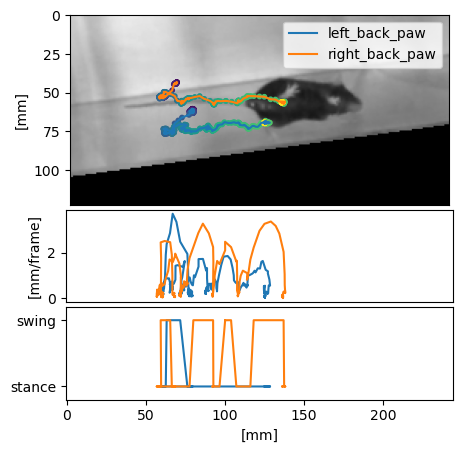

100%|██████████| 65990/65990 [00:00<00:00, 248895.61it/s]


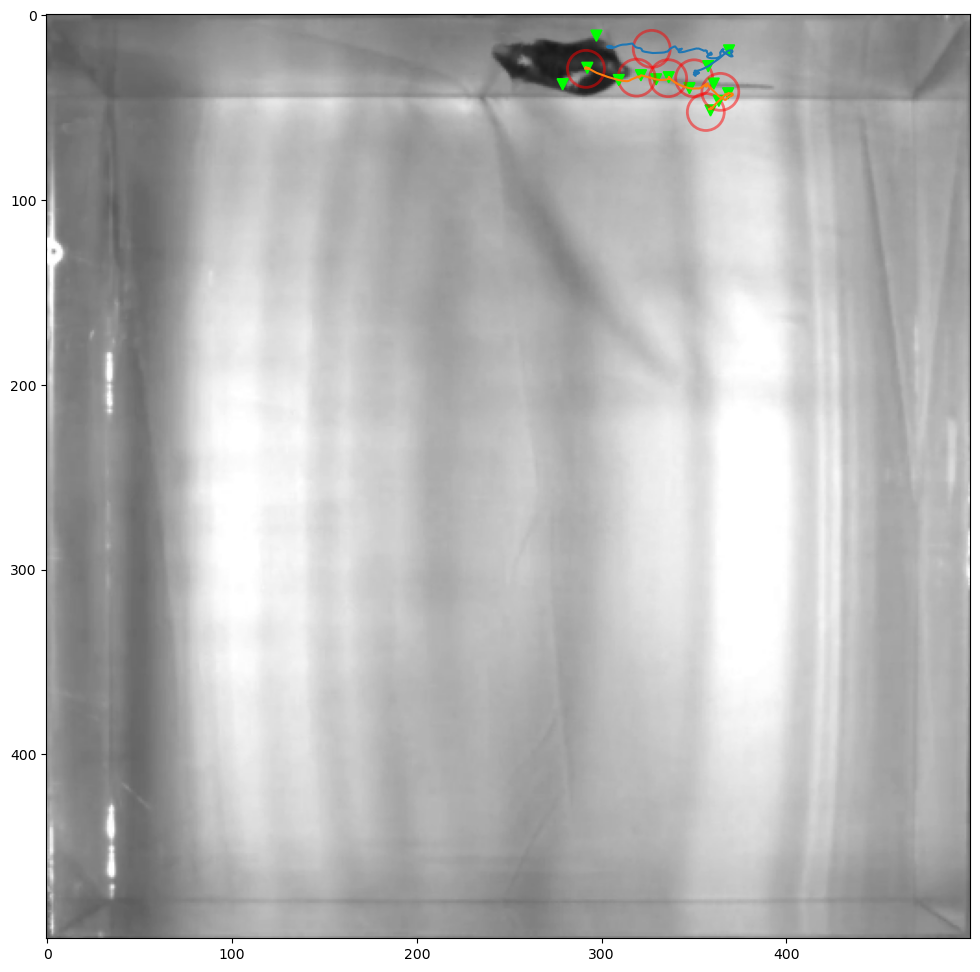

Video 8/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1237/1237 [00:04<00:00, 268.51it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m02_recording3, steps: 205 -- left_back_paw, stride-length: 4.81 +/- 2.88, duration: 12.24 +/- 7.25


100%|██████████| 1101/1101 [00:04<00:00, 273.34it/s]


m02_recording3, steps: 188 -- right_back_paw, stride-length: 4.91 +/- 2.47, duration: 12.45 +/- 7.77


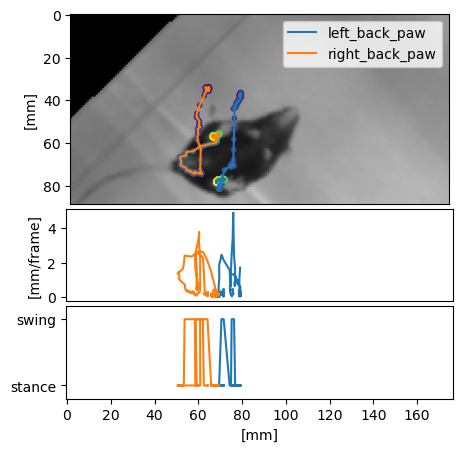

100%|██████████| 65168/65168 [00:00<00:00, 262033.43it/s]


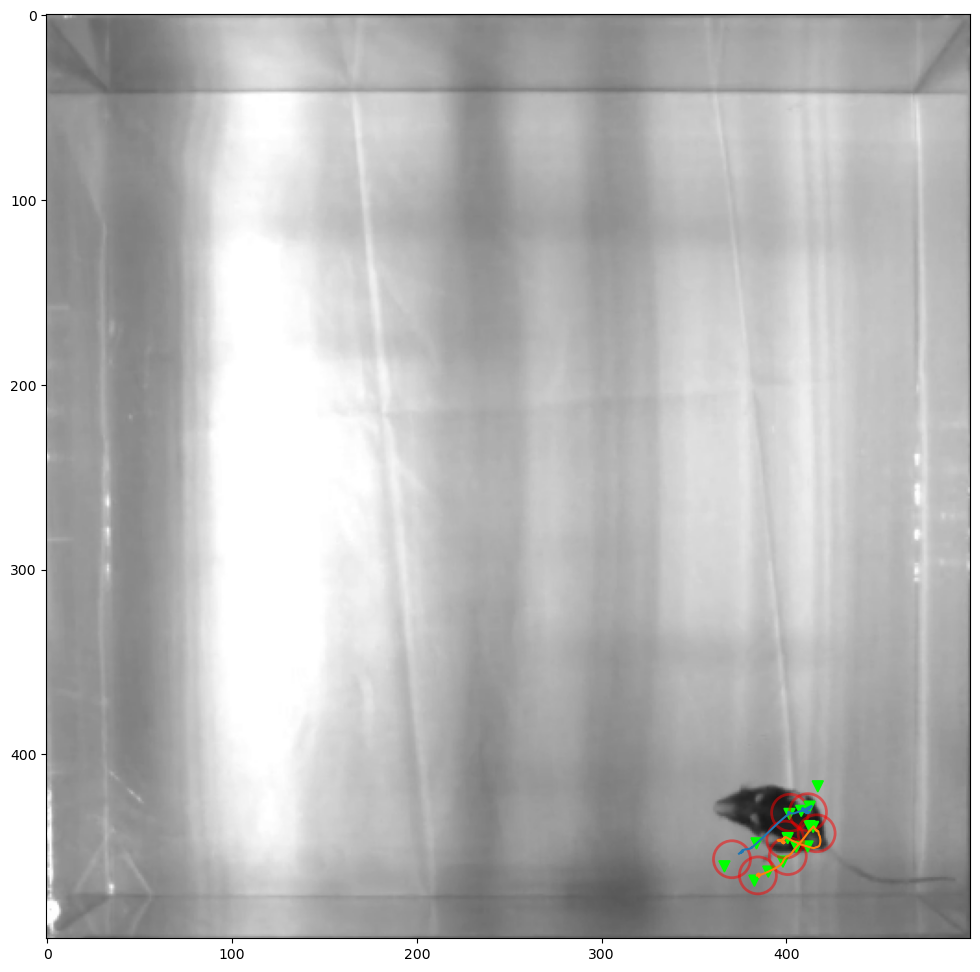

Video 9/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3325/3325 [00:12<00:00, 276.68it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m03_baseline, steps: 799 -- left_back_paw, stride-length: 3.85 +/- 2.29, duration: 10.33 +/- 7.09


100%|██████████| 3369/3369 [00:12<00:00, 269.85it/s]


m03_baseline, steps: 754 -- right_back_paw, stride-length: 3.88 +/- 2.30, duration: 10.05 +/- 7.13


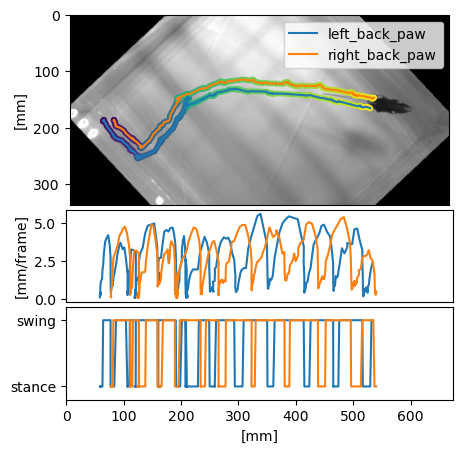

100%|██████████| 65027/65027 [00:00<00:00, 254918.11it/s]


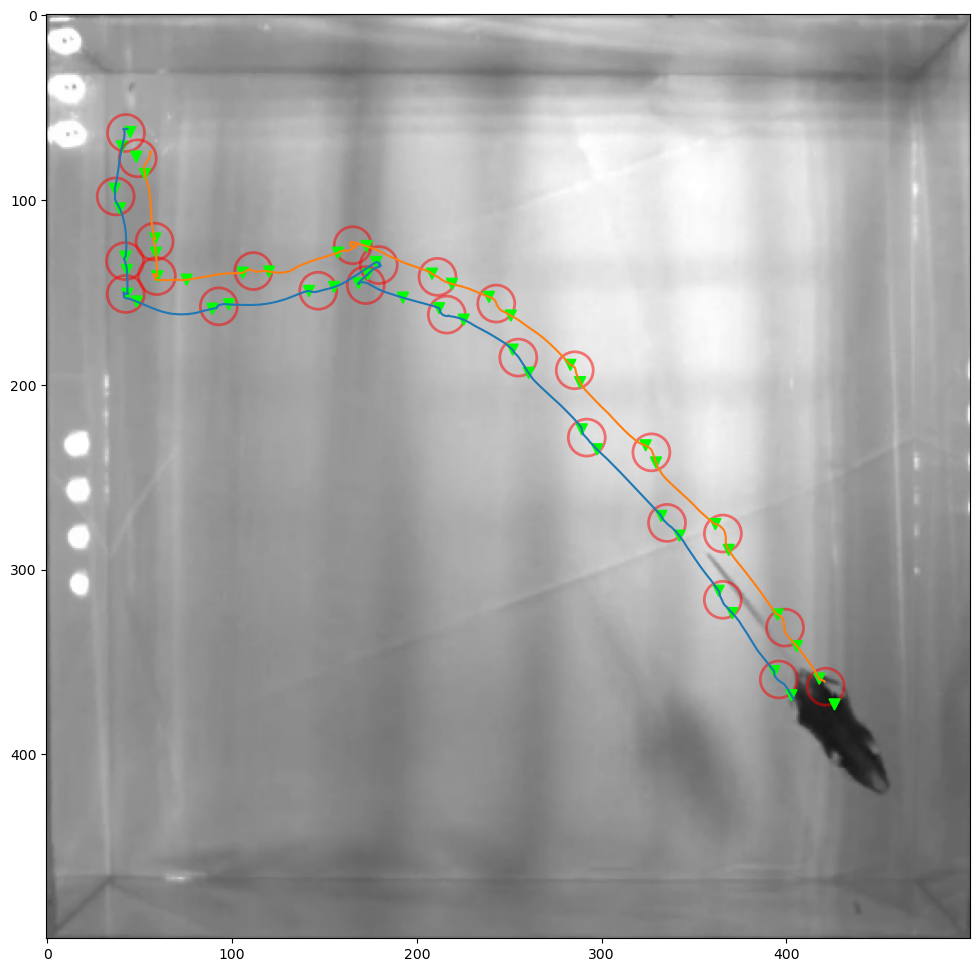

Video 10/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2297/2297 [00:08<00:00, 275.10it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m03_recording1, steps: 486 -- left_back_paw, stride-length: 4.53 +/- 2.51, duration: 12.24 +/- 7.94


100%|██████████| 2295/2295 [00:08<00:00, 269.75it/s]


m03_recording1, steps: 467 -- right_back_paw, stride-length: 4.51 +/- 2.74, duration: 11.18 +/- 7.71


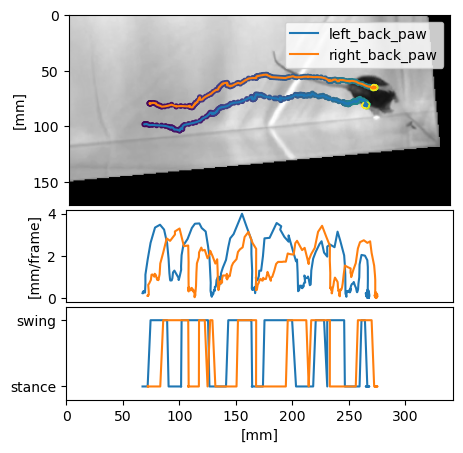

100%|██████████| 63821/63821 [00:00<00:00, 261526.26it/s]


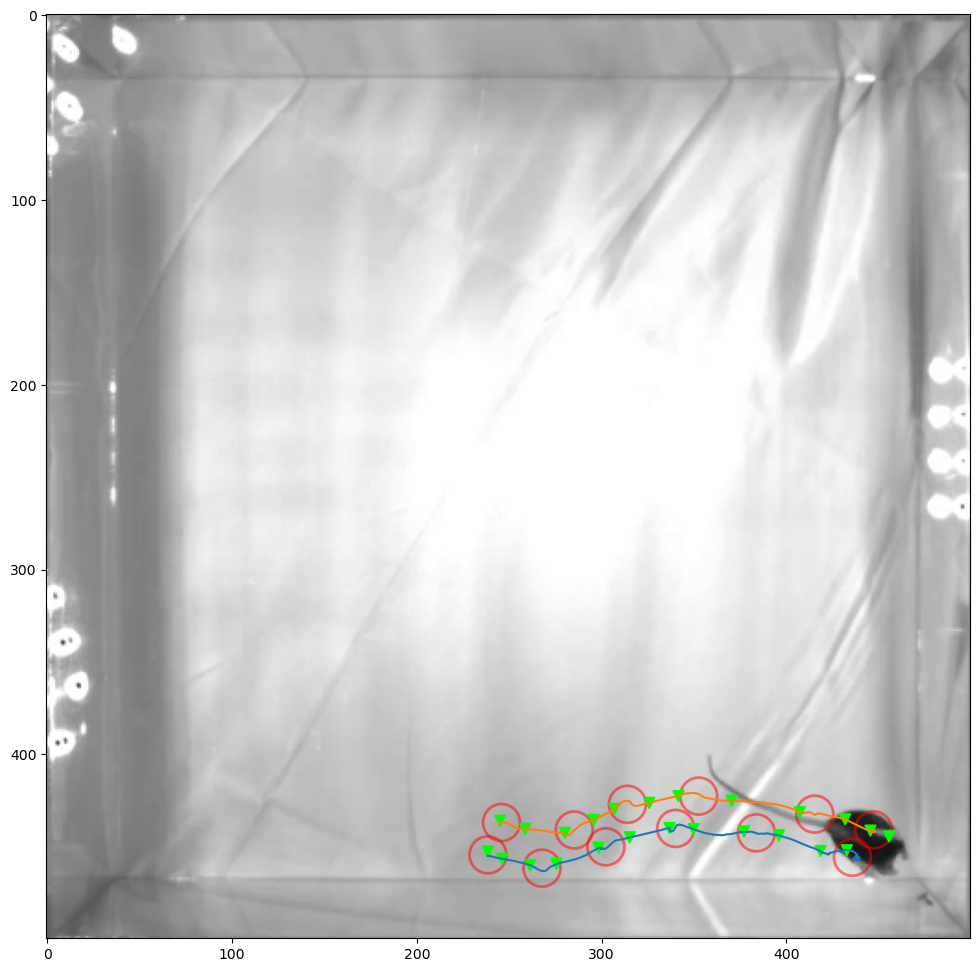

Video 11/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3523/3523 [00:13<00:00, 263.03it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m03_recording2, steps: 777 -- left_back_paw, stride-length: 4.57 +/- 2.52, duration: 11.55 +/- 7.55


100%|██████████| 3471/3471 [00:13<00:00, 264.74it/s]


m03_recording2, steps: 791 -- right_back_paw, stride-length: 4.34 +/- 2.43, duration: 10.97 +/- 7.35


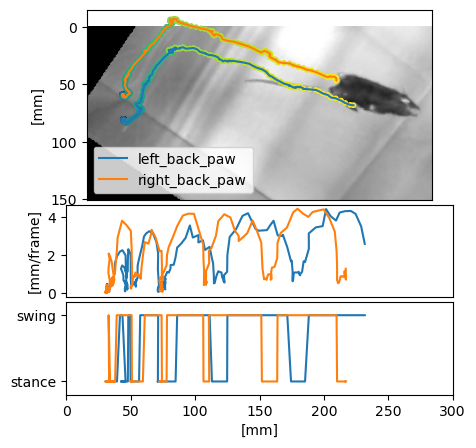

100%|██████████| 65965/65965 [00:00<00:00, 250298.55it/s]


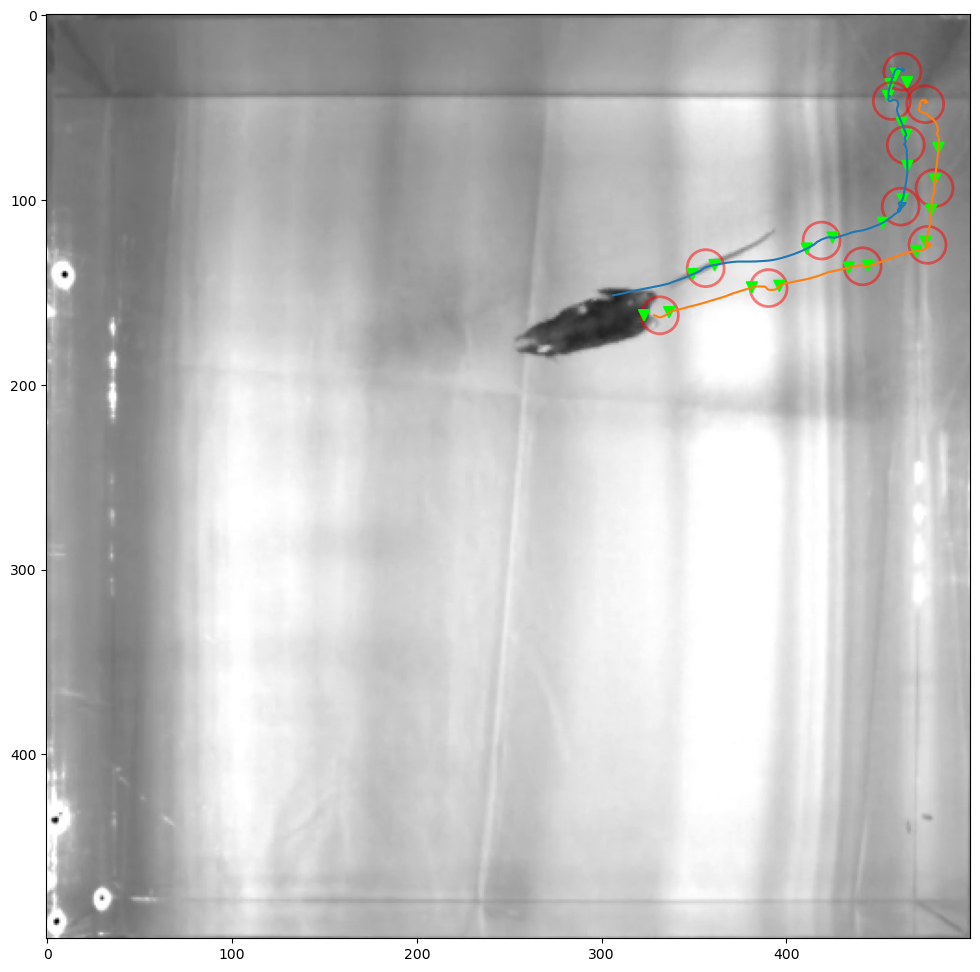

Video 12/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2153/2153 [00:08<00:00, 266.65it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m03_recording3, steps: 467 -- left_back_paw, stride-length: 5.24 +/- 2.81, duration: 12.87 +/- 7.88


100%|██████████| 2137/2137 [00:08<00:00, 264.58it/s]


m03_recording3, steps: 447 -- right_back_paw, stride-length: 5.23 +/- 2.76, duration: 12.21 +/- 7.49


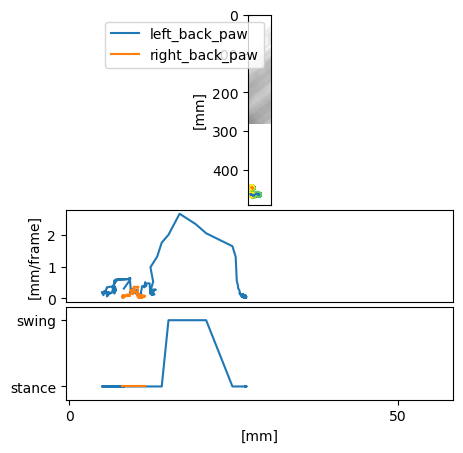

100%|██████████| 64949/64949 [00:00<00:00, 263588.53it/s]


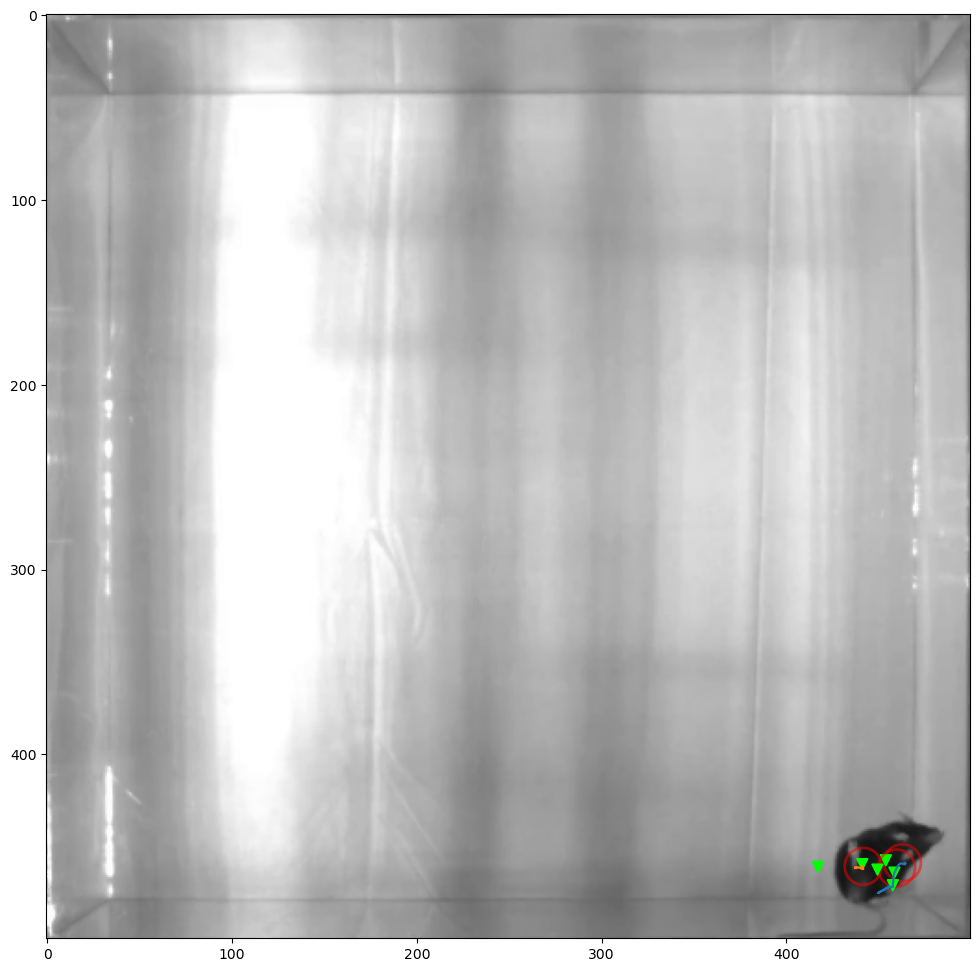

Video 13/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2639/2639 [00:09<00:00, 280.22it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m04_baseline, steps: 582 -- left_back_paw, stride-length: 4.48 +/- 2.54, duration: 12.20 +/- 7.82


100%|██████████| 2639/2639 [00:09<00:00, 278.23it/s]


m04_baseline, steps: 561 -- right_back_paw, stride-length: 4.29 +/- 2.58, duration: 11.62 +/- 7.81


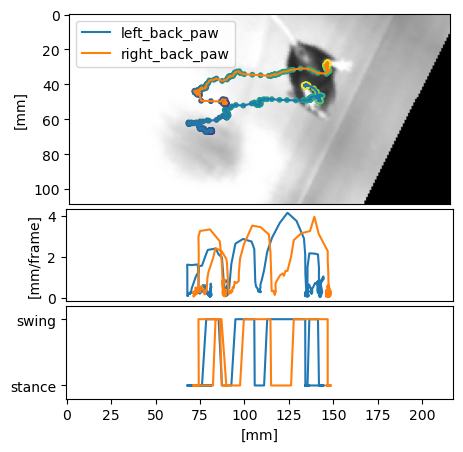

100%|██████████| 64108/64108 [00:00<00:00, 259075.94it/s]


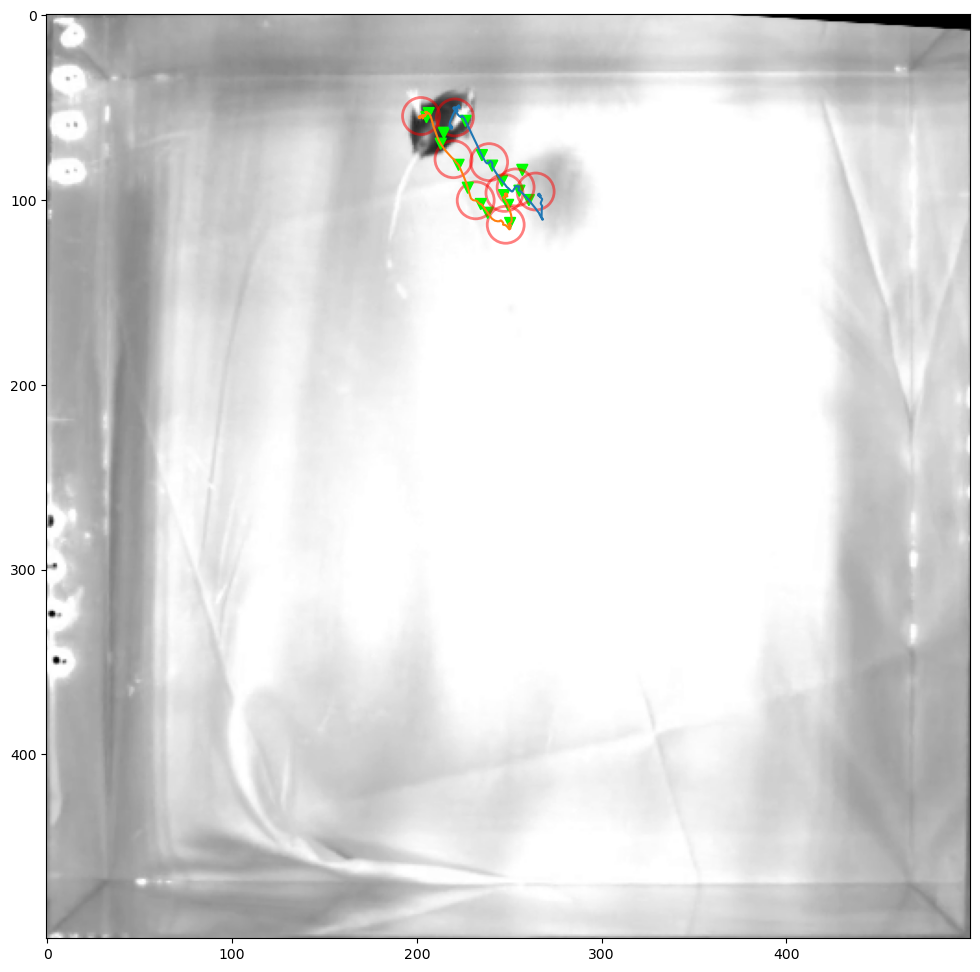

Video 14/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1647/1647 [00:05<00:00, 275.36it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m04_recording1, steps: 347 -- left_back_paw, stride-length: 4.85 +/- 2.69, duration: 13.13 +/- 7.98


100%|██████████| 1669/1669 [00:06<00:00, 273.73it/s]


m04_recording1, steps: 324 -- right_back_paw, stride-length: 4.86 +/- 2.99, duration: 12.73 +/- 8.23


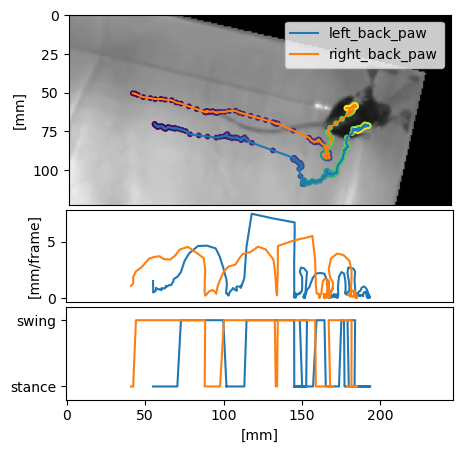

100%|██████████| 65384/65384 [00:00<00:00, 259085.43it/s]


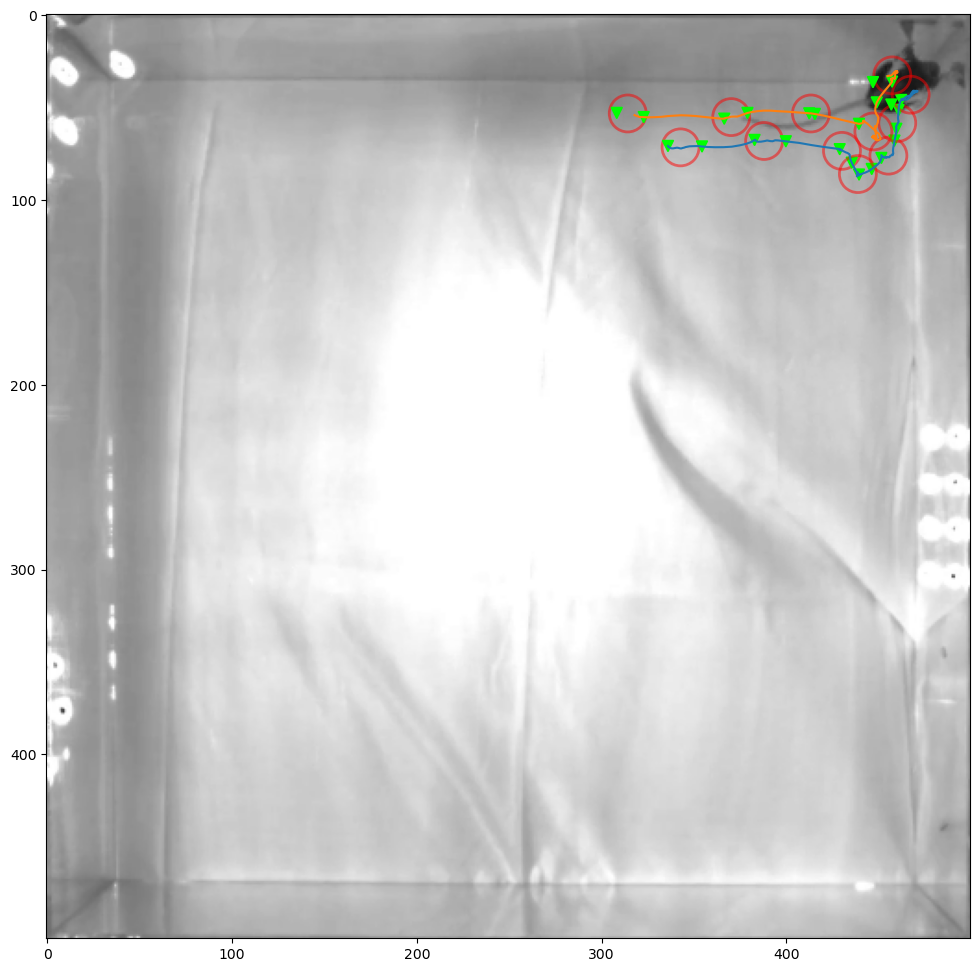

Video 15/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2151/2151 [00:07<00:00, 277.25it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m04_recording2, steps: 397 -- left_back_paw, stride-length: 4.88 +/- 2.79, duration: 13.39 +/- 8.00


100%|██████████| 2089/2089 [00:07<00:00, 278.72it/s]


m04_recording2, steps: 387 -- right_back_paw, stride-length: 5.14 +/- 2.90, duration: 13.83 +/- 8.36


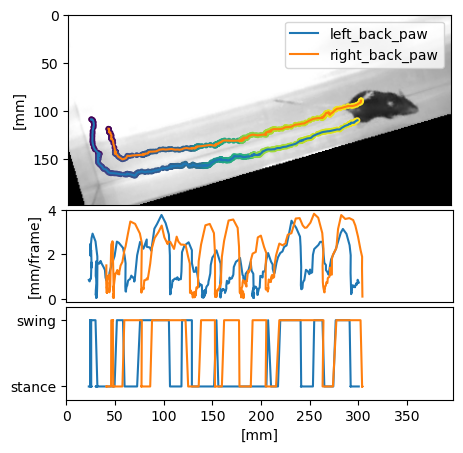

100%|██████████| 64565/64565 [00:00<00:00, 258318.39it/s]


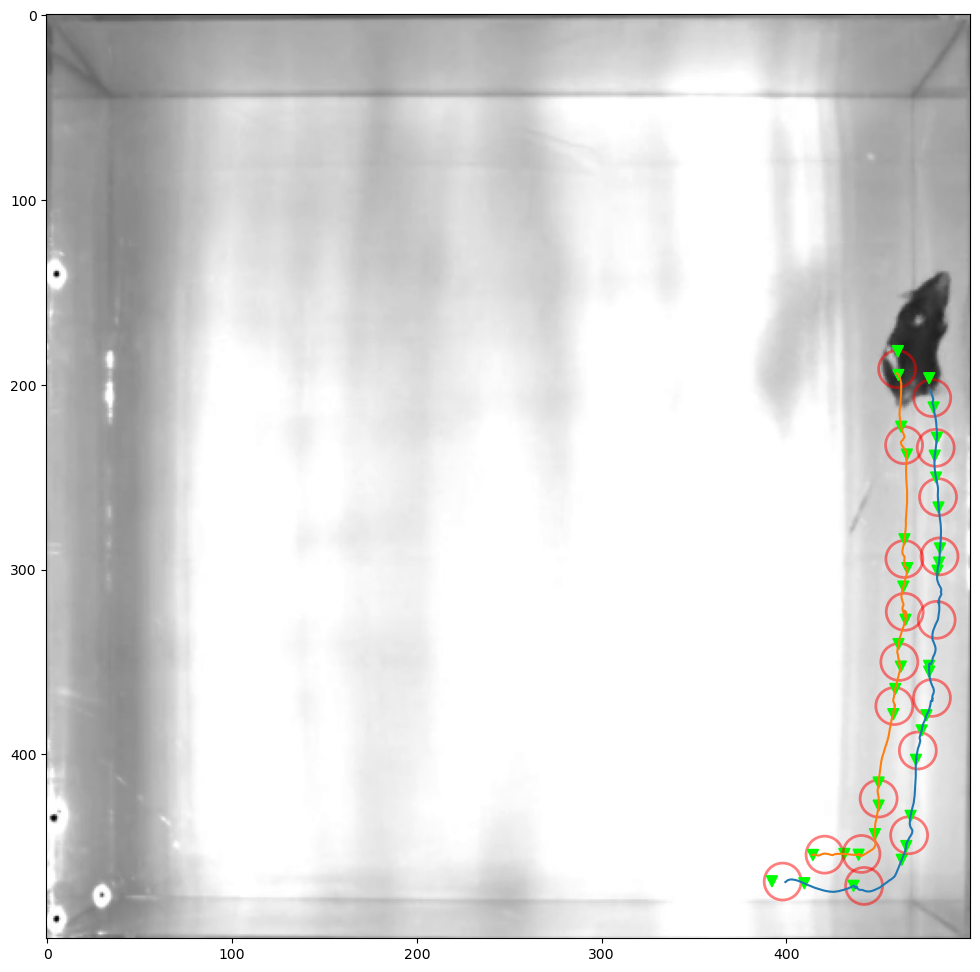

Video 16/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1551/1551 [00:05<00:00, 273.25it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m04_recording3, steps: 318 -- left_back_paw, stride-length: 5.02 +/- 2.72, duration: 13.17 +/- 8.17


100%|██████████| 1583/1583 [00:05<00:00, 269.65it/s]


m04_recording3, steps: 302 -- right_back_paw, stride-length: 5.54 +/- 3.08, duration: 13.44 +/- 8.41


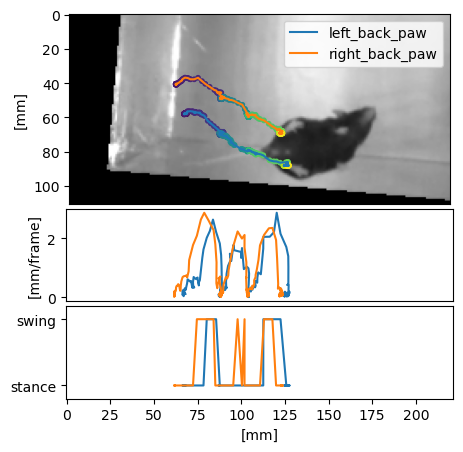

100%|██████████| 66000/66000 [00:00<00:00, 262508.93it/s]


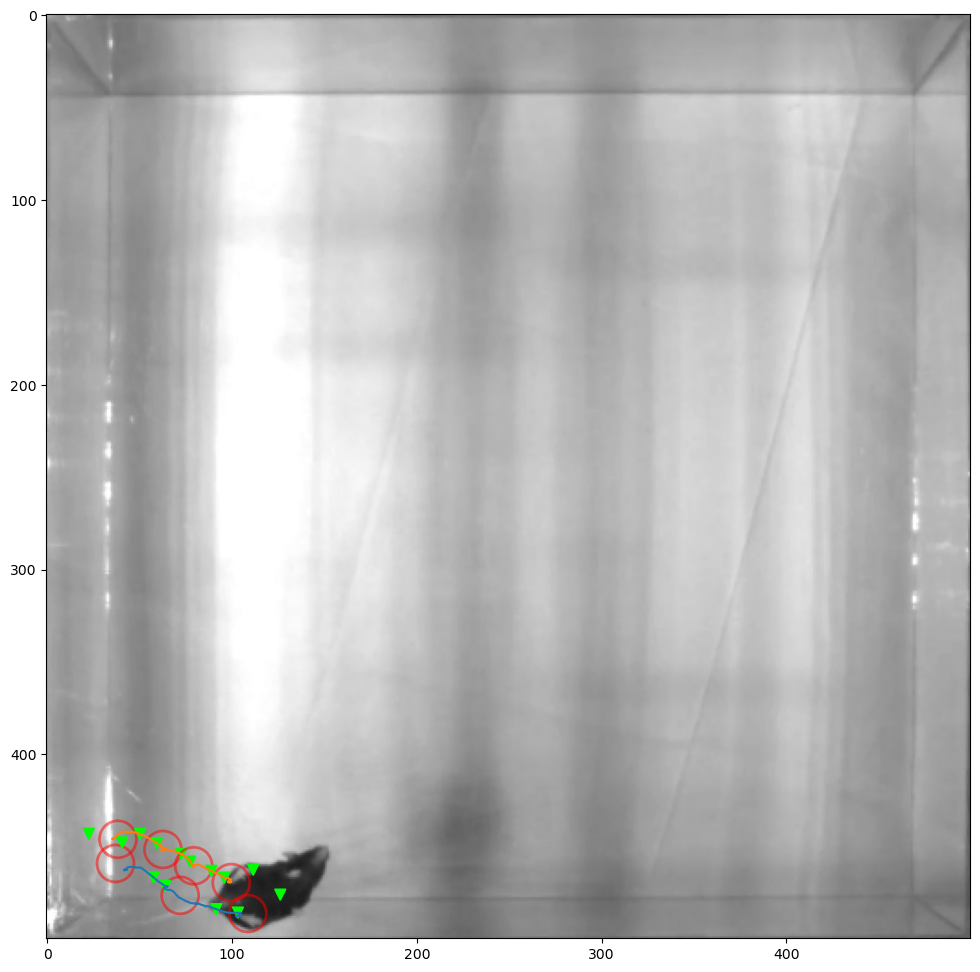

Video 17/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 4181/4181 [00:15<00:00, 273.55it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m05_baseline, steps: 919 -- left_back_paw, stride-length: 3.43 +/- 2.14, duration: 10.32 +/- 7.22


100%|██████████| 3973/3973 [00:14<00:00, 276.44it/s]


m05_baseline, steps: 881 -- right_back_paw, stride-length: 3.55 +/- 2.32, duration: 10.97 +/- 7.36


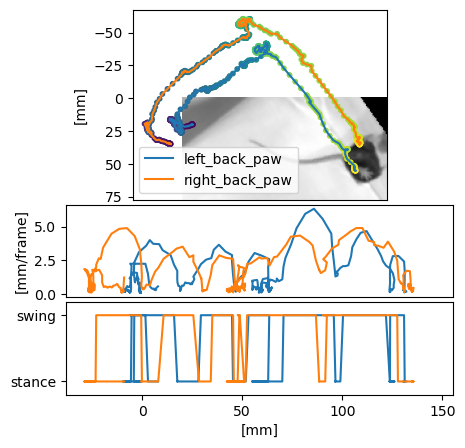

100%|██████████| 64436/64436 [00:00<00:00, 242072.85it/s]


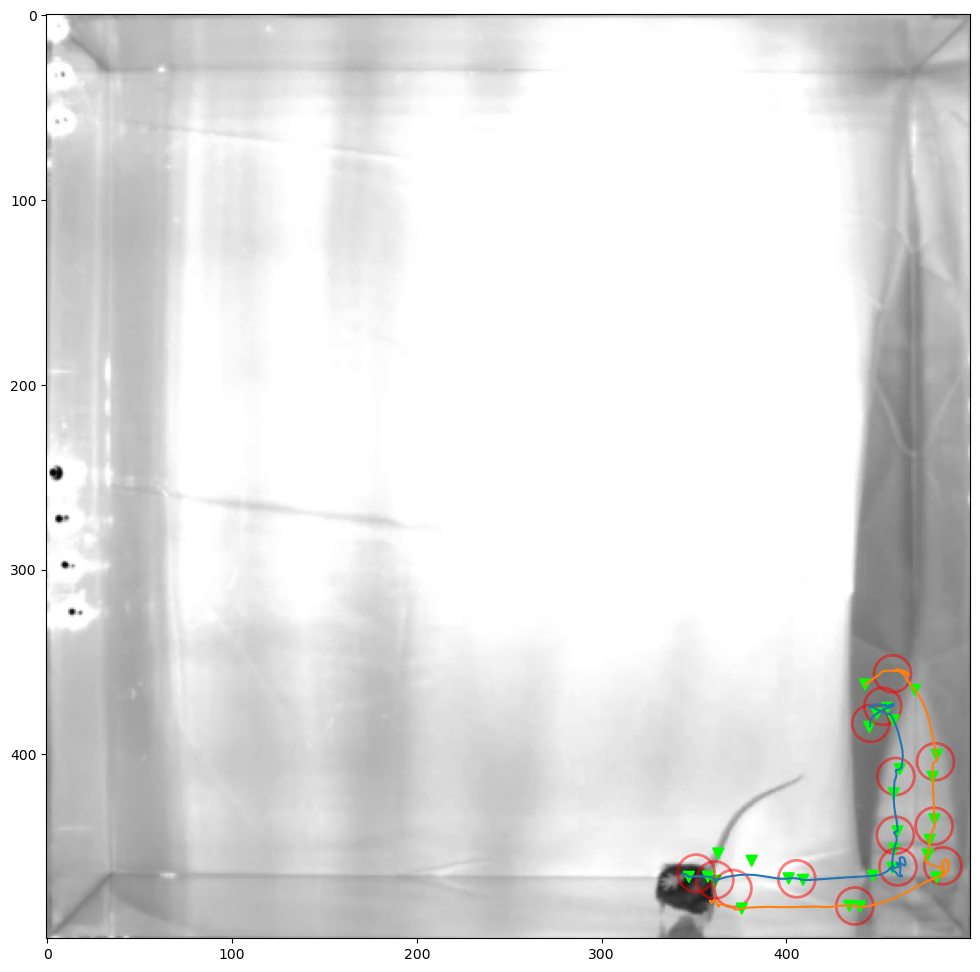

Video 18/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2355/2355 [00:09<00:00, 255.64it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m05_recording1, steps: 435 -- left_back_paw, stride-length: 4.89 +/- 3.10, duration: 11.70 +/- 7.74


100%|██████████| 2459/2459 [00:09<00:00, 256.27it/s]


m05_recording1, steps: 475 -- right_back_paw, stride-length: 4.67 +/- 2.81, duration: 10.65 +/- 7.51


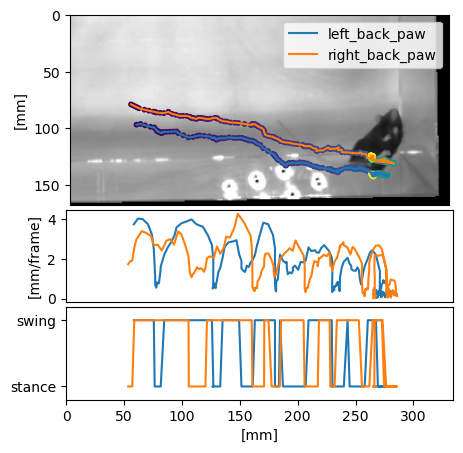

100%|██████████| 65536/65536 [00:00<00:00, 263071.02it/s]


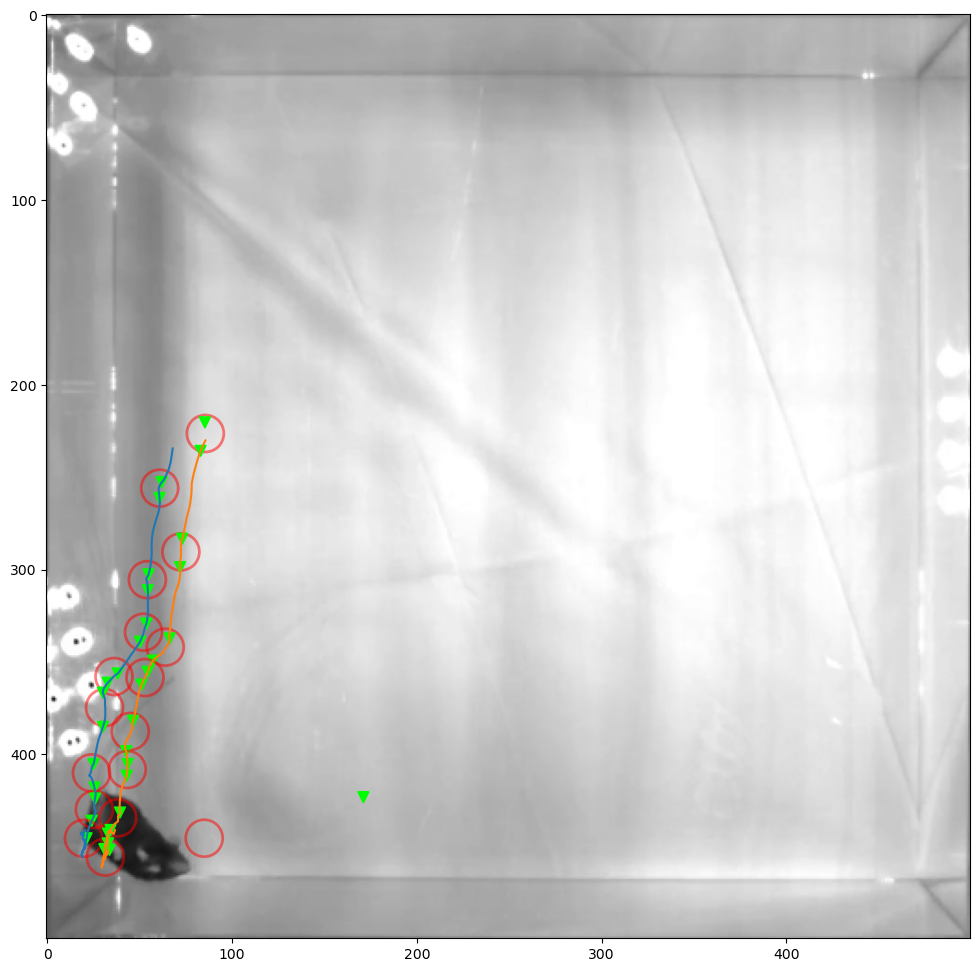

Video 19/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 4175/4175 [00:15<00:00, 265.17it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m05_recording2, steps: 915 -- left_back_paw, stride-length: 3.71 +/- 2.25, duration: 10.58 +/- 7.66


100%|██████████| 4311/4311 [00:16<00:00, 266.57it/s]


m05_recording2, steps: 950 -- right_back_paw, stride-length: 3.62 +/- 2.31, duration: 11.51 +/- 7.98


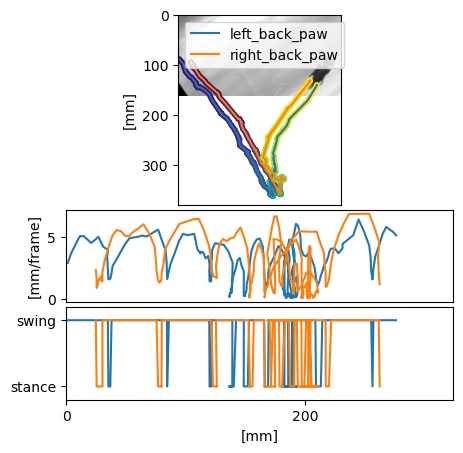

100%|██████████| 66000/66000 [00:00<00:00, 249872.33it/s]


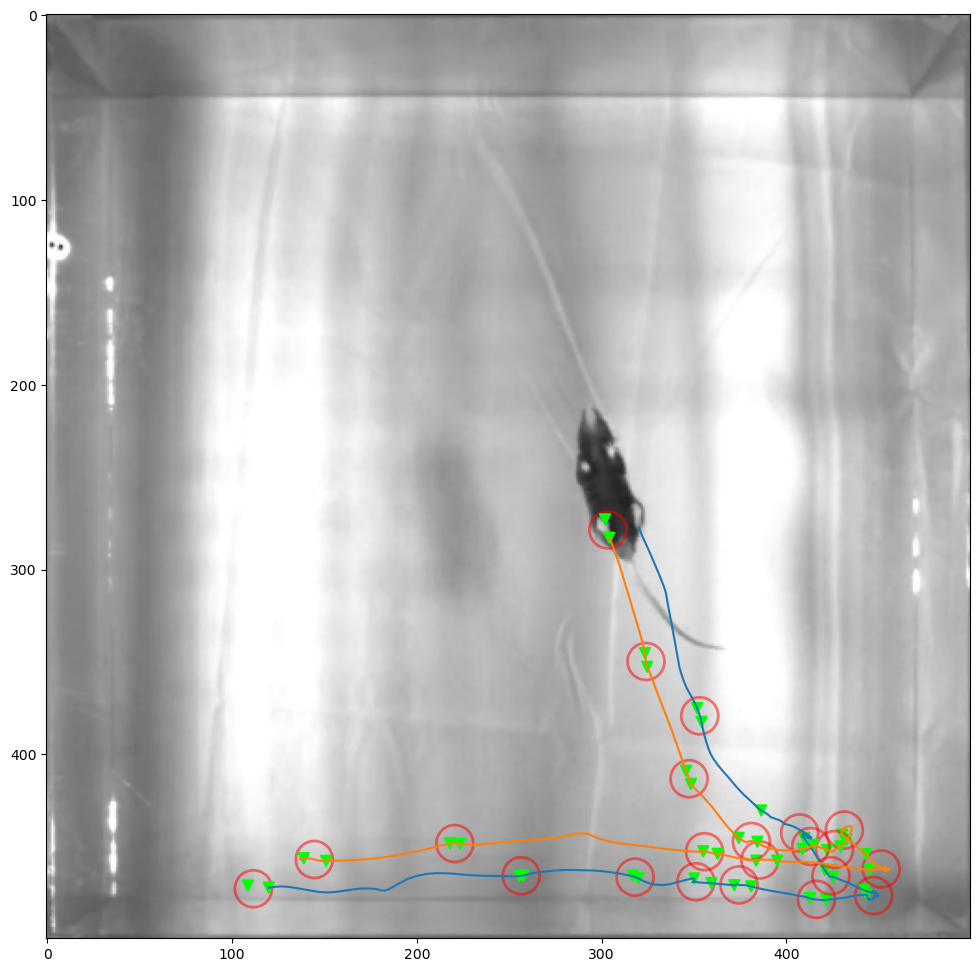

Video 20/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3949/3949 [00:14<00:00, 267.35it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m05_recording3, steps: 825 -- left_back_paw, stride-length: 3.88 +/- 2.30, duration: 10.52 +/- 7.29


100%|██████████| 3759/3759 [00:14<00:00, 266.19it/s]


m05_recording3, steps: 750 -- right_back_paw, stride-length: 4.16 +/- 2.40, duration: 11.70 +/- 7.59


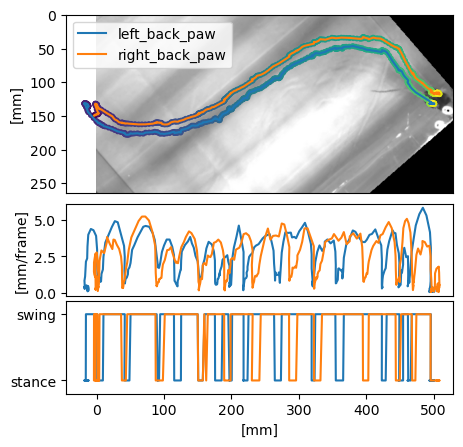

100%|██████████| 66000/66000 [00:00<00:00, 248482.63it/s]


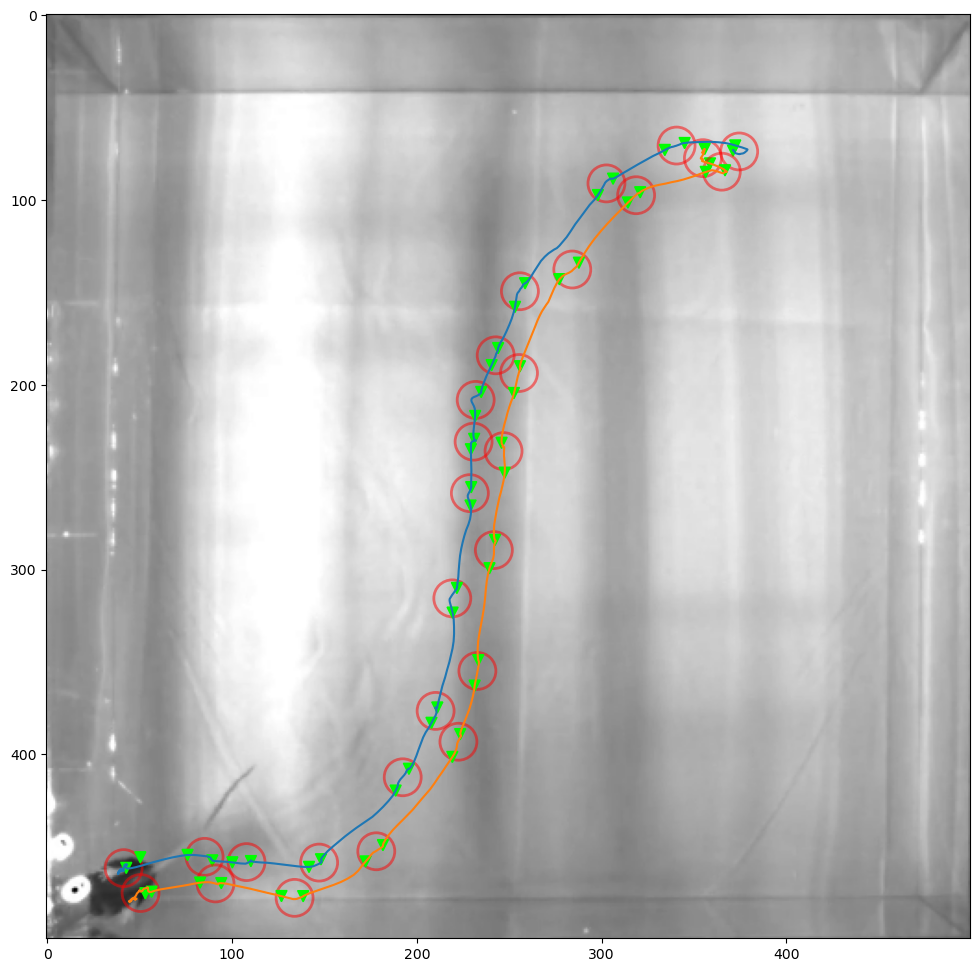

Video 21/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 4399/4399 [00:15<00:00, 277.63it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m06_baseline, steps: 1052 -- left_back_paw, stride-length: 3.58 +/- 2.16, duration: 9.61 +/- 6.85


100%|██████████| 4175/4175 [00:14<00:00, 280.53it/s]


m06_baseline, steps: 1010 -- right_back_paw, stride-length: 3.40 +/- 2.15, duration: 10.02 +/- 7.03


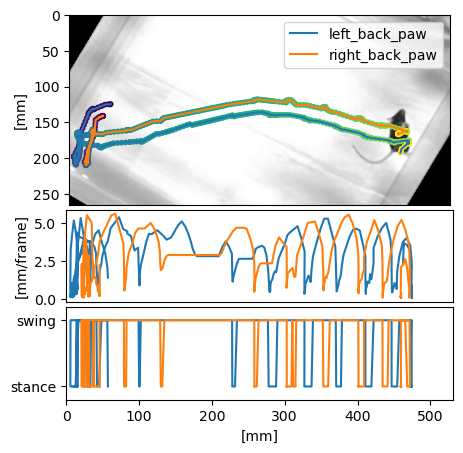

100%|██████████| 63671/63671 [00:00<00:00, 245461.09it/s]


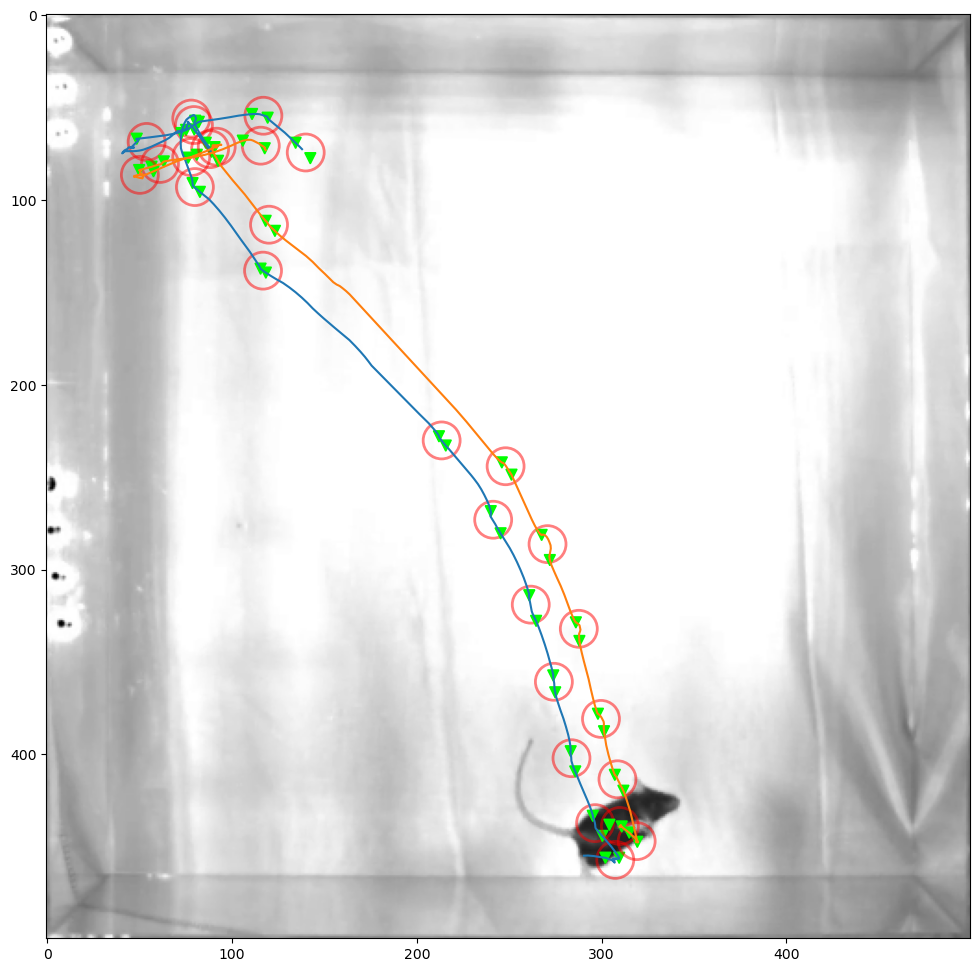

Video 22/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3005/3005 [00:11<00:00, 268.78it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m06_recording1, steps: 644 -- left_back_paw, stride-length: 4.27 +/- 2.37, duration: 11.05 +/- 7.51


100%|██████████| 2785/2785 [00:10<00:00, 275.44it/s]


m06_recording1, steps: 644 -- right_back_paw, stride-length: 4.08 +/- 2.34, duration: 11.20 +/- 7.17


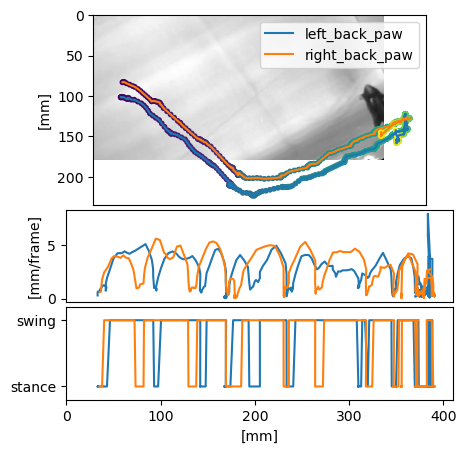

100%|██████████| 65431/65431 [00:00<00:00, 255939.96it/s]


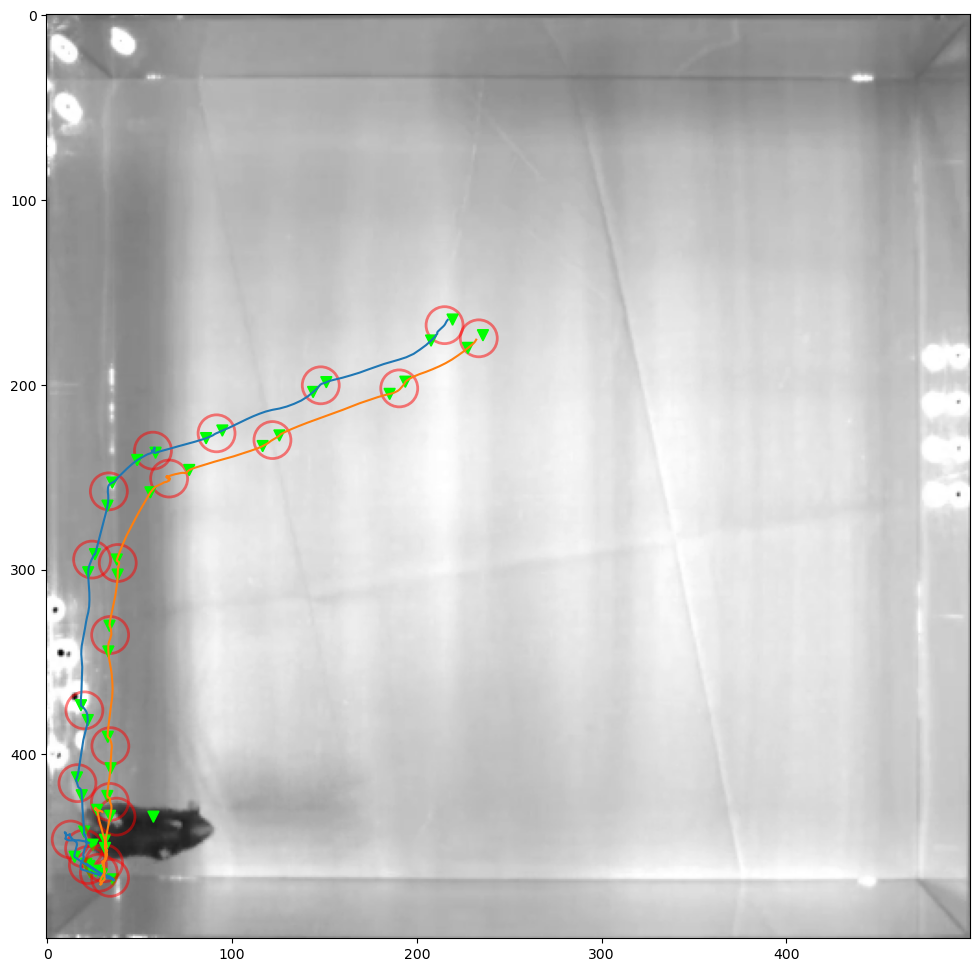

Video 23/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2587/2587 [00:09<00:00, 263.37it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m06_recording2, steps: 544 -- left_back_paw, stride-length: 4.37 +/- 2.52, duration: 10.85 +/- 7.08


100%|██████████| 2465/2465 [00:09<00:00, 266.57it/s]


m06_recording2, steps: 537 -- right_back_paw, stride-length: 4.22 +/- 2.55, duration: 10.87 +/- 7.18


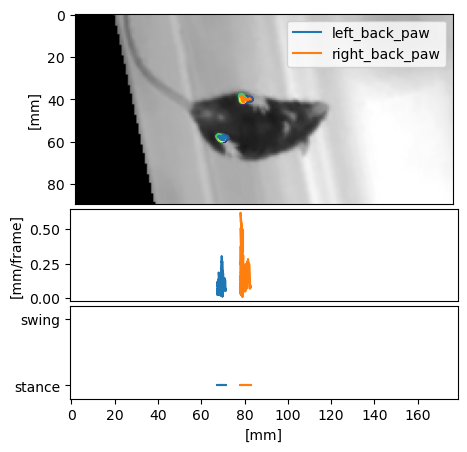

100%|██████████| 66000/66000 [00:00<00:00, 258319.60it/s]


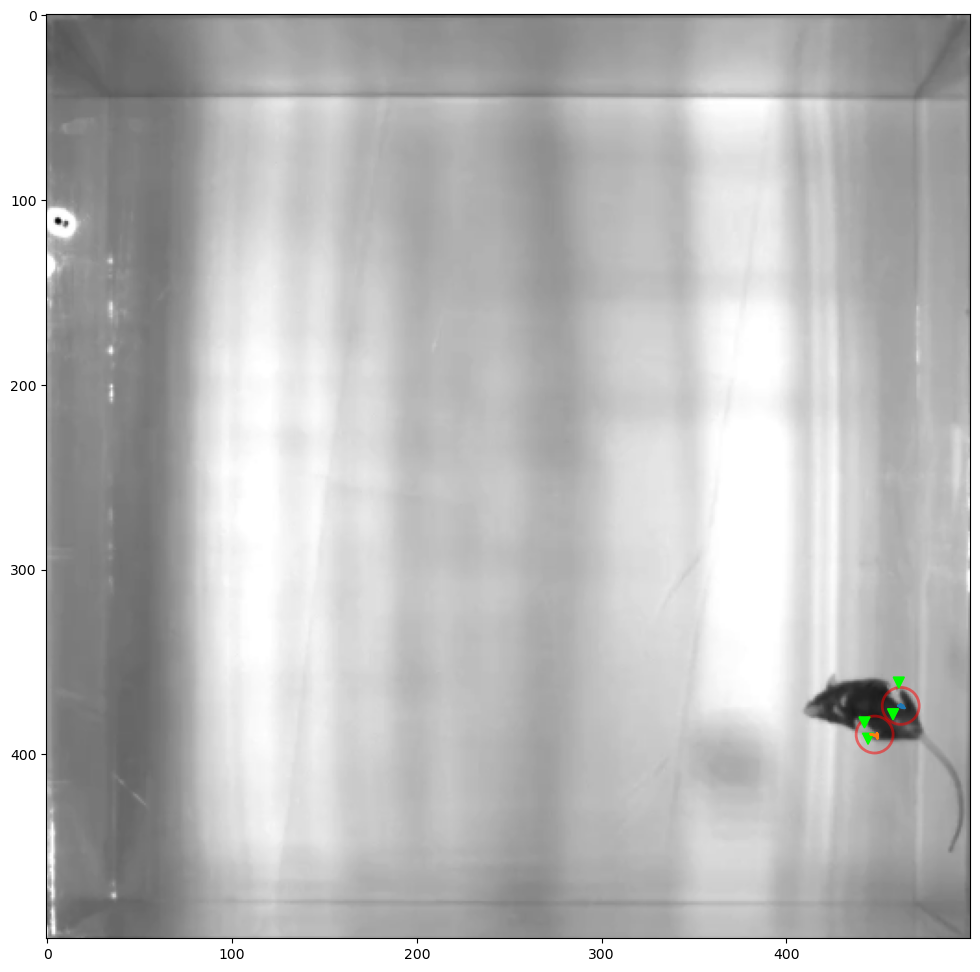

Video 24/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3459/3459 [00:13<00:00, 264.91it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m06_recording3, steps: 762 -- left_back_paw, stride-length: 4.44 +/- 2.46, duration: 12.07 +/- 7.66


100%|██████████| 3217/3217 [00:12<00:00, 265.46it/s]


m06_recording3, steps: 669 -- right_back_paw, stride-length: 4.62 +/- 2.57, duration: 12.51 +/- 7.60


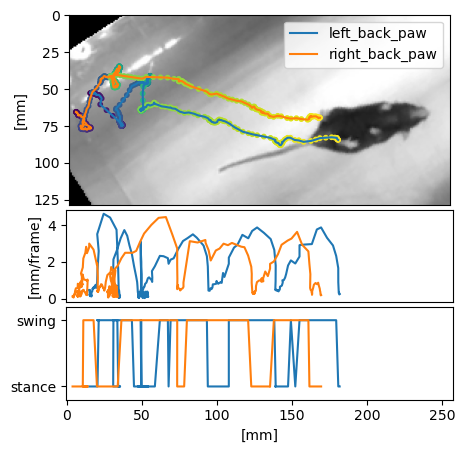

100%|██████████| 66000/66000 [00:00<00:00, 255073.68it/s]


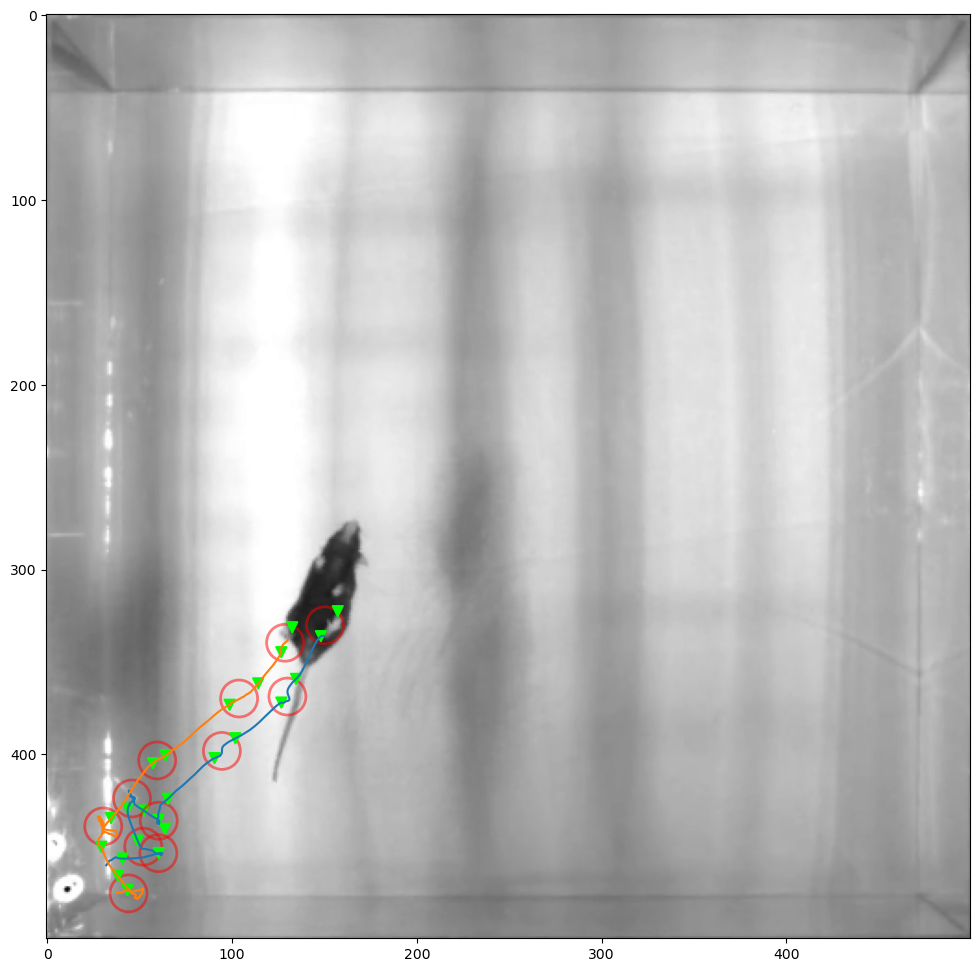

Video 25/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3869/3869 [00:14<00:00, 274.24it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m07_baseline, steps: 872 -- left_back_paw, stride-length: 3.88 +/- 2.40, duration: 11.67 +/- 7.73


100%|██████████| 3689/3689 [00:13<00:00, 270.53it/s]


m07_baseline, steps: 747 -- right_back_paw, stride-length: 4.07 +/- 2.54, duration: 10.99 +/- 7.80


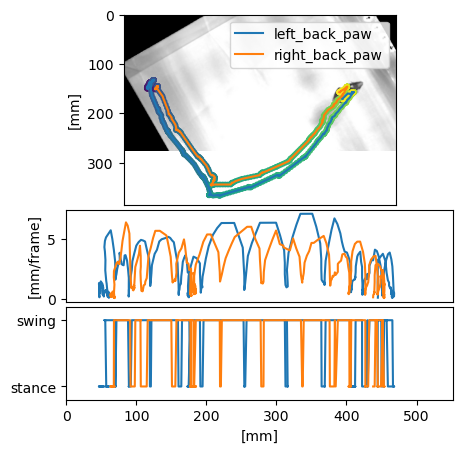

100%|██████████| 64526/64526 [00:00<00:00, 249473.12it/s]


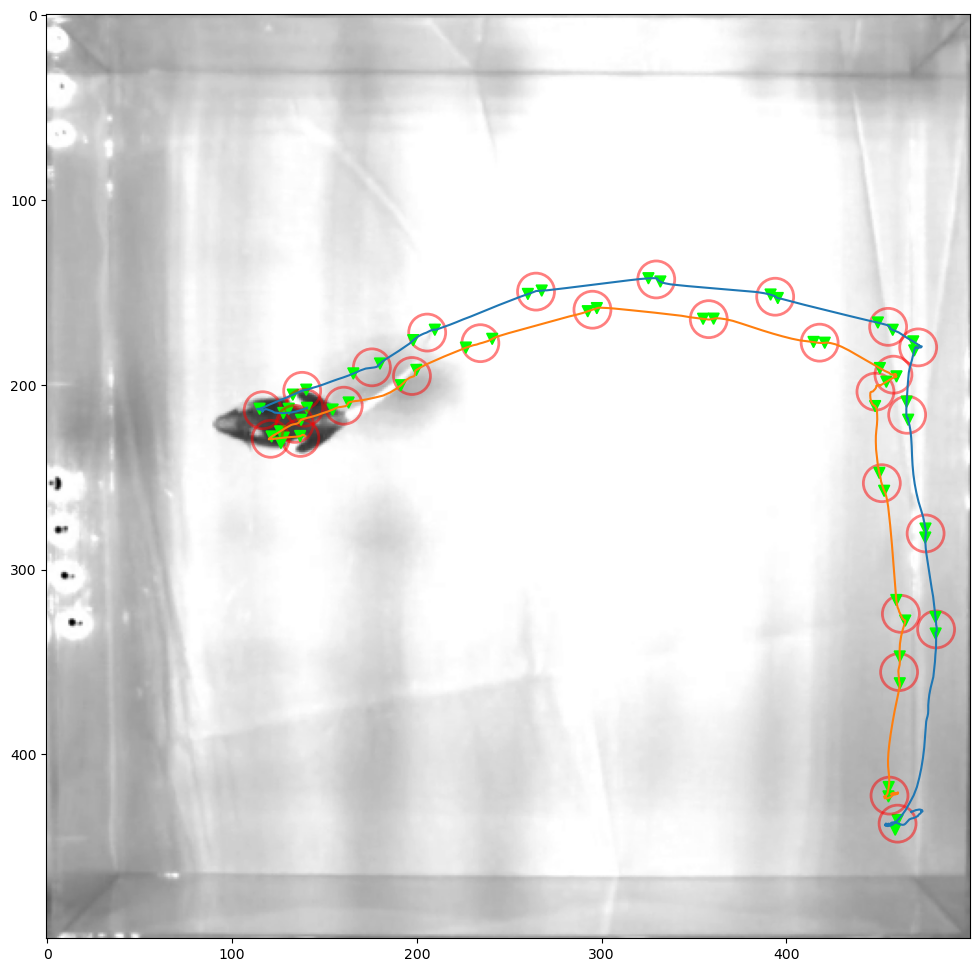

Video 26/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3355/3355 [00:12<00:00, 277.13it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m07_recording1, steps: 786 -- left_back_paw, stride-length: 3.94 +/- 2.38, duration: 12.71 +/- 7.88


100%|██████████| 3311/3311 [00:12<00:00, 270.09it/s]


m07_recording1, steps: 702 -- right_back_paw, stride-length: 4.22 +/- 2.56, duration: 11.30 +/- 7.76


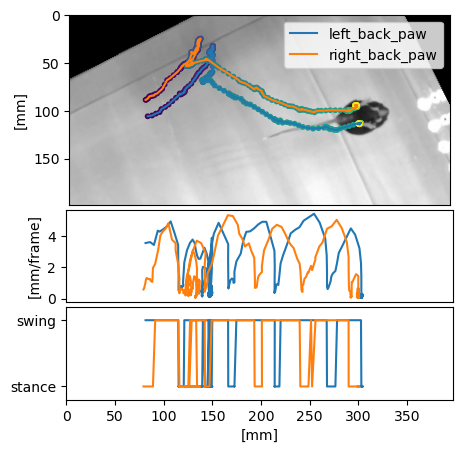

100%|██████████| 65717/65717 [00:00<00:00, 254091.86it/s]


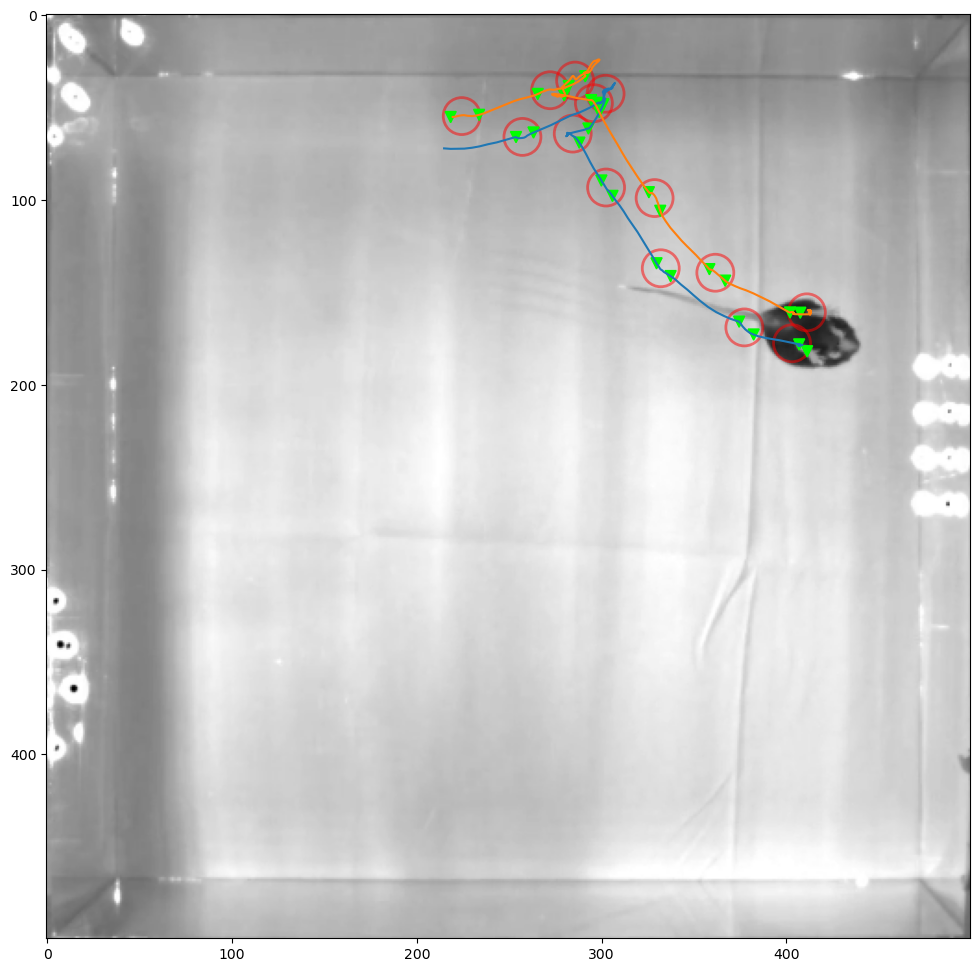

Video 27/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3361/3361 [00:12<00:00, 271.31it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m07_recording2, steps: 752 -- left_back_paw, stride-length: 4.27 +/- 2.40, duration: 12.78 +/- 8.07


100%|██████████| 3023/3023 [00:11<00:00, 266.65it/s]


m07_recording2, steps: 629 -- right_back_paw, stride-length: 4.58 +/- 2.66, duration: 12.22 +/- 8.12


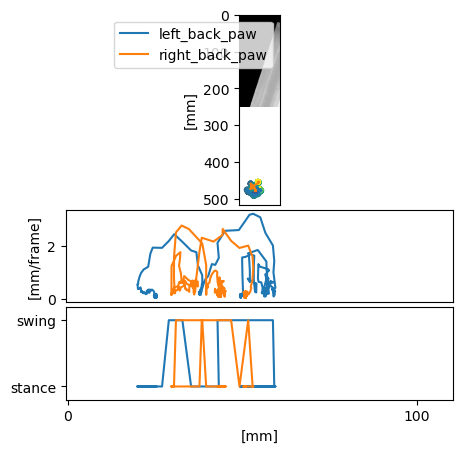

100%|██████████| 66000/66000 [00:00<00:00, 255273.61it/s]


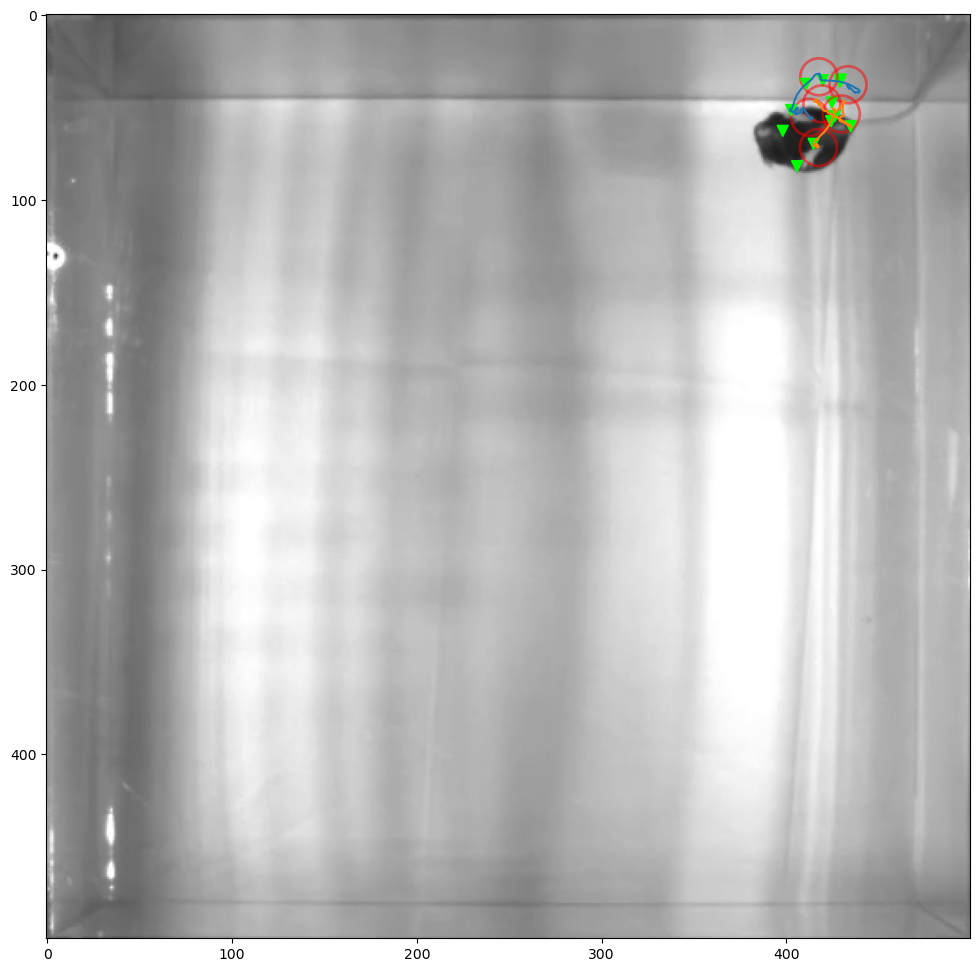

Video 28/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3377/3377 [00:12<00:00, 279.84it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m07_recording3, steps: 732 -- left_back_paw, stride-length: 4.38 +/- 2.46, duration: 13.04 +/- 8.03


100%|██████████| 3435/3435 [00:12<00:00, 277.10it/s]


m07_recording3, steps: 727 -- right_back_paw, stride-length: 4.51 +/- 2.68, duration: 11.58 +/- 8.09


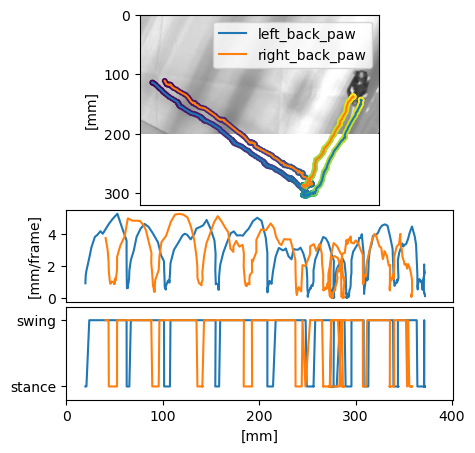

100%|██████████| 63809/63809 [00:00<00:00, 252529.07it/s]


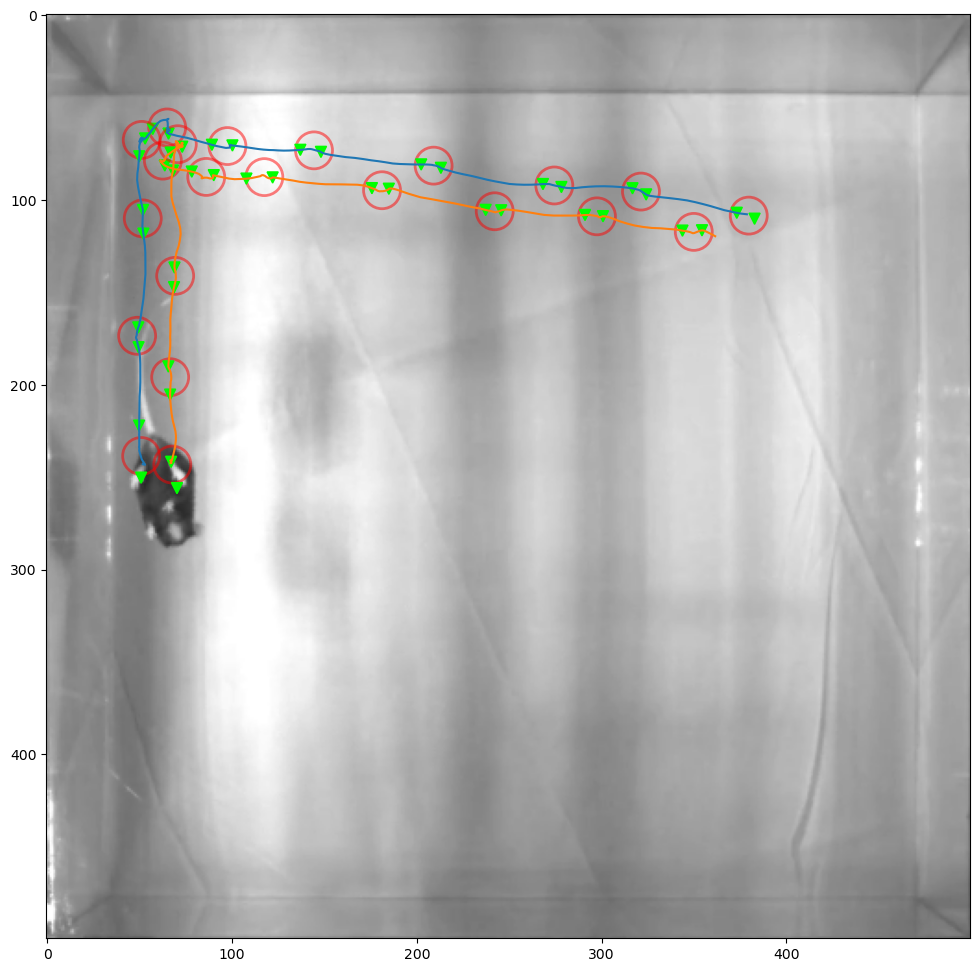

Video 29/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3027/3027 [00:10<00:00, 276.85it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m08_baseline, steps: 623 -- left_back_paw, stride-length: 3.69 +/- 2.36, duration: 10.34 +/- 7.20


100%|██████████| 2981/2981 [00:10<00:00, 276.97it/s]


m08_baseline, steps: 642 -- right_back_paw, stride-length: 3.80 +/- 2.36, duration: 10.80 +/- 7.19


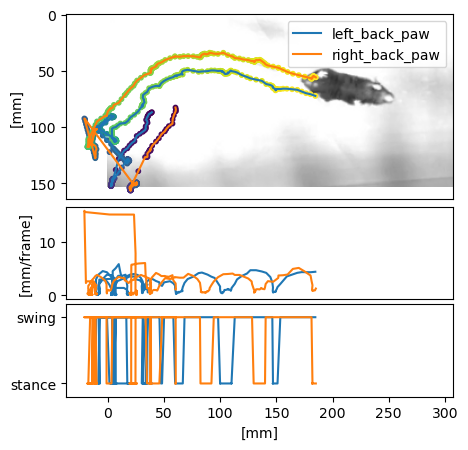

100%|██████████| 63964/63964 [00:00<00:00, 255635.37it/s]


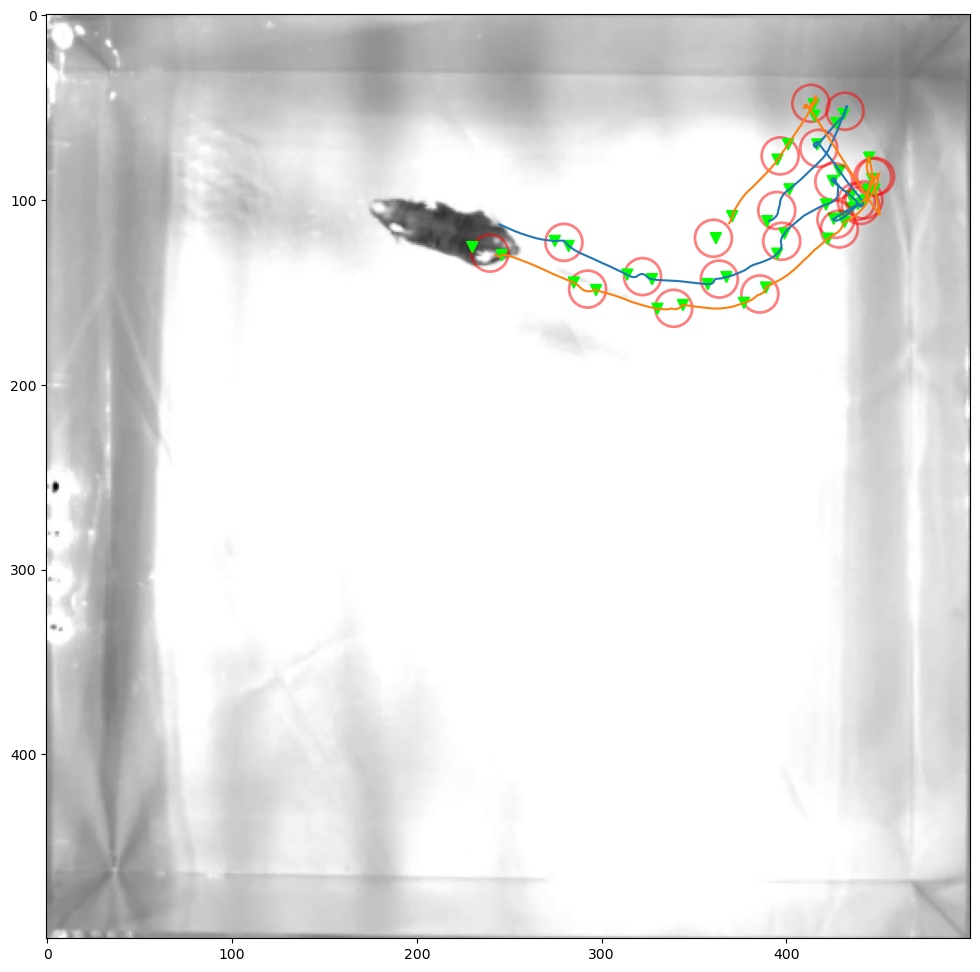

Video 30/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1945/1945 [00:07<00:00, 268.17it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m08_recording1, steps: 357 -- left_back_paw, stride-length: 4.49 +/- 2.72, duration: 11.89 +/- 7.64


100%|██████████| 1907/1907 [00:07<00:00, 265.38it/s]


m08_recording1, steps: 349 -- right_back_paw, stride-length: 4.77 +/- 2.88, duration: 12.68 +/- 8.00


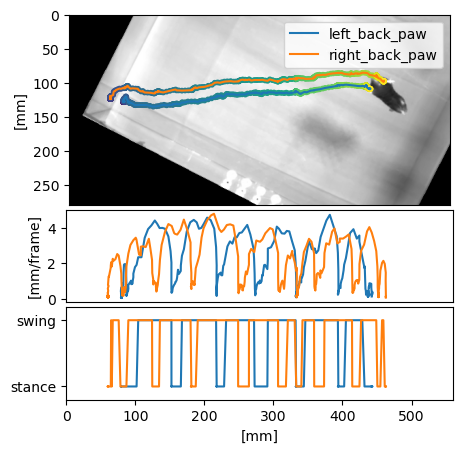

100%|██████████| 65918/65918 [00:00<00:00, 260214.39it/s]


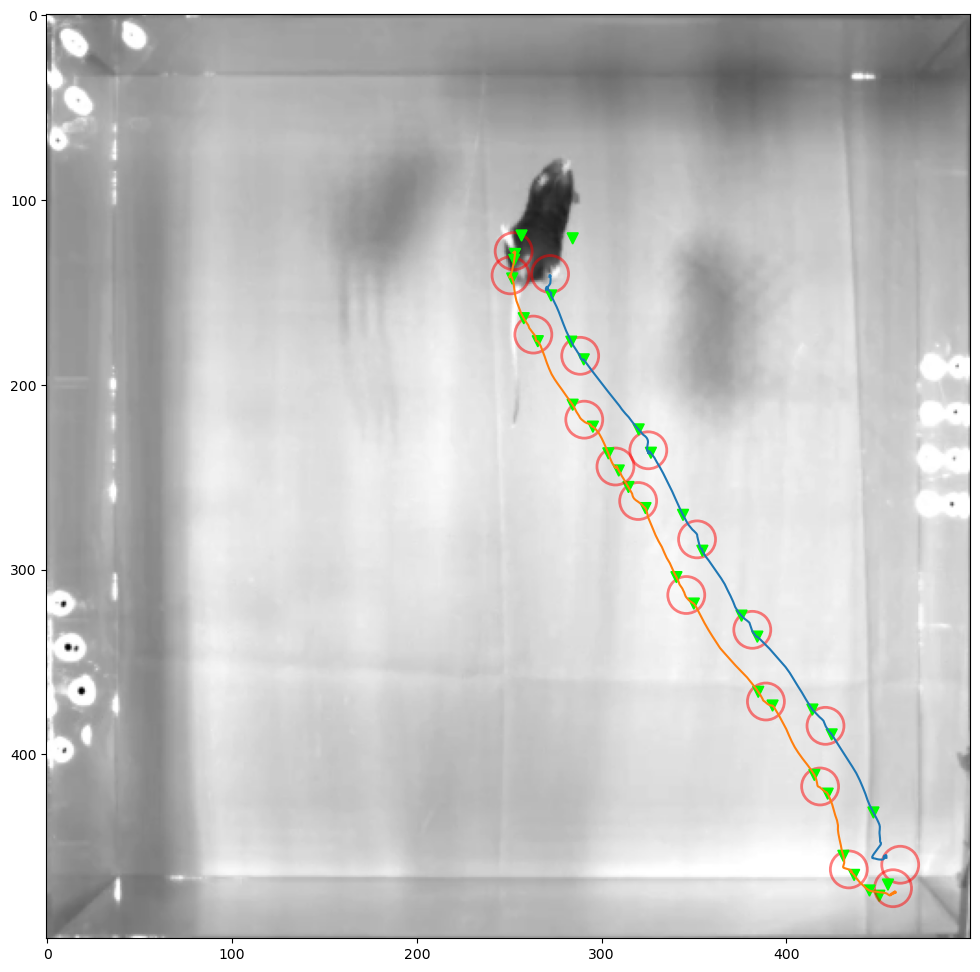

Video 31/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1697/1697 [00:06<00:00, 269.98it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m08_recording2, steps: 307 -- left_back_paw, stride-length: 4.49 +/- 2.70, duration: 12.10 +/- 7.98


100%|██████████| 1779/1779 [00:06<00:00, 265.01it/s]


m08_recording2, steps: 326 -- right_back_paw, stride-length: 4.60 +/- 2.62, duration: 12.74 +/- 8.17


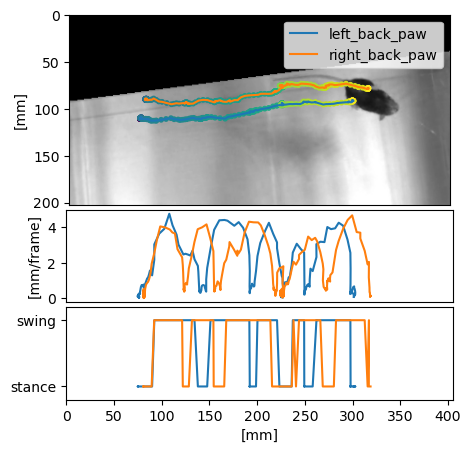

100%|██████████| 66000/66000 [00:00<00:00, 262749.87it/s]


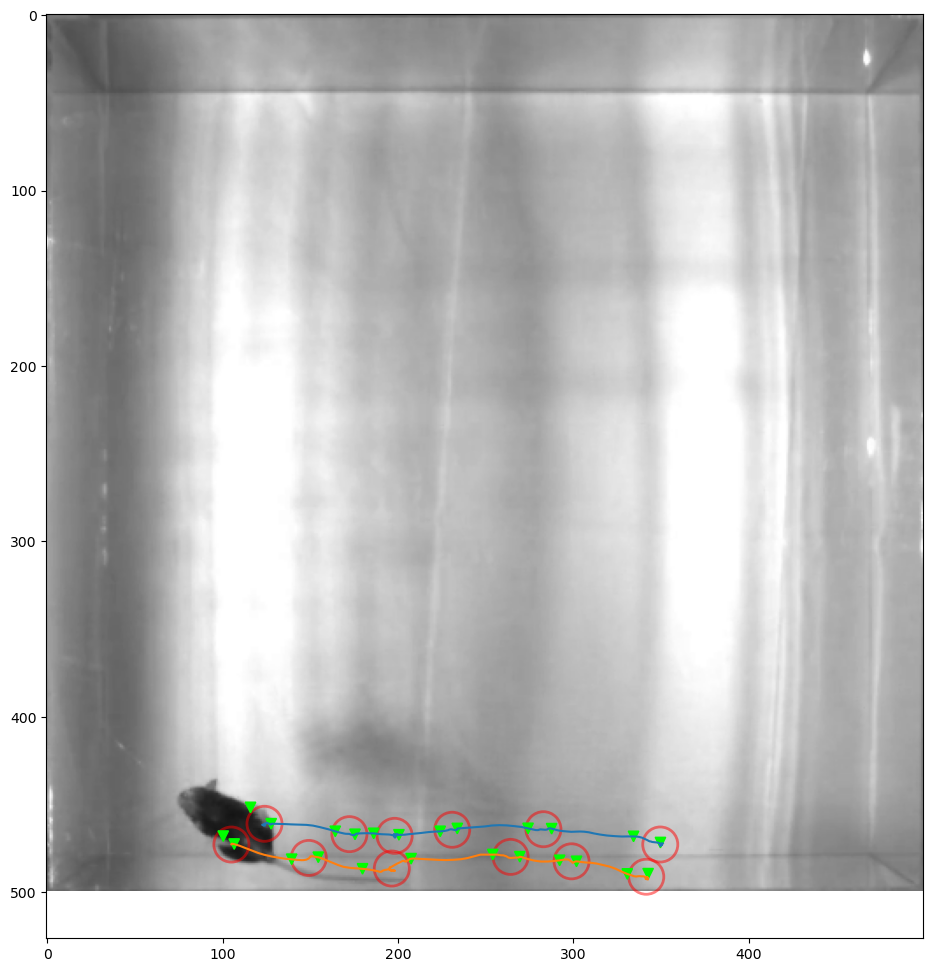

Video 32/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2249/2249 [00:08<00:00, 264.99it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m08_recording3, steps: 432 -- left_back_paw, stride-length: 4.66 +/- 2.65, duration: 11.68 +/- 7.55


100%|██████████| 2131/2131 [00:08<00:00, 265.68it/s]


m08_recording3, steps: 409 -- right_back_paw, stride-length: 4.39 +/- 2.58, duration: 12.51 +/- 7.85


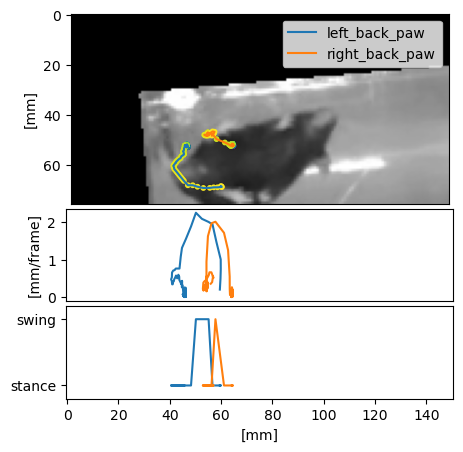

100%|██████████| 65979/65979 [00:00<00:00, 258310.92it/s]


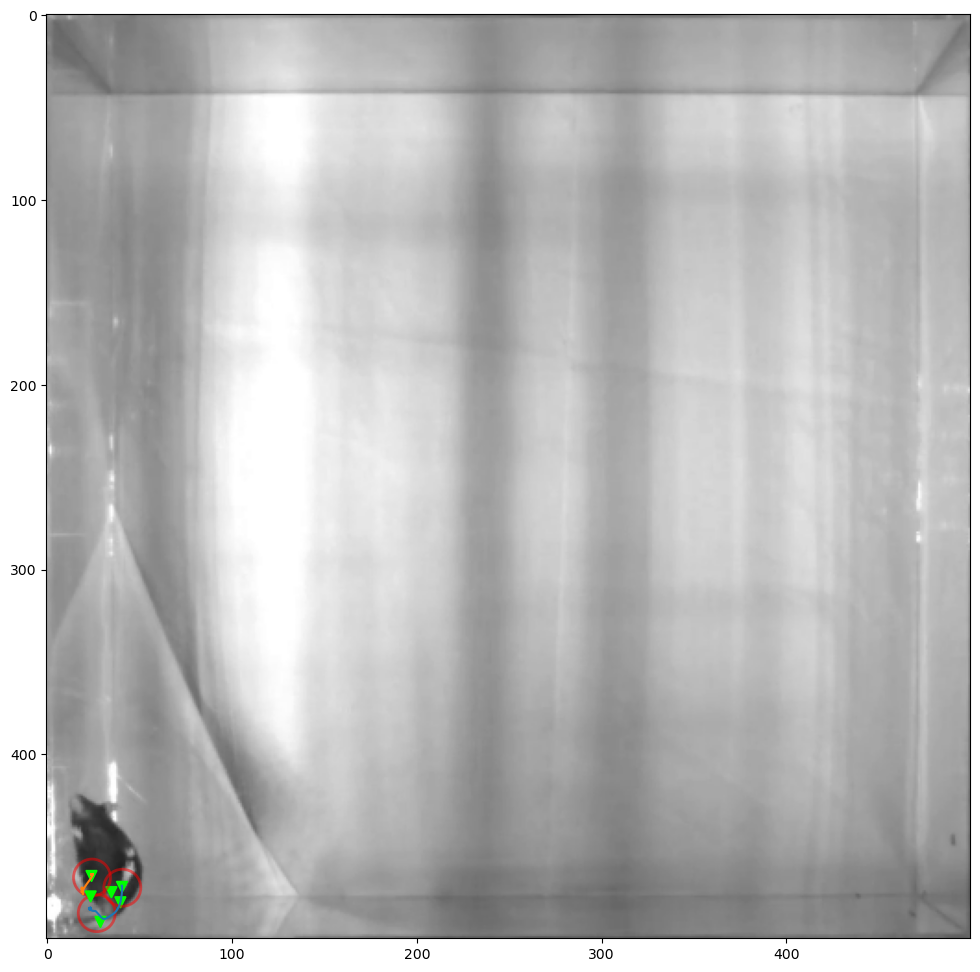

Video 33/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3745/3745 [00:13<00:00, 273.59it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m13_baseline, steps: 853 -- left_back_paw, stride-length: 3.97 +/- 2.37, duration: 10.73 +/- 7.15


100%|██████████| 4033/4033 [00:14<00:00, 271.53it/s]


m13_baseline, steps: 884 -- right_back_paw, stride-length: 4.03 +/- 2.40, duration: 11.28 +/- 7.58


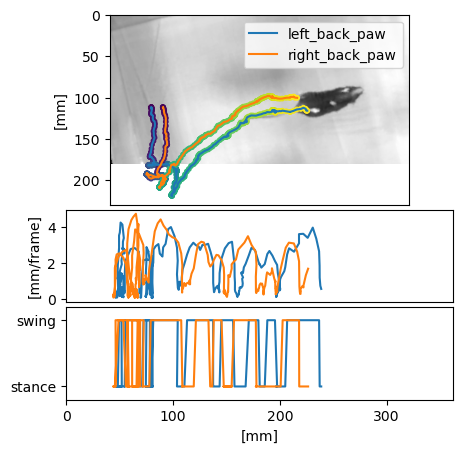

100%|██████████| 64908/64908 [00:00<00:00, 251295.40it/s]


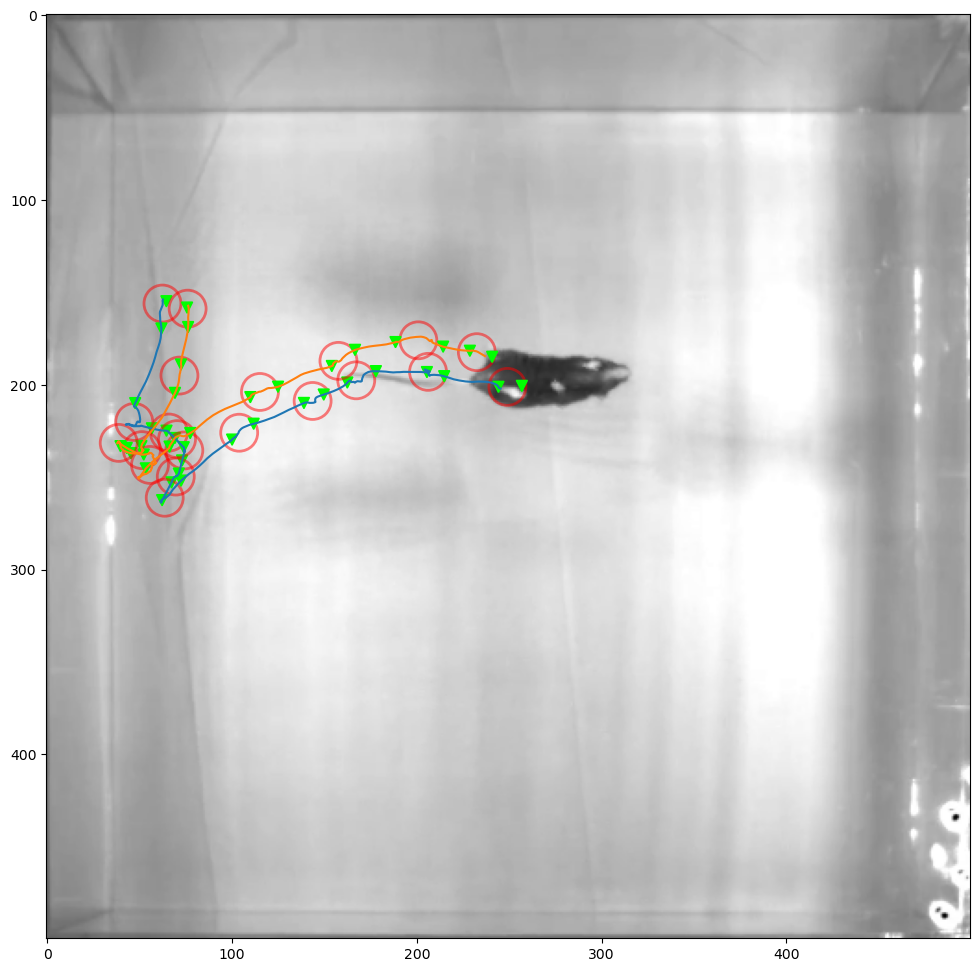

Video 34/64
DID NOT FIND DLC FILE!
Video 35/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2309/2309 [00:08<00:00, 268.15it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m13_recording2, steps: 450 -- left_back_paw, stride-length: 4.68 +/- 2.53, duration: 13.05 +/- 7.60


100%|██████████| 2267/2267 [00:08<00:00, 268.26it/s]


m13_recording2, steps: 409 -- right_back_paw, stride-length: 5.12 +/- 2.95, duration: 13.22 +/- 8.06


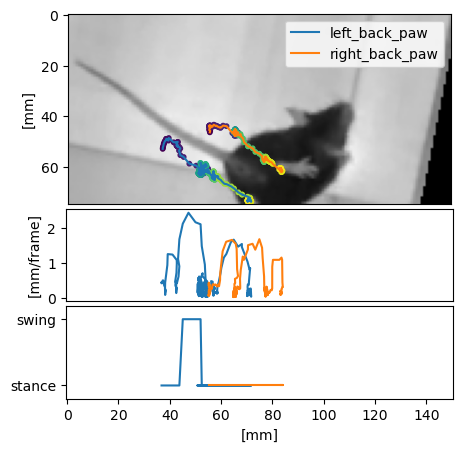

100%|██████████| 66000/66000 [00:00<00:00, 257708.29it/s]


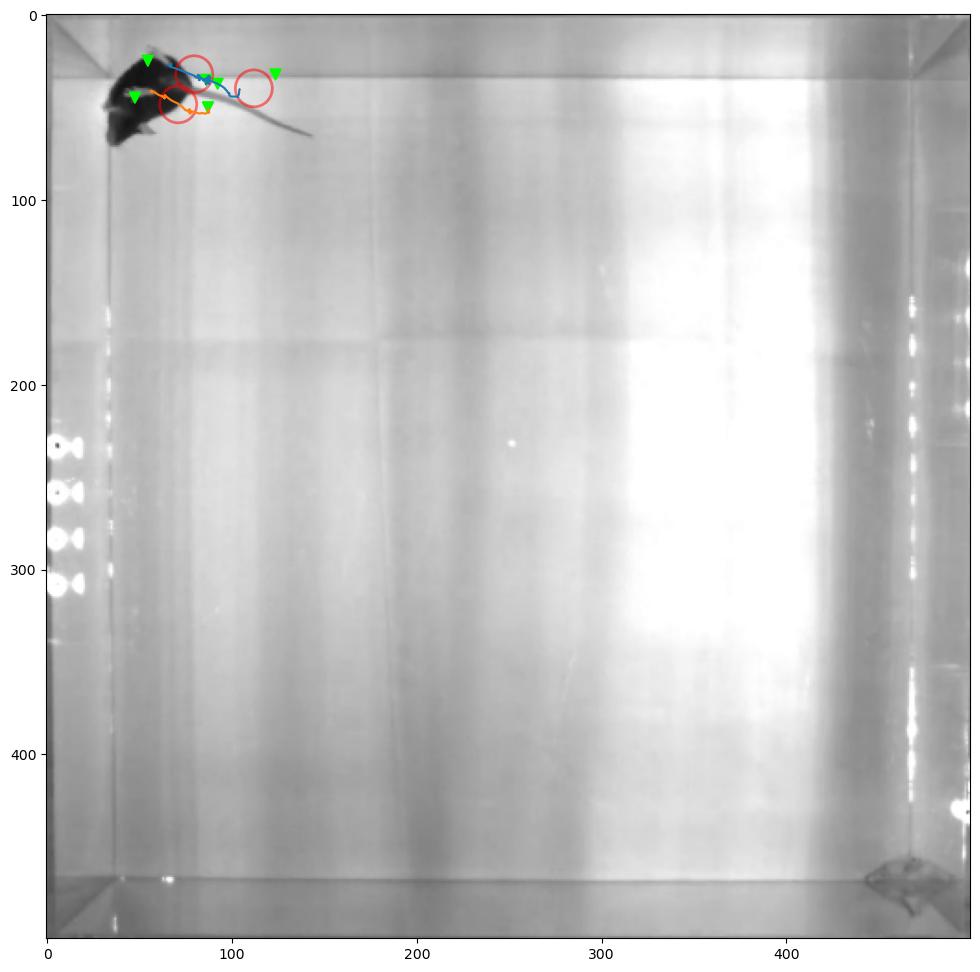

Video 36/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3351/3351 [00:12<00:00, 266.51it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m13_recording3, steps: 682 -- left_back_paw, stride-length: 4.51 +/- 2.56, duration: 12.32 +/- 7.62


100%|██████████| 3341/3341 [00:12<00:00, 269.51it/s]


m13_recording3, steps: 704 -- right_back_paw, stride-length: 4.67 +/- 2.51, duration: 12.91 +/- 7.99


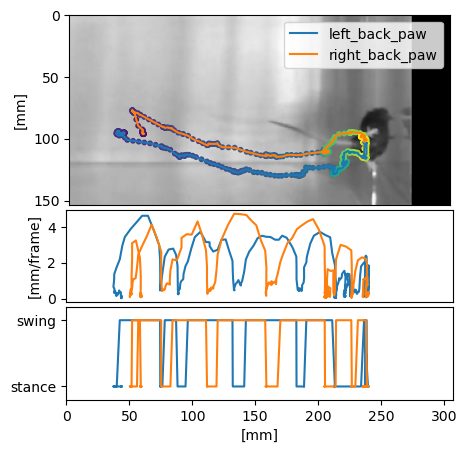

100%|██████████| 66000/66000 [00:00<00:00, 245254.64it/s]


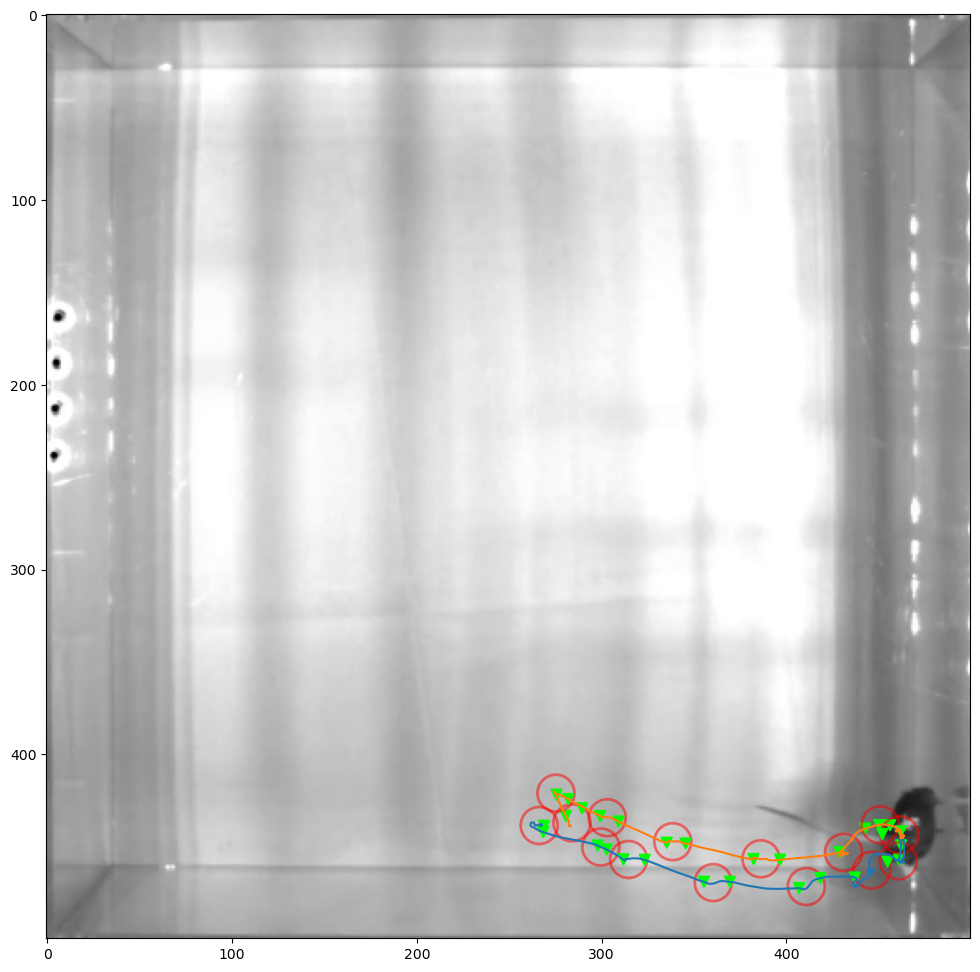

Video 37/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3175/3175 [00:11<00:00, 267.98it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m14_baseline, steps: 659 -- left_back_paw, stride-length: 4.44 +/- 2.50, duration: 11.98 +/- 7.91


100%|██████████| 3331/3331 [00:12<00:00, 269.10it/s]


m14_baseline, steps: 695 -- right_back_paw, stride-length: 4.18 +/- 2.50, duration: 11.65 +/- 7.55


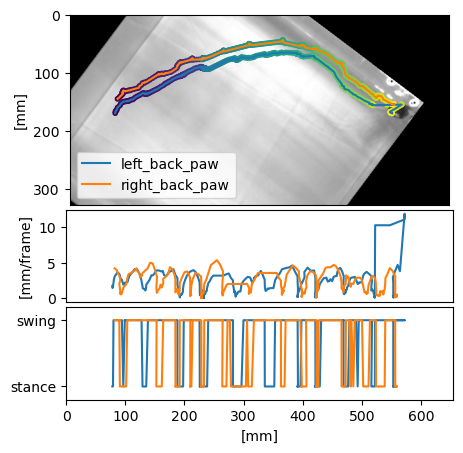

100%|██████████| 65497/65497 [00:00<00:00, 248718.74it/s]


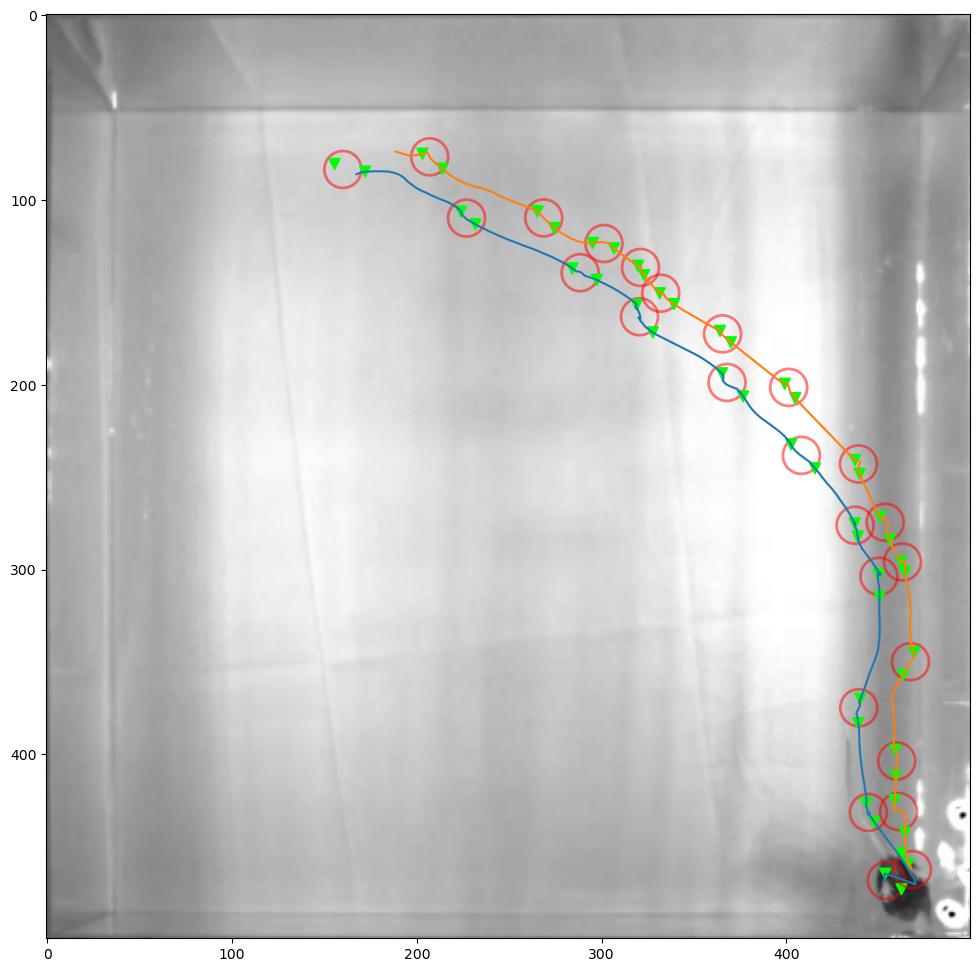

Video 38/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3771/3771 [00:14<00:00, 262.15it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m14_recording1, steps: 754 -- left_back_paw, stride-length: 4.71 +/- 2.59, duration: 12.27 +/- 7.89


100%|██████████| 3693/3693 [00:13<00:00, 263.81it/s]


m14_recording1, steps: 762 -- right_back_paw, stride-length: 4.59 +/- 2.67, duration: 12.72 +/- 7.95


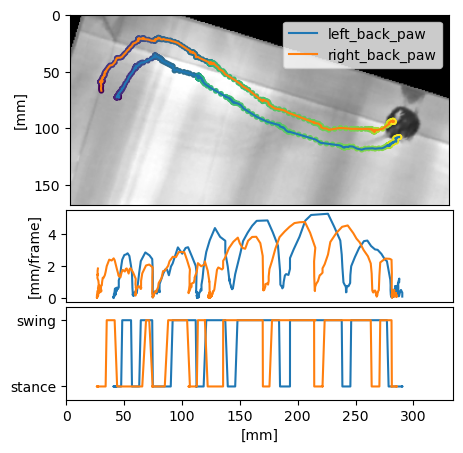

100%|██████████| 65648/65648 [00:00<00:00, 257076.23it/s]


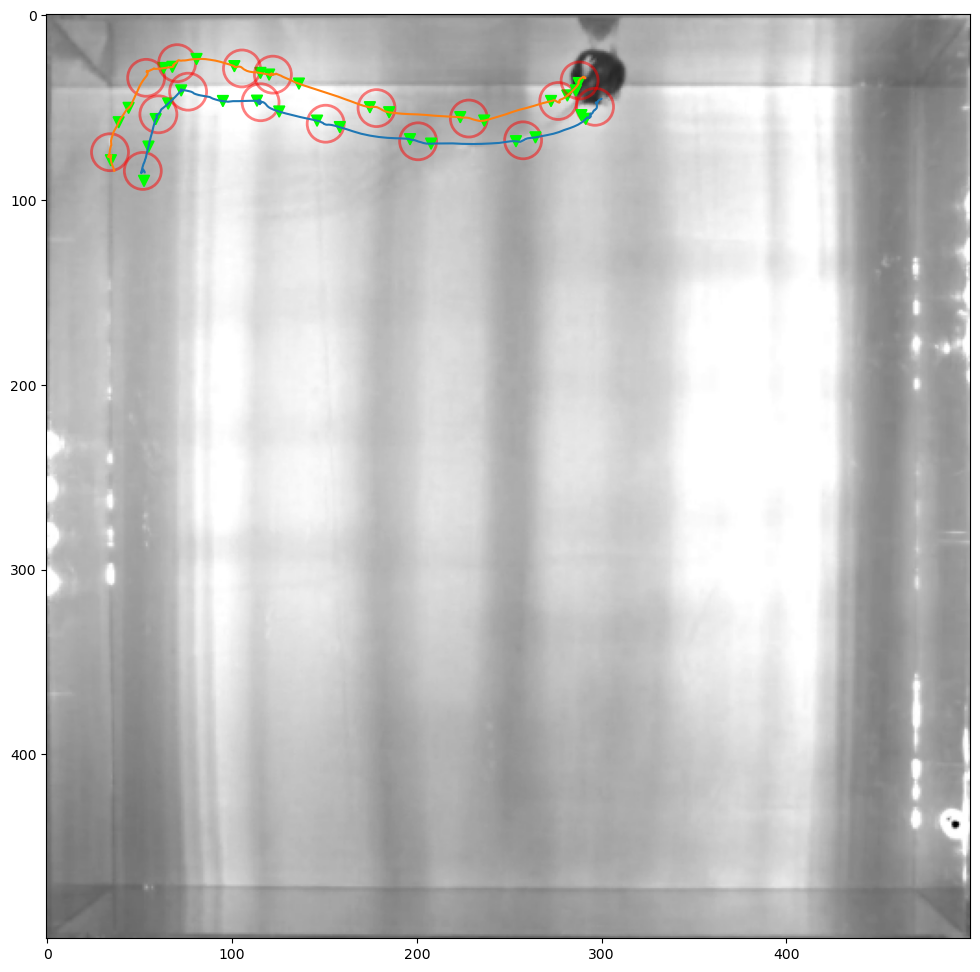

Video 39/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3137/3137 [00:11<00:00, 269.03it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m14_recording2, steps: 628 -- left_back_paw, stride-length: 4.65 +/- 2.65, duration: 11.94 +/- 7.81


100%|██████████| 3345/3345 [00:12<00:00, 269.46it/s]


m14_recording2, steps: 709 -- right_back_paw, stride-length: 4.15 +/- 2.54, duration: 11.67 +/- 7.75


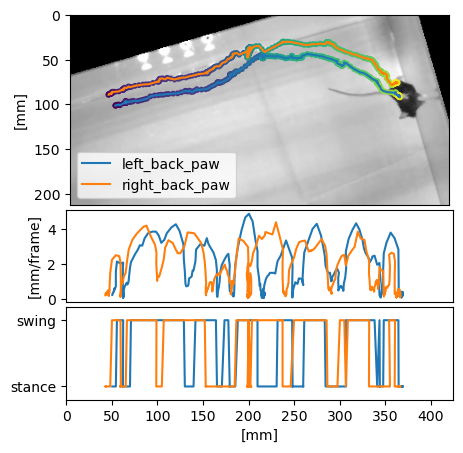

100%|██████████| 66000/66000 [00:00<00:00, 250003.22it/s]


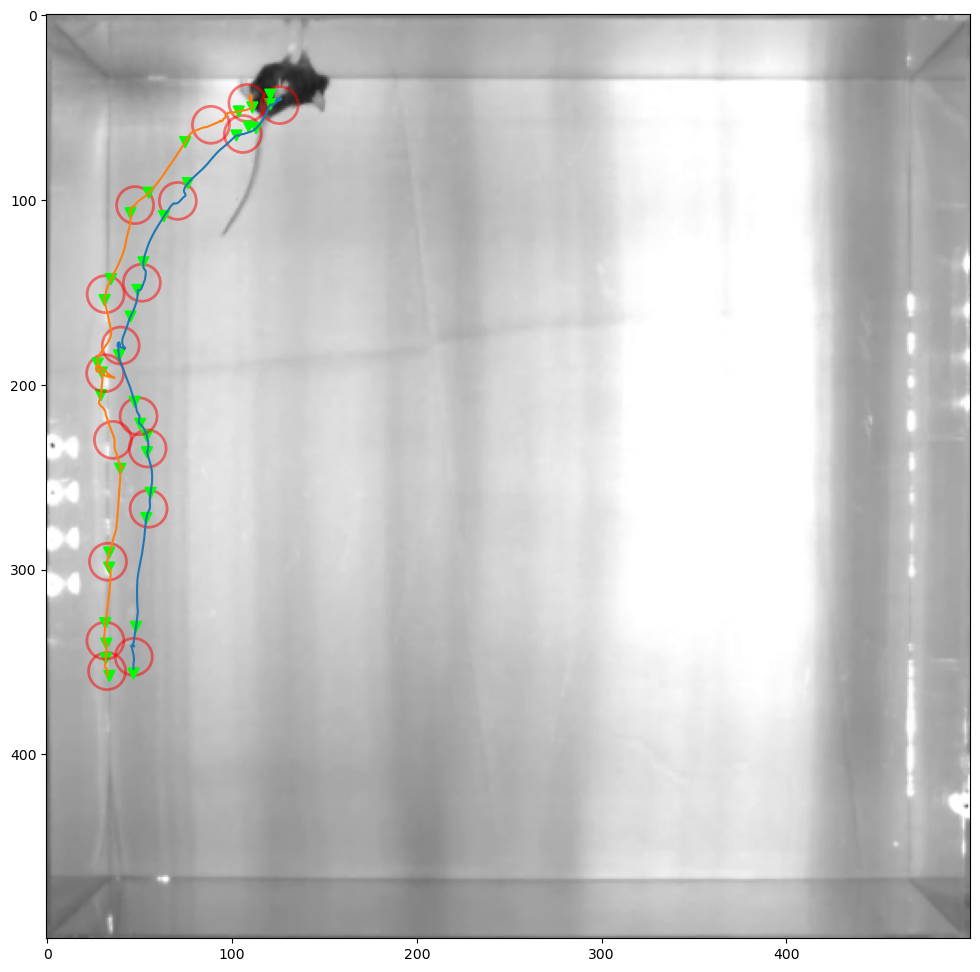

Video 40/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3997/3997 [00:14<00:00, 267.93it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m14_recording3, steps: 854 -- left_back_paw, stride-length: 4.38 +/- 2.45, duration: 11.68 +/- 7.54


100%|██████████| 4169/4169 [00:15<00:00, 267.98it/s]


m14_recording3, steps: 912 -- right_back_paw, stride-length: 4.01 +/- 2.50, duration: 11.73 +/- 7.75


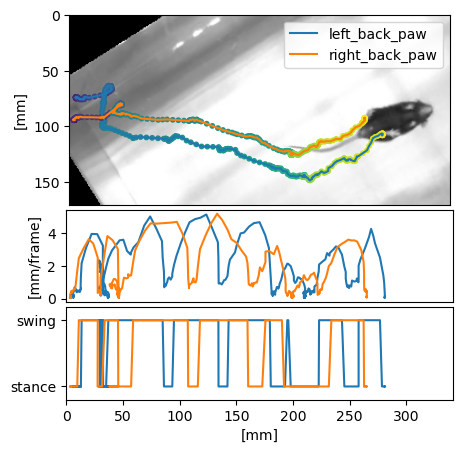

100%|██████████| 66000/66000 [00:00<00:00, 247668.97it/s]


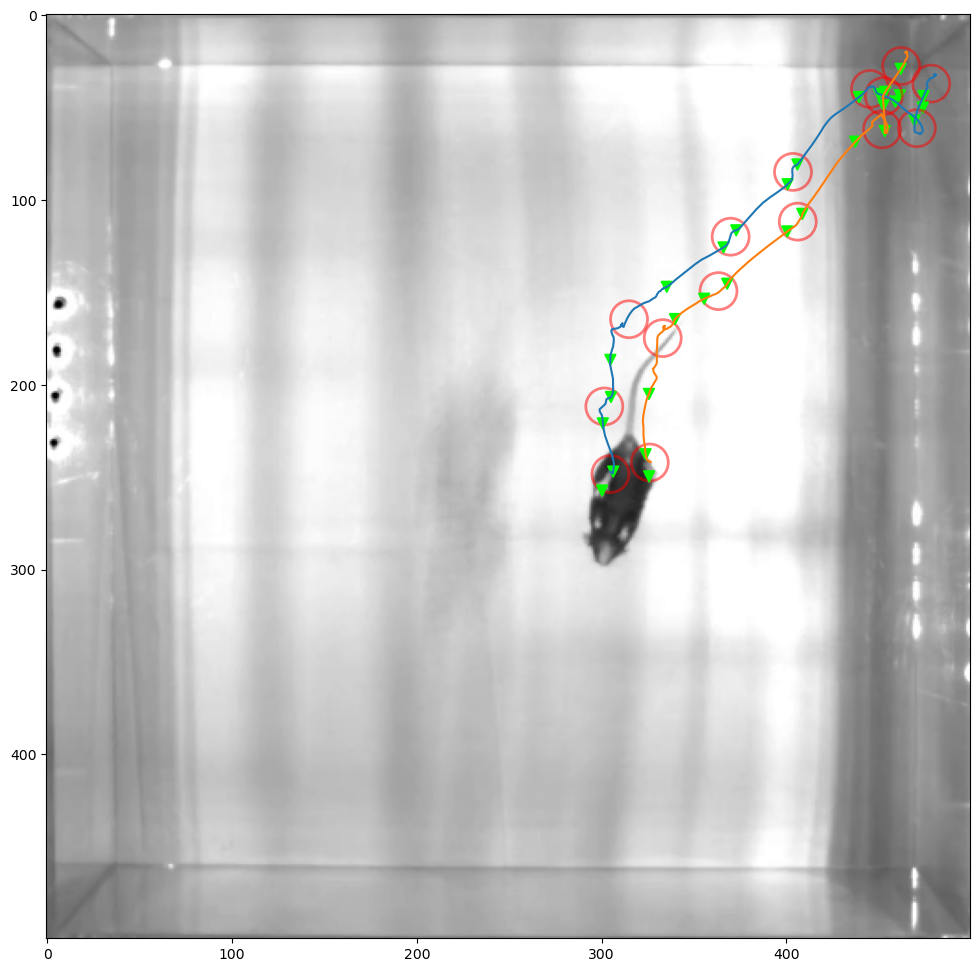

Video 41/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3117/3117 [00:11<00:00, 269.84it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m15_baseline, steps: 728 -- left_back_paw, stride-length: 3.95 +/- 2.29, duration: 11.26 +/- 7.03


100%|██████████| 3411/3411 [00:12<00:00, 274.33it/s]


m15_baseline, steps: 821 -- right_back_paw, stride-length: 3.91 +/- 2.39, duration: 11.45 +/- 7.07


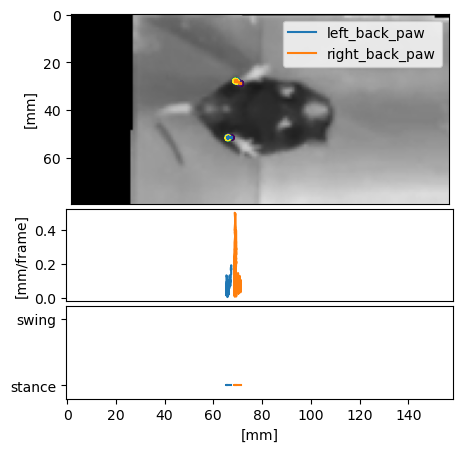

100%|██████████| 66000/66000 [00:00<00:00, 248913.40it/s]


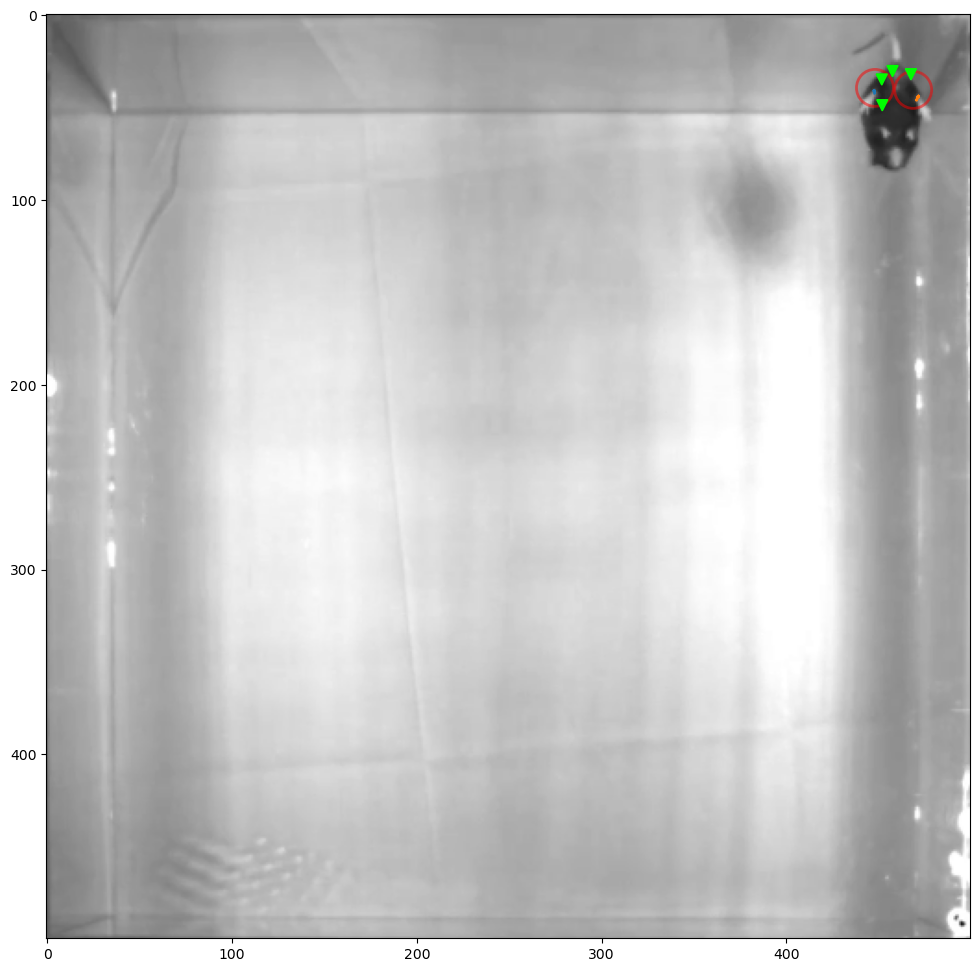

Video 42/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2925/2925 [00:10<00:00, 269.46it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m15_recording1, steps: 666 -- left_back_paw, stride-length: 4.32 +/- 2.34, duration: 11.94 +/- 7.26


100%|██████████| 3091/3091 [00:11<00:00, 274.98it/s]


m15_recording1, steps: 741 -- right_back_paw, stride-length: 4.25 +/- 2.53, duration: 12.30 +/- 7.29


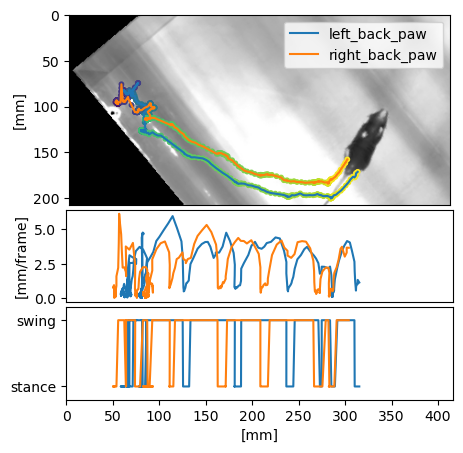

100%|██████████| 65779/65779 [00:00<00:00, 249864.72it/s]


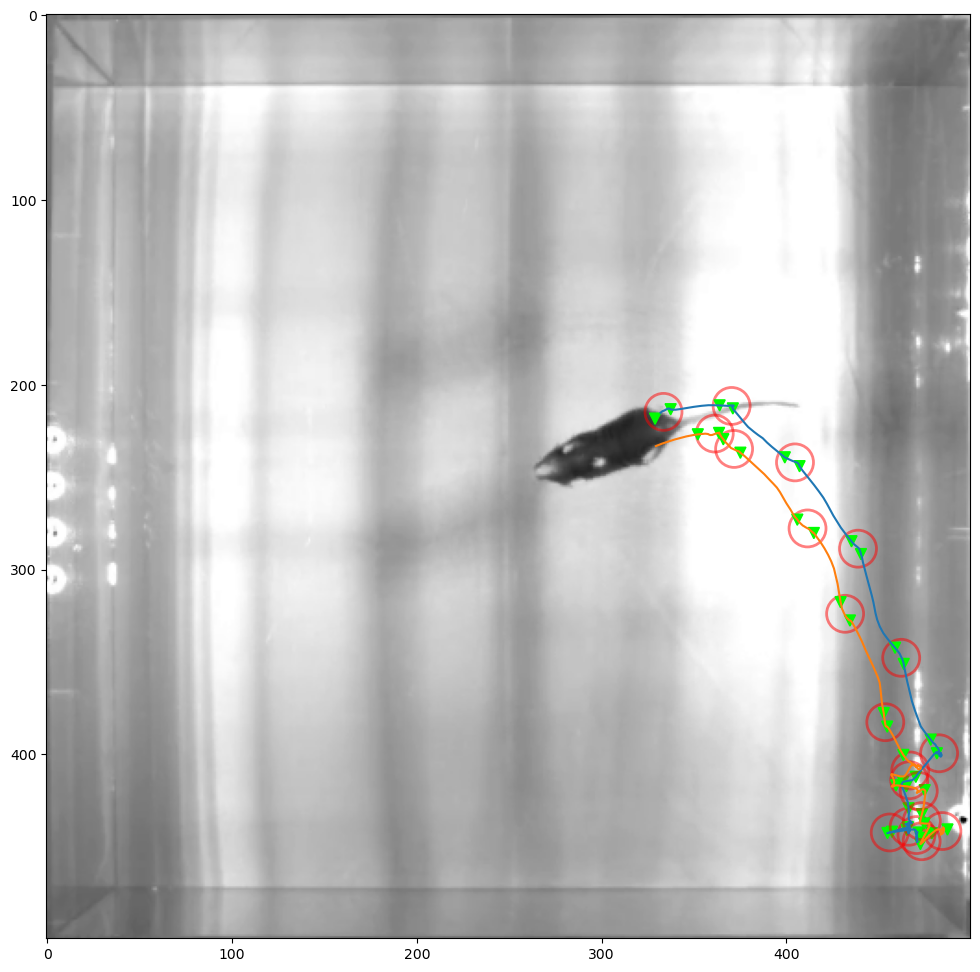

Video 43/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2669/2669 [00:09<00:00, 270.03it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m15_recording2, steps: 577 -- left_back_paw, stride-length: 4.82 +/- 2.45, duration: 12.90 +/- 7.34


100%|██████████| 2739/2739 [00:10<00:00, 269.36it/s]


m15_recording2, steps: 598 -- right_back_paw, stride-length: 4.92 +/- 2.59, duration: 13.04 +/- 7.50


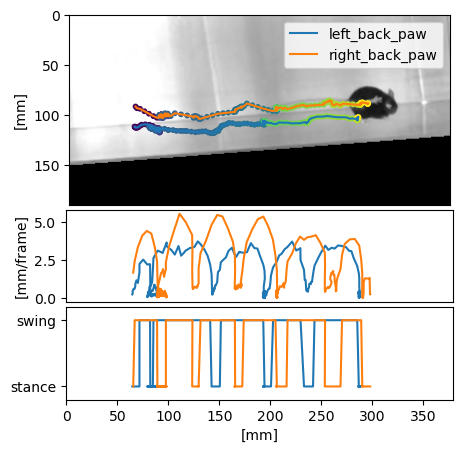

100%|██████████| 66000/66000 [00:00<00:00, 257765.41it/s]


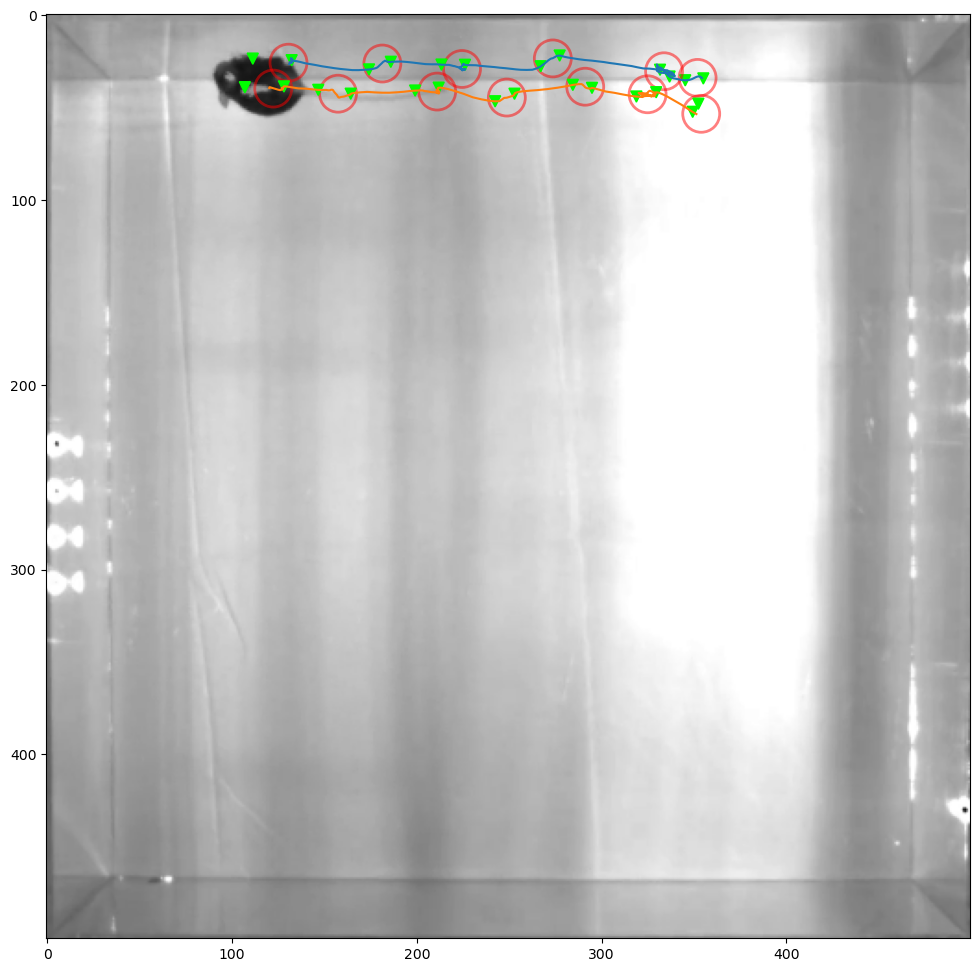

Video 44/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3153/3153 [00:11<00:00, 272.36it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m15_recording3, steps: 691 -- left_back_paw, stride-length: 4.16 +/- 2.41, duration: 11.54 +/- 7.30


100%|██████████| 3081/3081 [00:11<00:00, 276.33it/s]


m15_recording3, steps: 696 -- right_back_paw, stride-length: 4.11 +/- 2.42, duration: 11.88 +/- 7.34


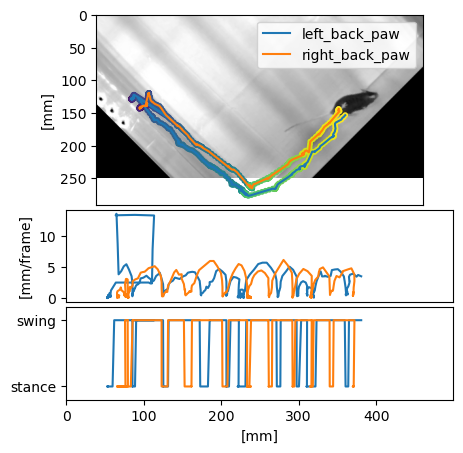

100%|██████████| 65963/65963 [00:00<00:00, 250186.62it/s]


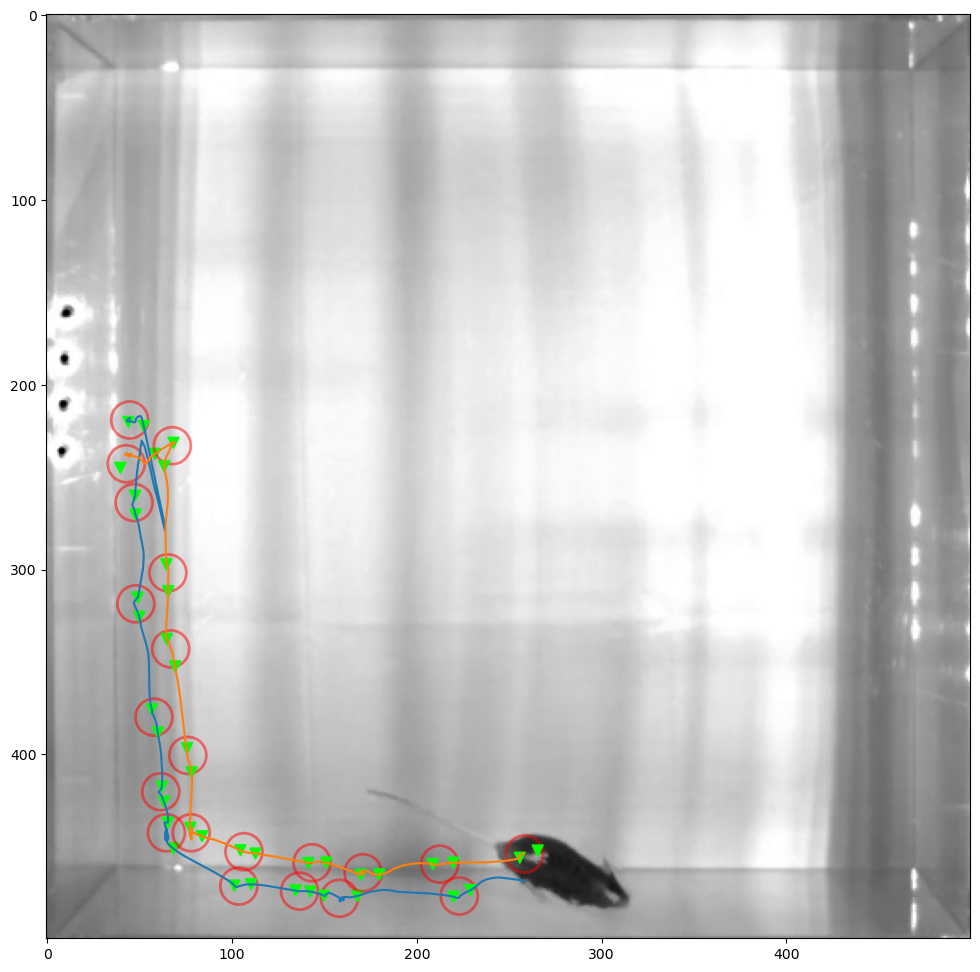

Video 45/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3117/3117 [00:11<00:00, 263.83it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m16_baseline, steps: 657 -- left_back_paw, stride-length: 4.28 +/- 2.59, duration: 10.98 +/- 7.46


100%|██████████| 2821/2821 [00:10<00:00, 268.44it/s]


m16_baseline, steps: 598 -- right_back_paw, stride-length: 4.20 +/- 2.50, duration: 10.91 +/- 7.52


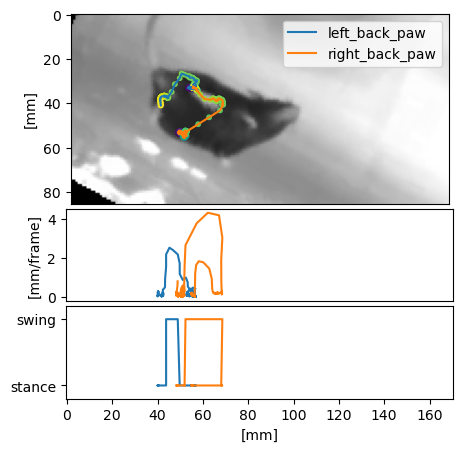

100%|██████████| 65966/65966 [00:00<00:00, 252689.82it/s]


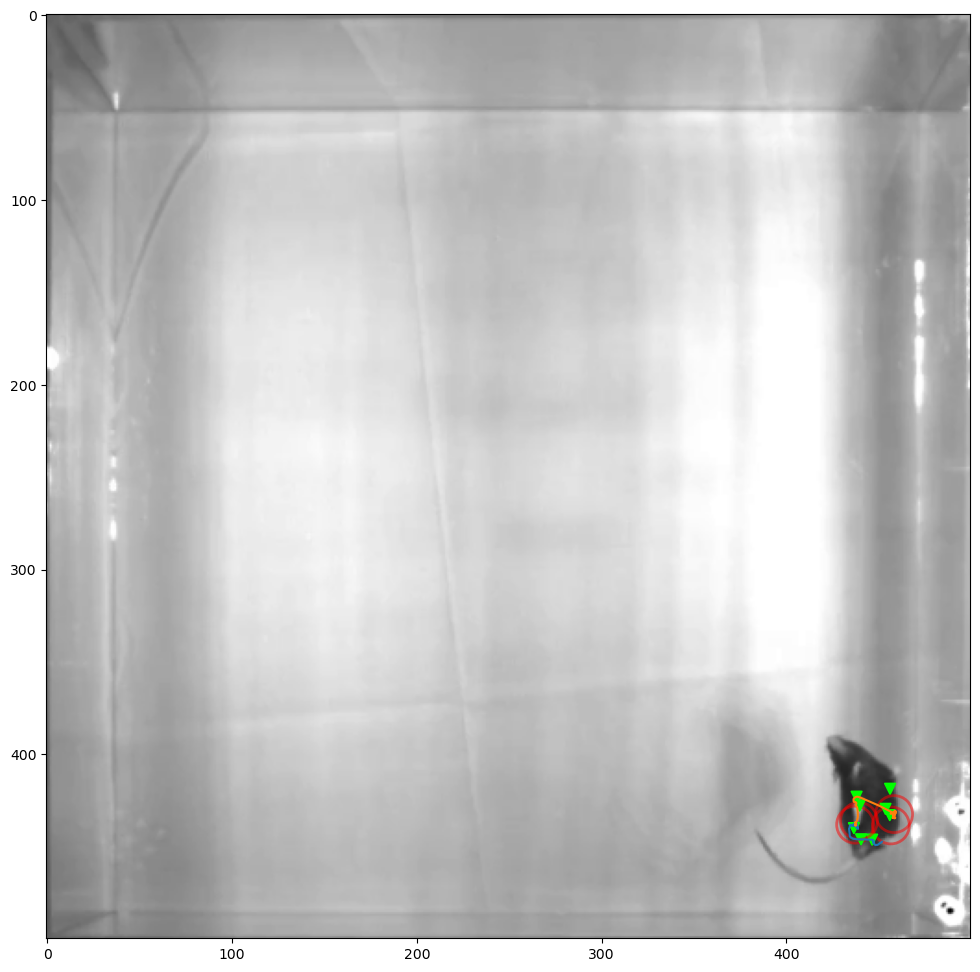

Video 46/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3085/3085 [00:11<00:00, 263.69it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m16_recording1, steps: 625 -- left_back_paw, stride-length: 4.06 +/- 2.30, duration: 11.45 +/- 7.90


100%|██████████| 2669/2669 [00:09<00:00, 268.79it/s]


m16_recording1, steps: 546 -- right_back_paw, stride-length: 4.00 +/- 2.53, duration: 10.77 +/- 7.60


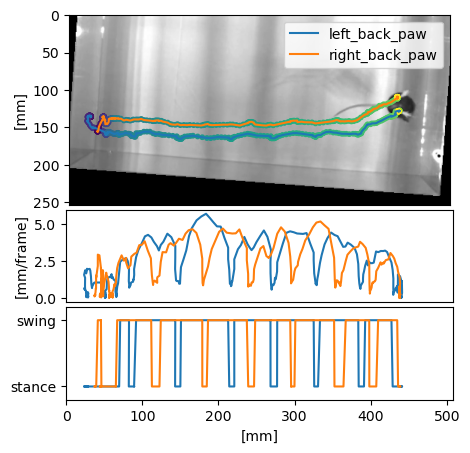

100%|██████████| 65935/65935 [00:00<00:00, 255057.01it/s]


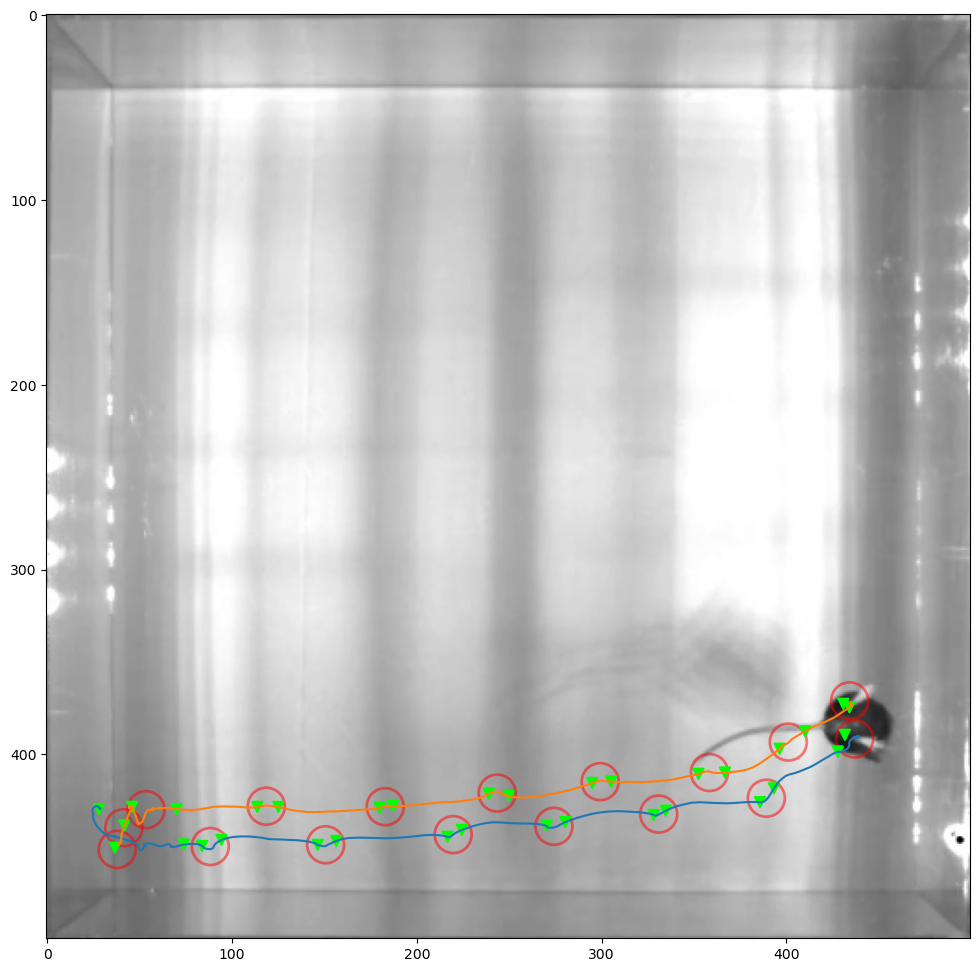

Video 47/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3049/3049 [00:11<00:00, 268.12it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m16_recording2, steps: 608 -- left_back_paw, stride-length: 3.91 +/- 2.29, duration: 10.38 +/- 7.49


100%|██████████| 2777/2777 [00:10<00:00, 268.60it/s]


m16_recording2, steps: 540 -- right_back_paw, stride-length: 4.14 +/- 2.40, duration: 11.47 +/- 7.53


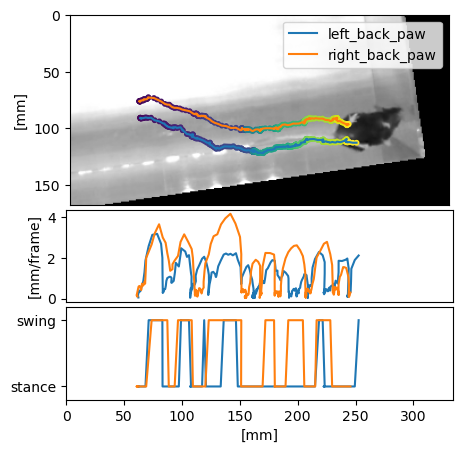

100%|██████████| 65999/65999 [00:00<00:00, 248285.64it/s]


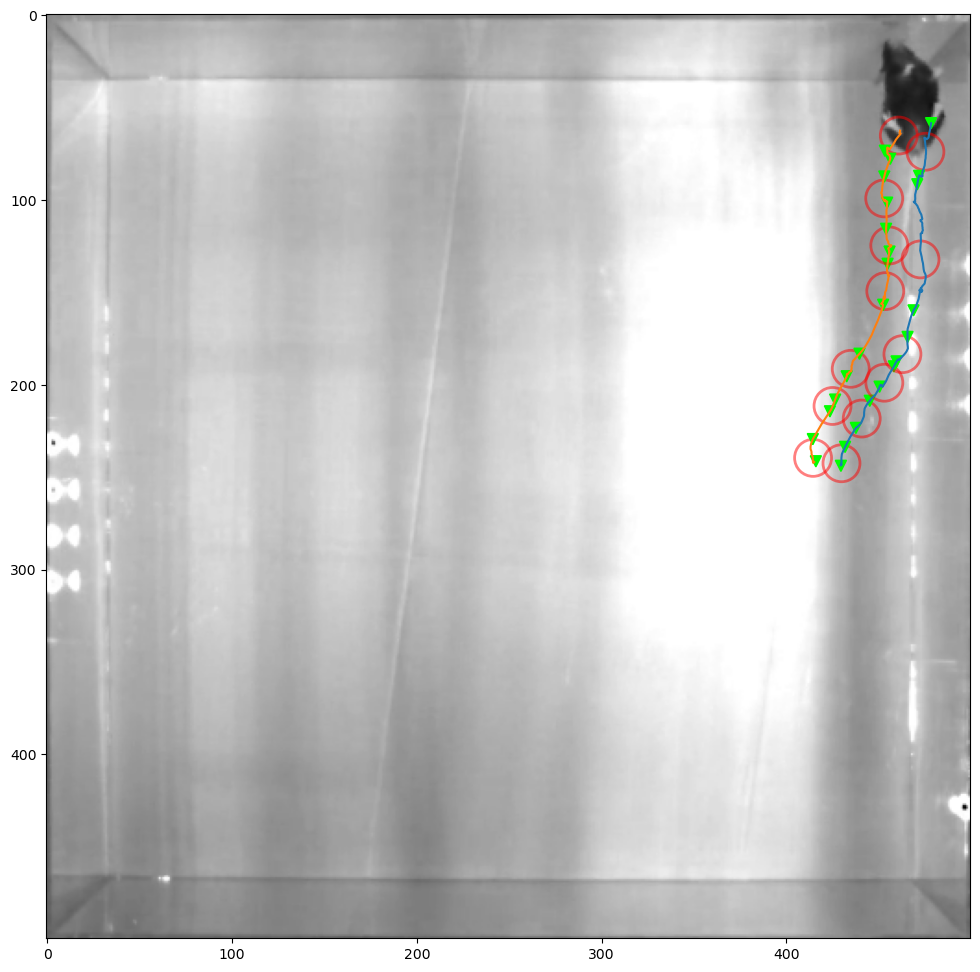

Video 48/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3129/3129 [00:11<00:00, 265.34it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m16_recording3, steps: 607 -- left_back_paw, stride-length: 4.31 +/- 2.45, duration: 11.25 +/- 7.68


100%|██████████| 3005/3005 [00:11<00:00, 262.72it/s]


m16_recording3, steps: 575 -- right_back_paw, stride-length: 4.31 +/- 2.55, duration: 11.09 +/- 7.51


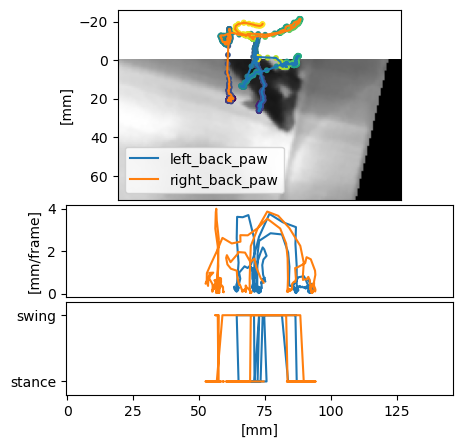

100%|██████████| 66000/66000 [00:00<00:00, 251334.48it/s]


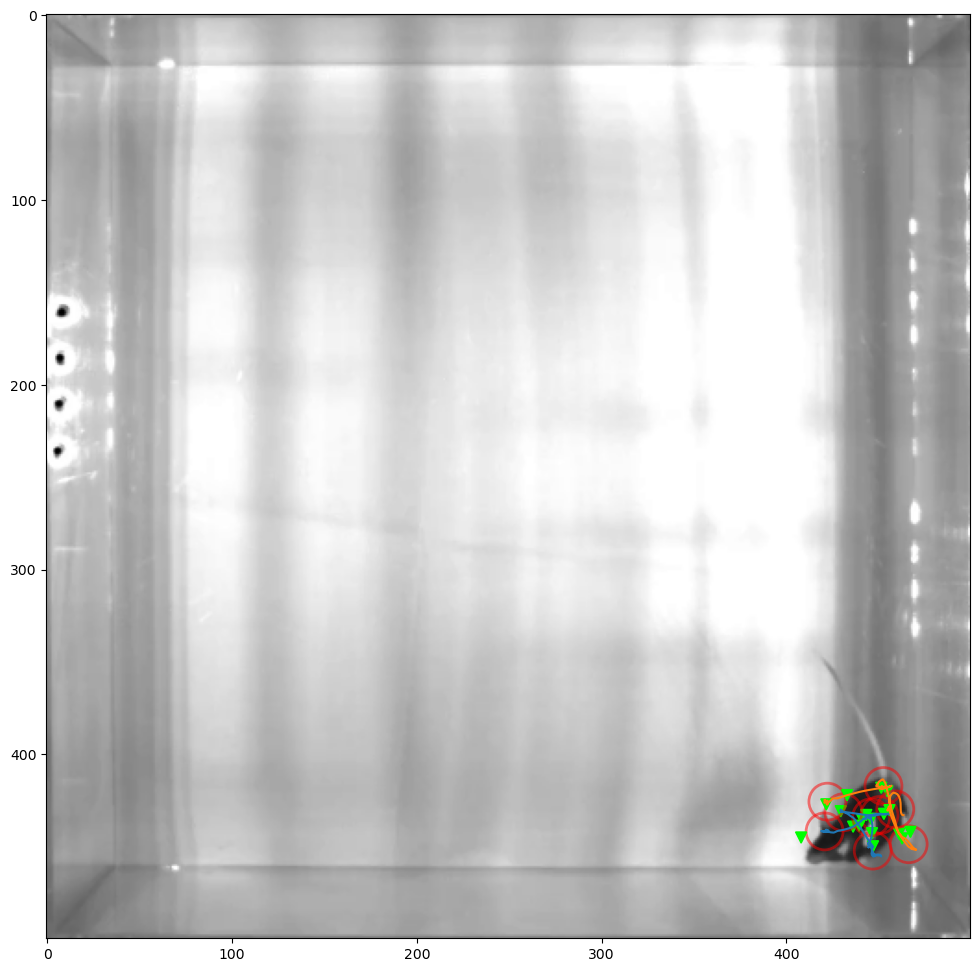

Video 49/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2981/2981 [00:11<00:00, 270.60it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m17_baseline, steps: 694 -- left_back_paw, stride-length: 3.79 +/- 2.25, duration: 11.11 +/- 7.07


100%|██████████| 3313/3313 [00:12<00:00, 272.87it/s]


m17_baseline, steps: 763 -- right_back_paw, stride-length: 3.80 +/- 2.37, duration: 11.60 +/- 7.35


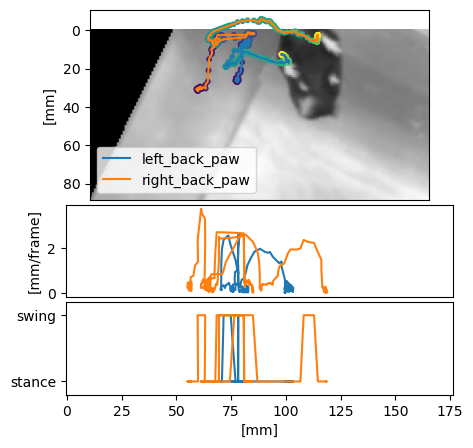

100%|██████████| 65205/65205 [00:00<00:00, 244866.86it/s]


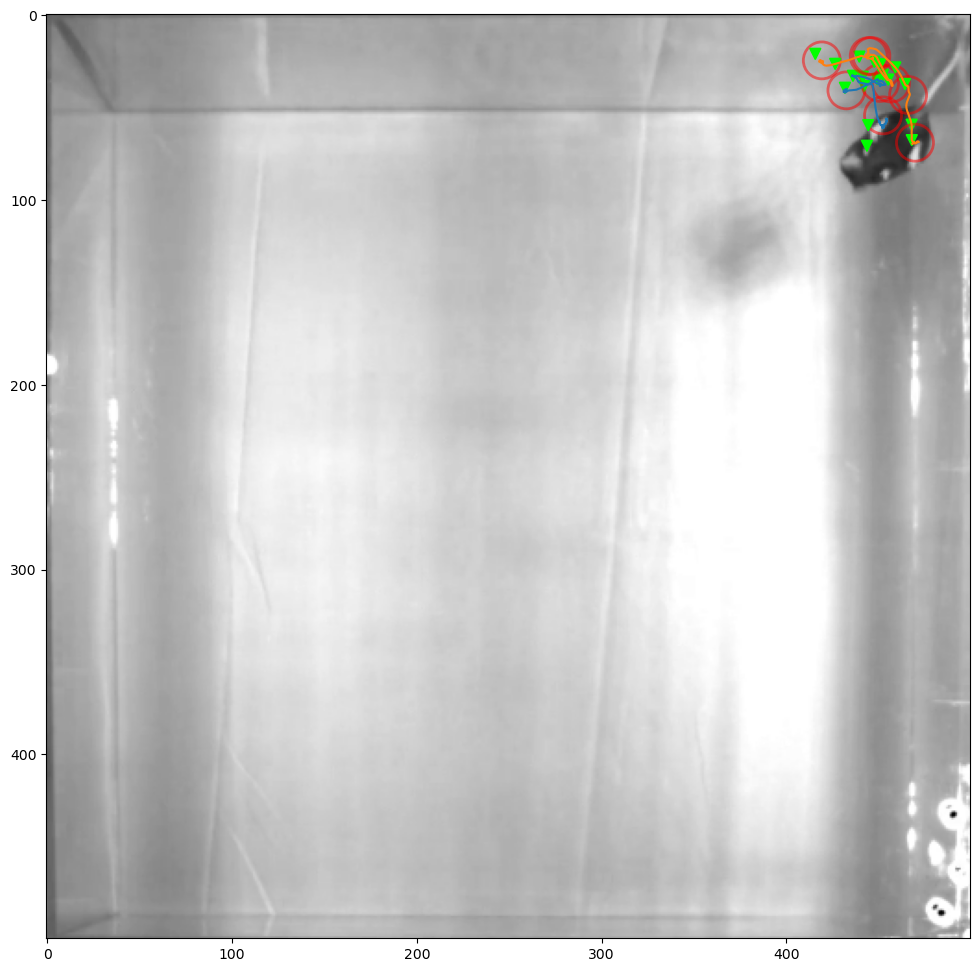

Video 50/64
DID NOT FIND DLC FILE!
Video 51/64
DID NOT FIND DLC FILE!
Video 52/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3035/3035 [00:11<00:00, 272.16it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m17_recording3, steps: 687 -- left_back_paw, stride-length: 3.74 +/- 2.25, duration: 10.84 +/- 6.86


100%|██████████| 3569/3569 [00:13<00:00, 269.75it/s]


m17_recording3, steps: 822 -- right_back_paw, stride-length: 3.51 +/- 2.19, duration: 11.08 +/- 7.25


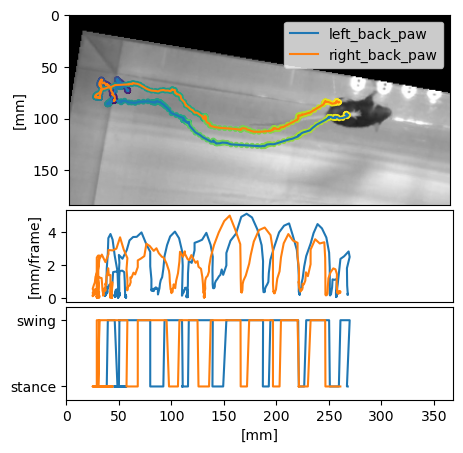

100%|██████████| 65687/65687 [00:00<00:00, 254857.59it/s]


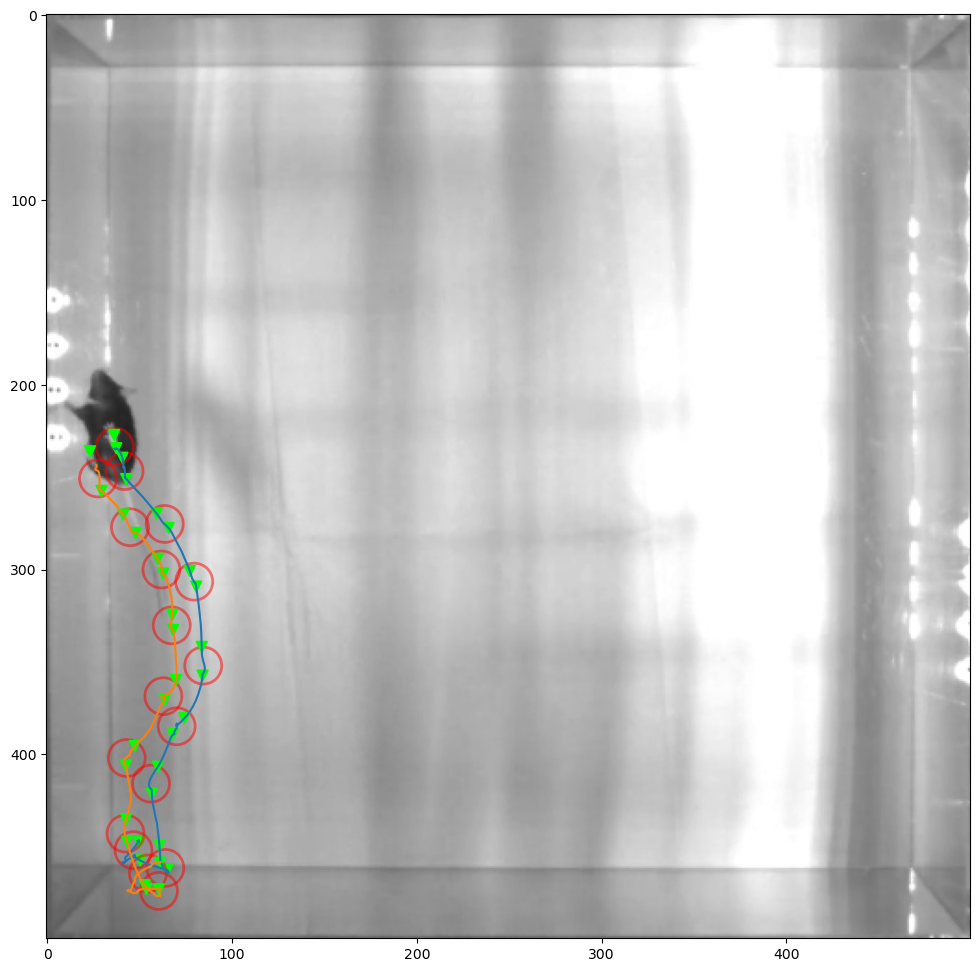

Video 53/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2971/2971 [00:10<00:00, 270.45it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m18_baseline, steps: 666 -- left_back_paw, stride-length: 4.10 +/- 2.45, duration: 12.49 +/- 7.75


100%|██████████| 2837/2837 [00:10<00:00, 273.79it/s]


m18_baseline, steps: 637 -- right_back_paw, stride-length: 4.23 +/- 2.66, duration: 12.08 +/- 7.53


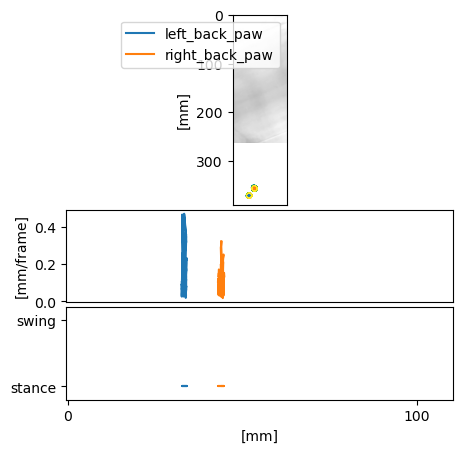

100%|██████████| 65837/65837 [00:00<00:00, 254158.01it/s]


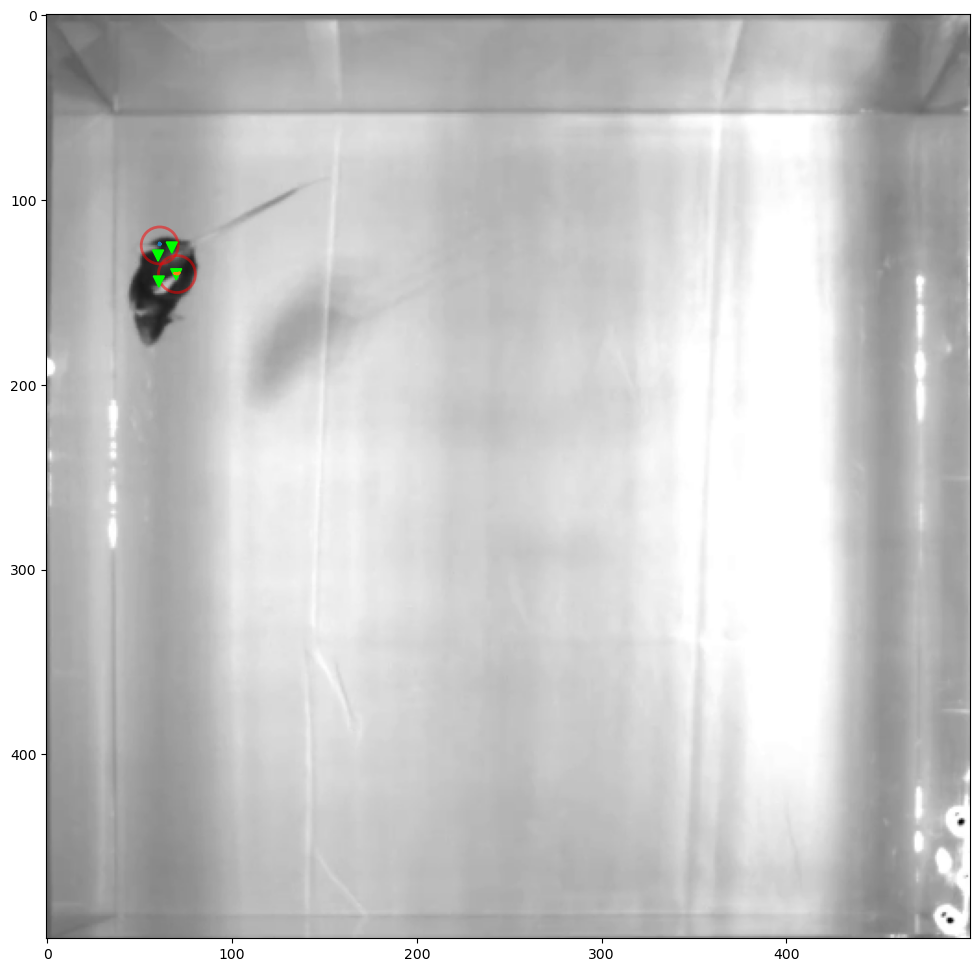

Video 54/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3569/3569 [00:13<00:00, 272.83it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m18_recording1, steps: 877 -- left_back_paw, stride-length: 3.94 +/- 2.38, duration: 12.42 +/- 7.52


100%|██████████| 3505/3505 [00:12<00:00, 269.69it/s]


m18_recording1, steps: 838 -- right_back_paw, stride-length: 4.19 +/- 2.61, duration: 12.17 +/- 7.82


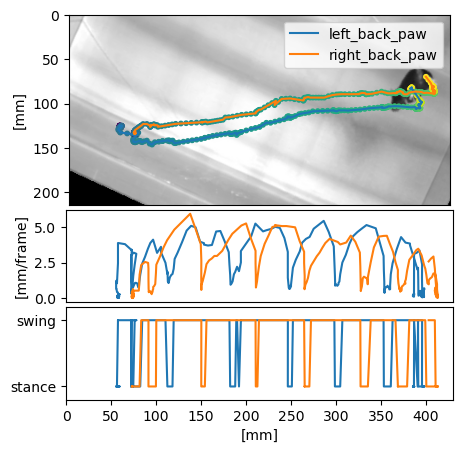

100%|██████████| 66000/66000 [00:00<00:00, 253428.55it/s]


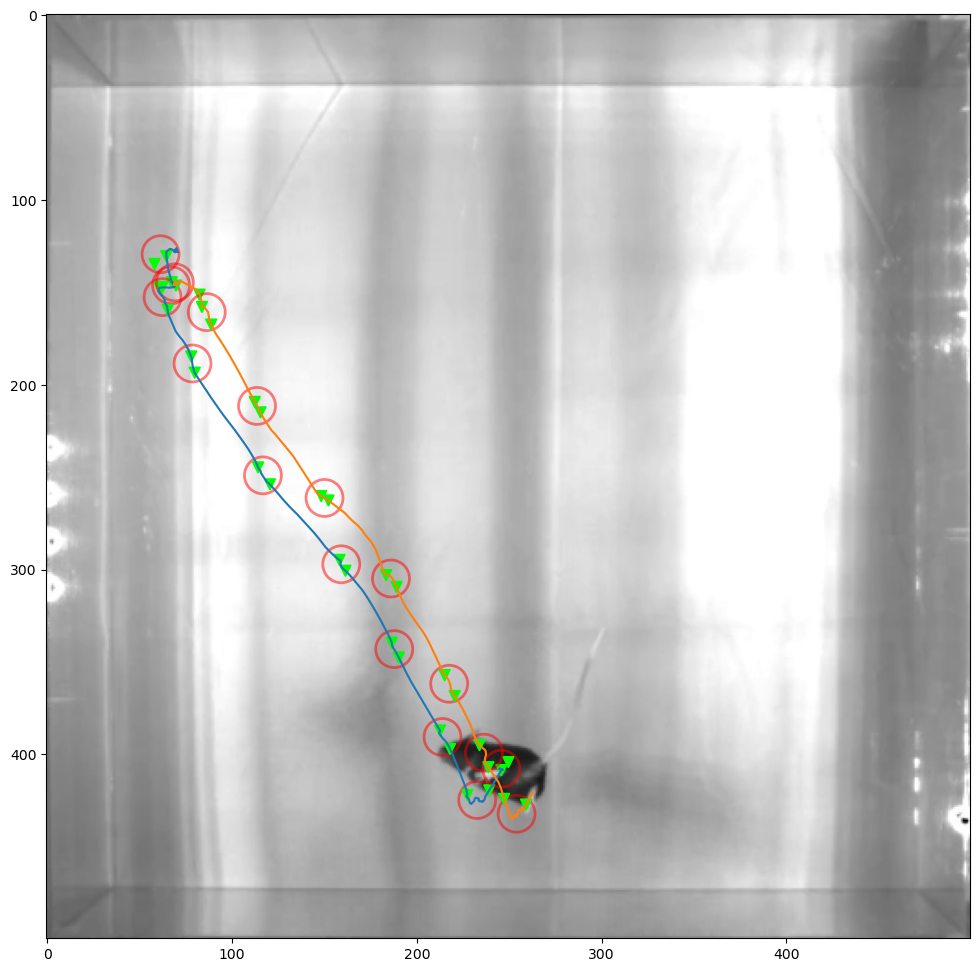

Video 55/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2861/2861 [00:10<00:00, 274.33it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m18_recording2, steps: 583 -- left_back_paw, stride-length: 4.43 +/- 2.52, duration: 13.22 +/- 7.62


100%|██████████| 2771/2771 [00:10<00:00, 273.76it/s]


m18_recording2, steps: 578 -- right_back_paw, stride-length: 4.62 +/- 2.92, duration: 12.10 +/- 8.10


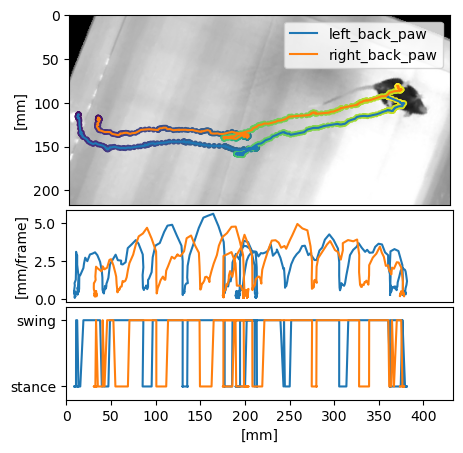

100%|██████████| 65179/65179 [00:00<00:00, 253879.78it/s]


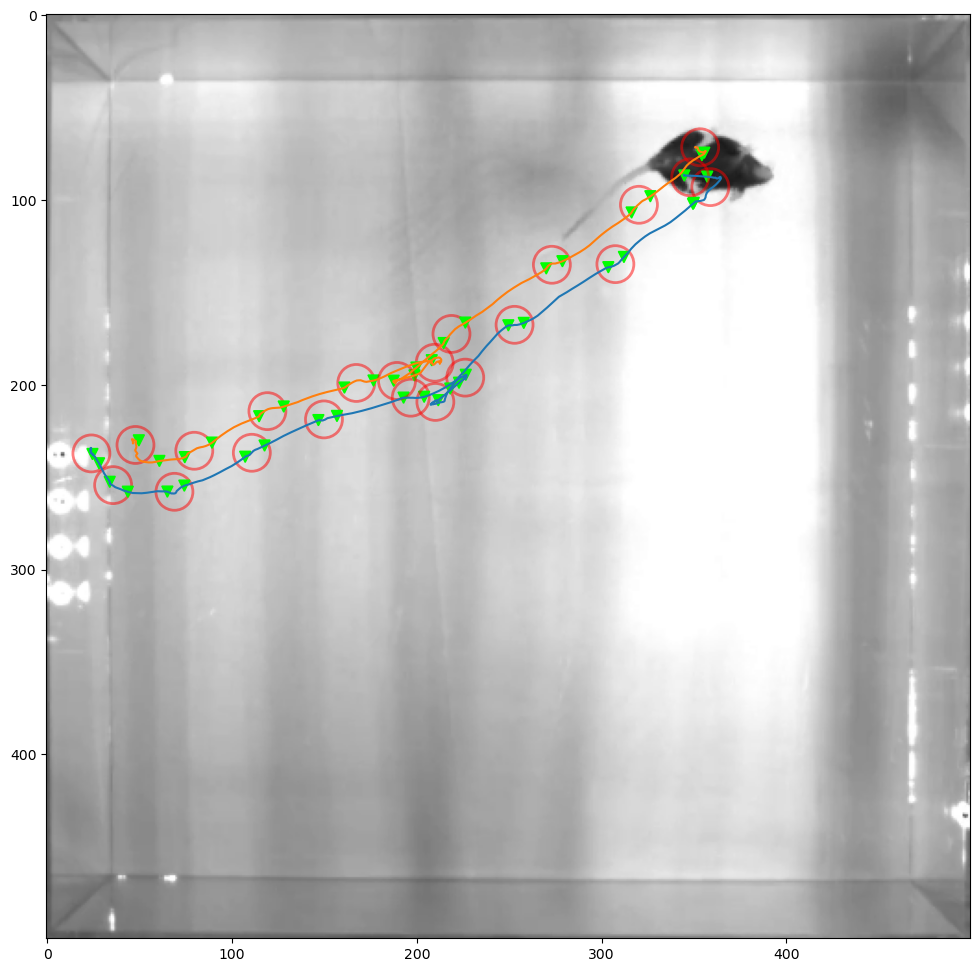

Video 56/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 4185/4185 [00:15<00:00, 268.77it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m18_recording3, steps: 970 -- left_back_paw, stride-length: 4.03 +/- 2.47, duration: 12.53 +/- 7.60


100%|██████████| 4263/4263 [00:15<00:00, 268.17it/s]


m18_recording3, steps: 965 -- right_back_paw, stride-length: 4.04 +/- 2.56, duration: 11.61 +/- 7.84


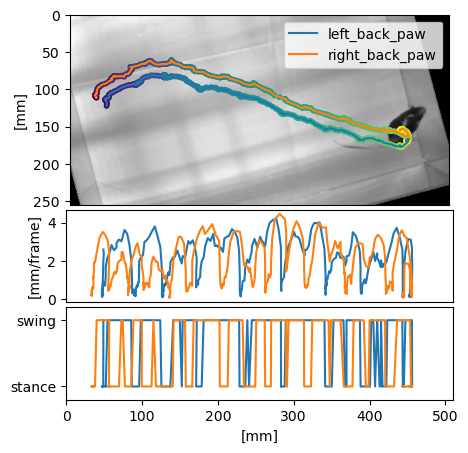

100%|██████████| 65963/65963 [00:00<00:00, 248993.27it/s]


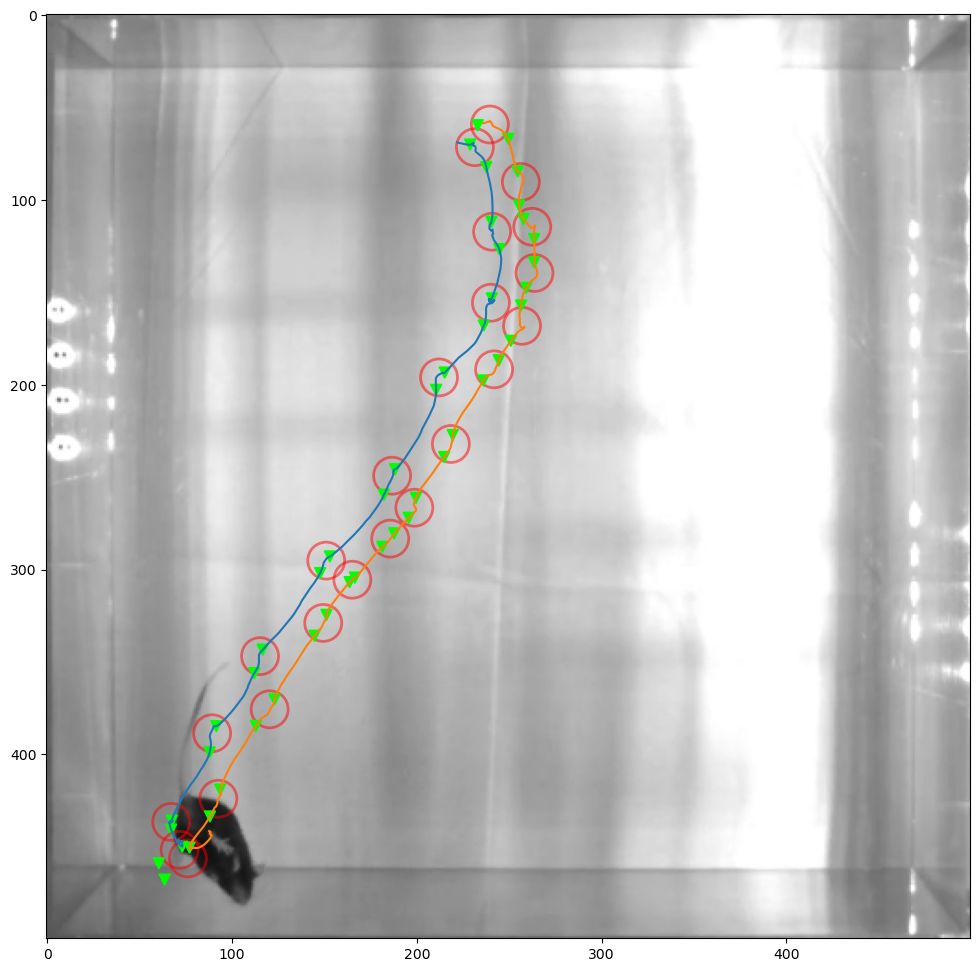

Video 57/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3915/3915 [00:14<00:00, 268.79it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m19_baseline, steps: 838 -- left_back_paw, stride-length: 3.50 +/- 2.11, duration: 10.62 +/- 7.57


100%|██████████| 3947/3947 [00:14<00:00, 270.13it/s]


m19_baseline, steps: 886 -- right_back_paw, stride-length: 3.52 +/- 2.30, duration: 10.62 +/- 7.57


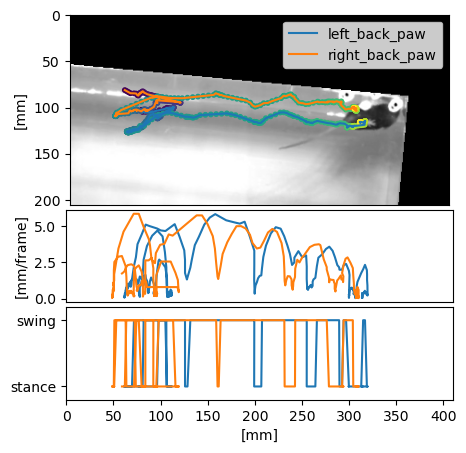

100%|██████████| 65544/65544 [00:00<00:00, 249444.43it/s]


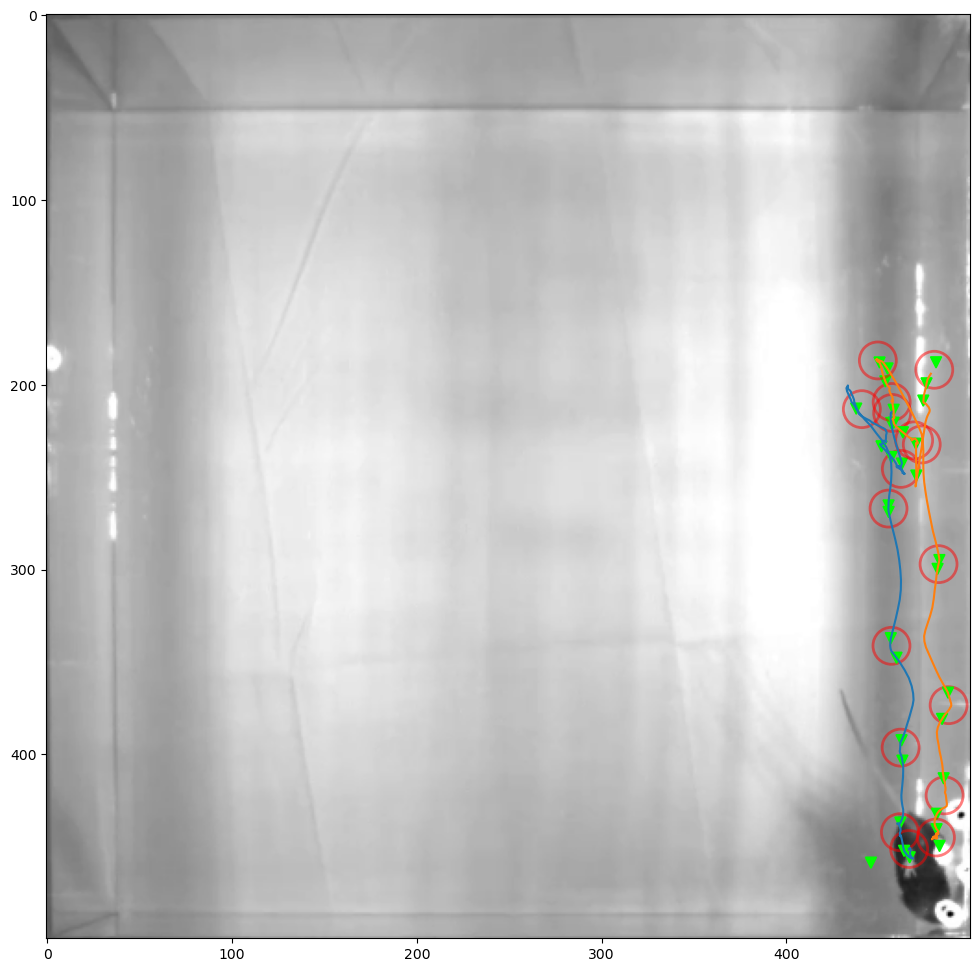

Video 58/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2795/2795 [00:10<00:00, 266.89it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m19_recording1, steps: 576 -- left_back_paw, stride-length: 4.01 +/- 2.31, duration: 10.33 +/- 7.02


100%|██████████| 2885/2885 [00:10<00:00, 269.84it/s]


m19_recording1, steps: 636 -- right_back_paw, stride-length: 3.94 +/- 2.62, duration: 10.68 +/- 7.61


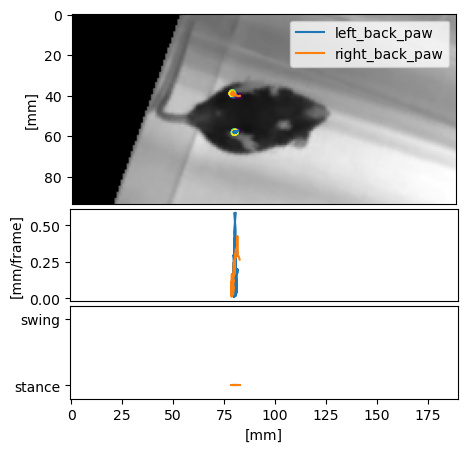

100%|██████████| 66000/66000 [00:00<00:00, 257163.17it/s]


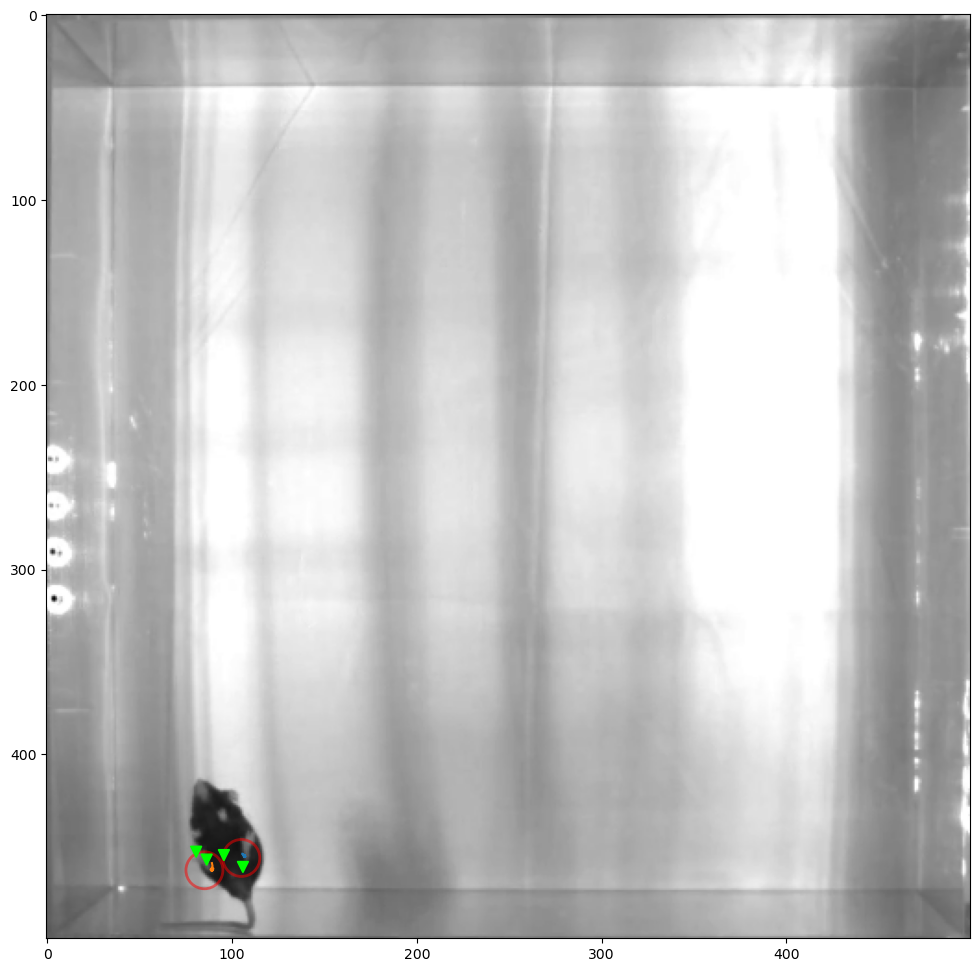

Video 59/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 3235/3235 [00:12<00:00, 261.16it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m19_recording2, steps: 628 -- left_back_paw, stride-length: 3.65 +/- 2.25, duration: 9.45 +/- 7.25


100%|██████████| 3131/3131 [00:11<00:00, 264.89it/s]


m19_recording2, steps: 597 -- right_back_paw, stride-length: 4.21 +/- 2.50, duration: 10.56 +/- 7.47


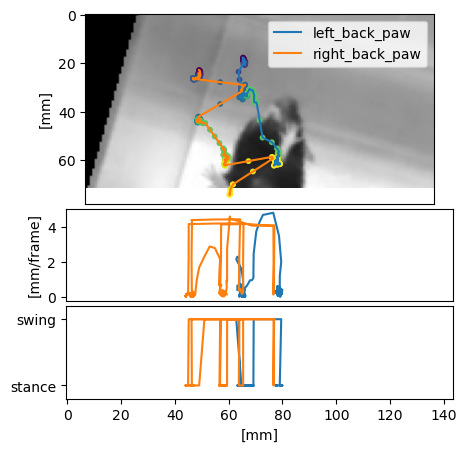

100%|██████████| 65661/65661 [00:00<00:00, 258343.03it/s]


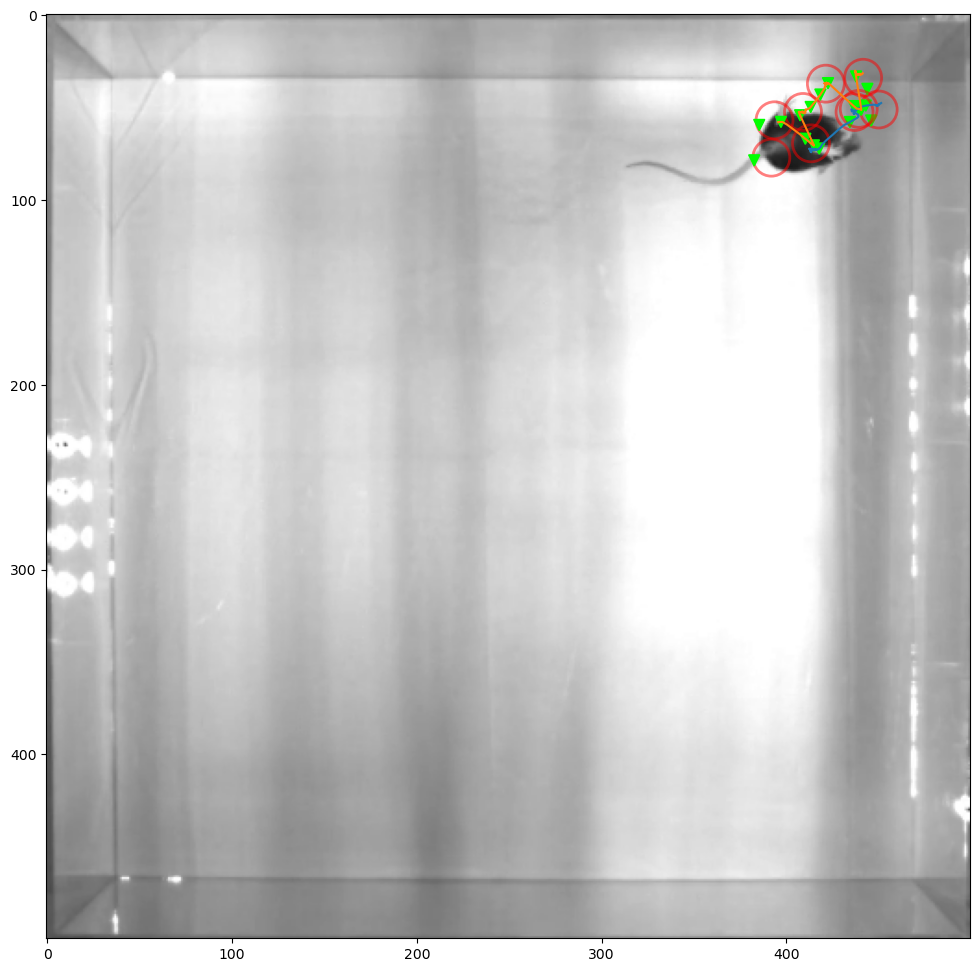

Video 60/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 621/621 [00:02<00:00, 266.94it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m19_recording3, steps: 99 -- left_back_paw, stride-length: 5.11 +/- 3.09, duration: 14.44 +/- 8.06


100%|██████████| 573/573 [00:02<00:00, 266.05it/s]


m19_recording3, steps: 85 -- right_back_paw, stride-length: 5.66 +/- 3.10, duration: 14.96 +/- 9.46


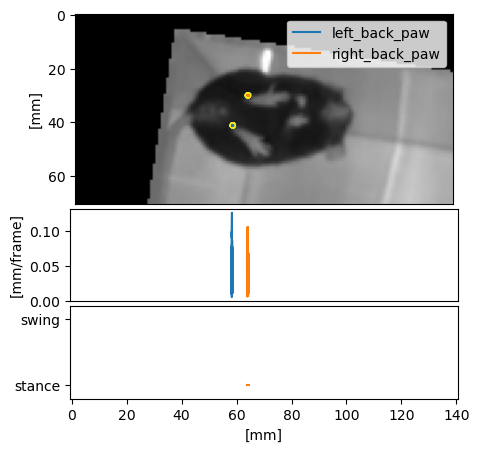

100%|██████████| 66000/66000 [00:00<00:00, 272577.58it/s]


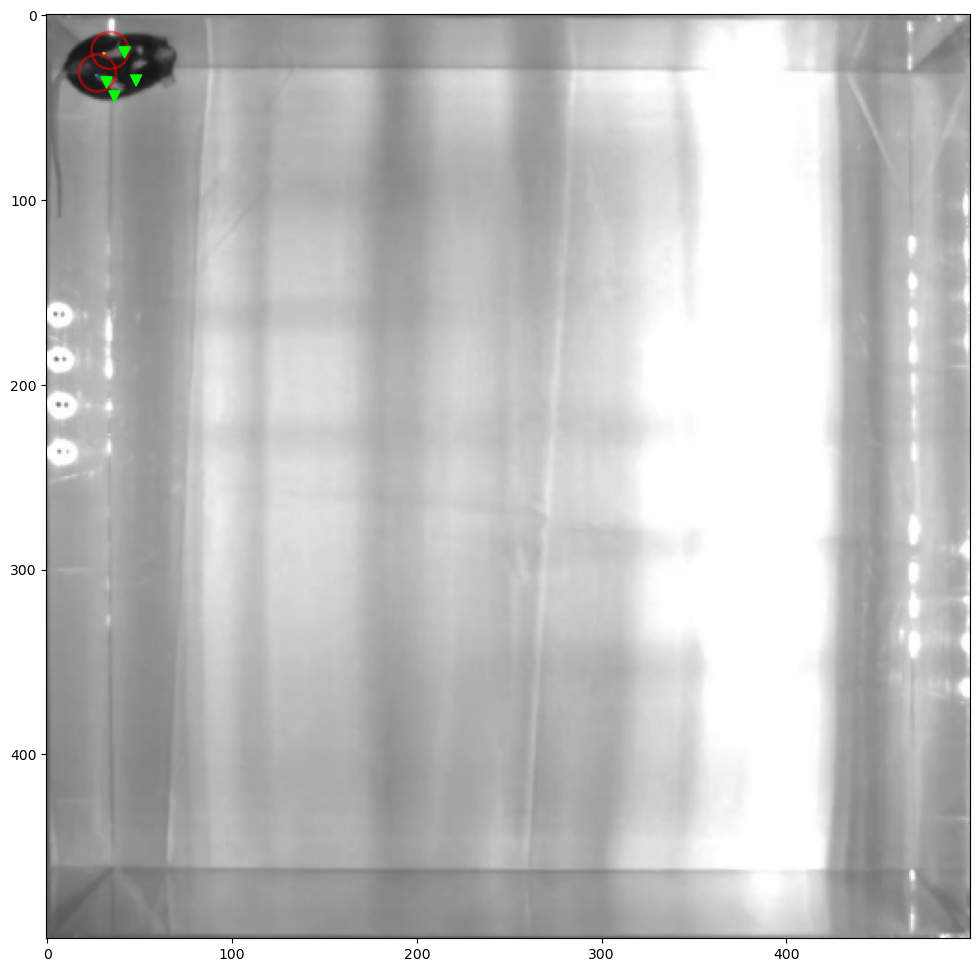

Video 61/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2013/2013 [00:07<00:00, 271.76it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m20_baseline, steps: 355 -- left_back_paw, stride-length: 4.72 +/- 2.56, duration: 13.08 +/- 7.99


100%|██████████| 2137/2137 [00:07<00:00, 273.43it/s]


m20_baseline, steps: 417 -- right_back_paw, stride-length: 4.61 +/- 2.79, duration: 12.52 +/- 7.59


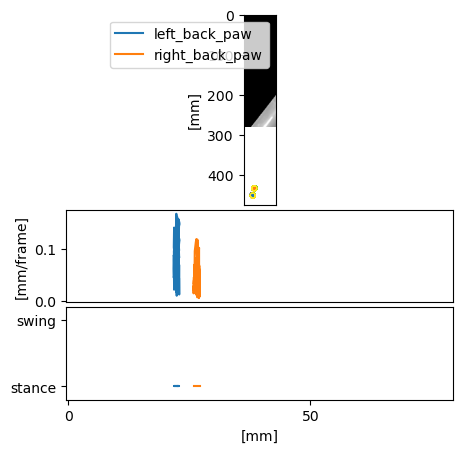

100%|██████████| 65574/65574 [00:00<00:00, 259149.12it/s]


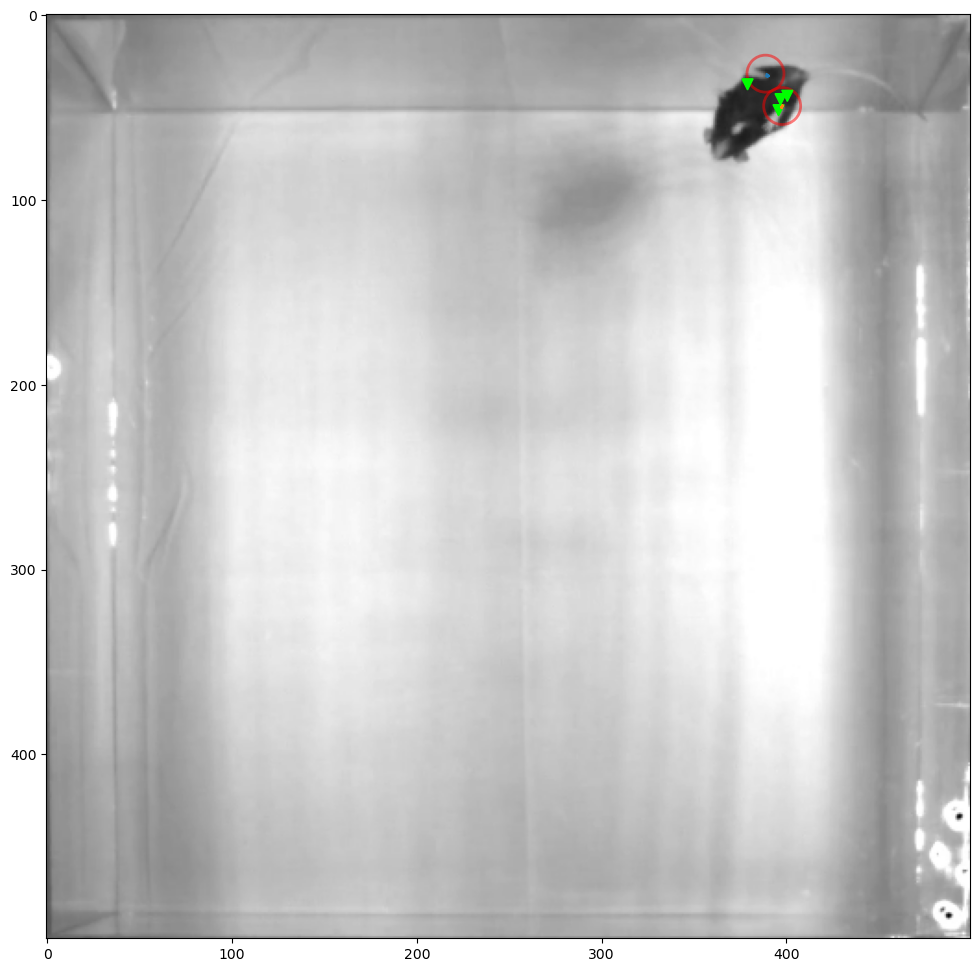

Video 62/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1273/1273 [00:04<00:00, 259.95it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m20_recording1, steps: 243 -- left_back_paw, stride-length: 4.86 +/- 2.89, duration: 12.14 +/- 7.87


100%|██████████| 1271/1271 [00:04<00:00, 264.96it/s]


m20_recording1, steps: 256 -- right_back_paw, stride-length: 4.52 +/- 2.49, duration: 11.84 +/- 7.37


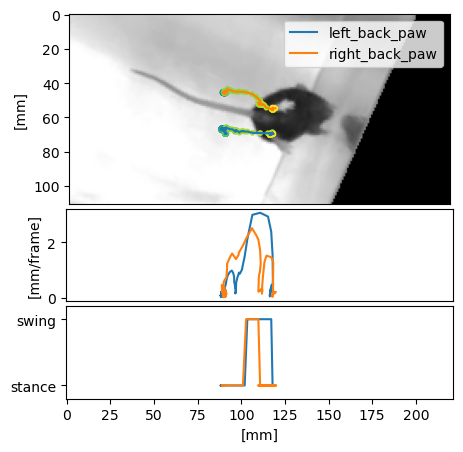

100%|██████████| 66000/66000 [00:00<00:00, 261329.82it/s]


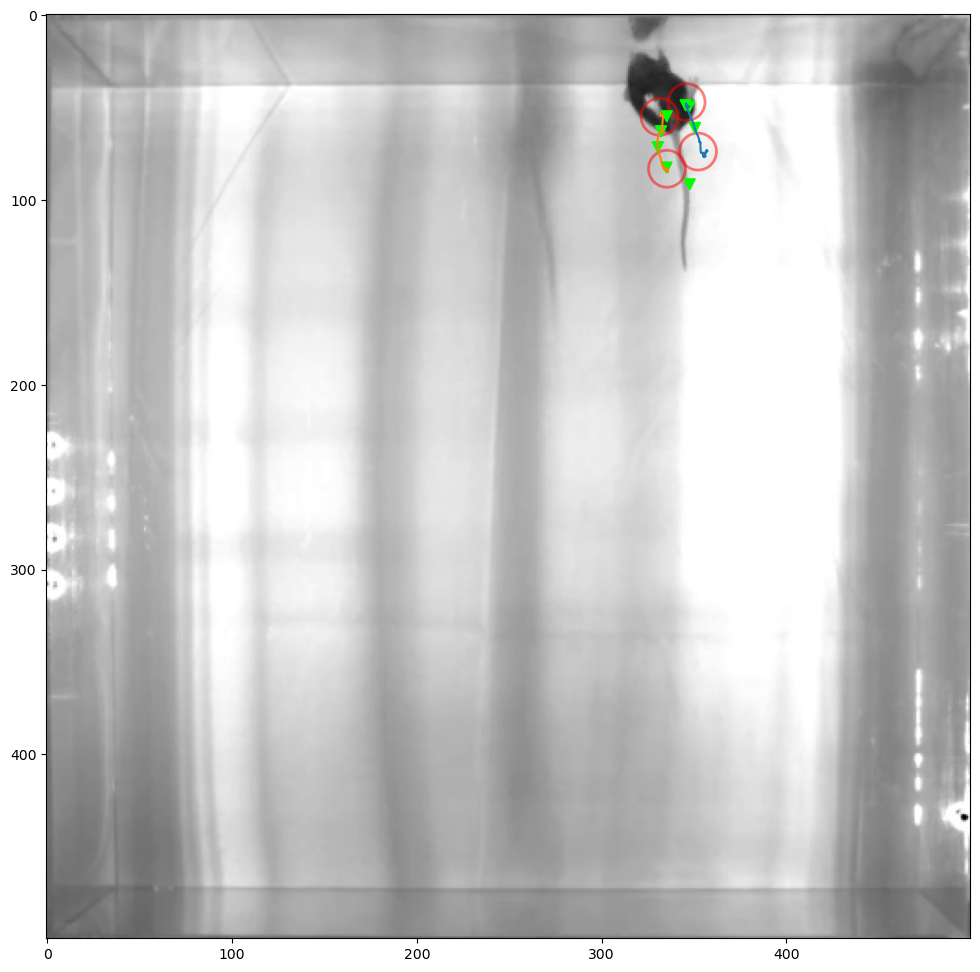

Video 63/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 1779/1779 [00:06<00:00, 267.69it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m20_recording2, steps: 332 -- left_back_paw, stride-length: 4.58 +/- 2.72, duration: 11.95 +/- 7.86


100%|██████████| 1713/1713 [00:06<00:00, 272.54it/s]


m20_recording2, steps: 340 -- right_back_paw, stride-length: 4.26 +/- 2.28, duration: 11.52 +/- 7.48


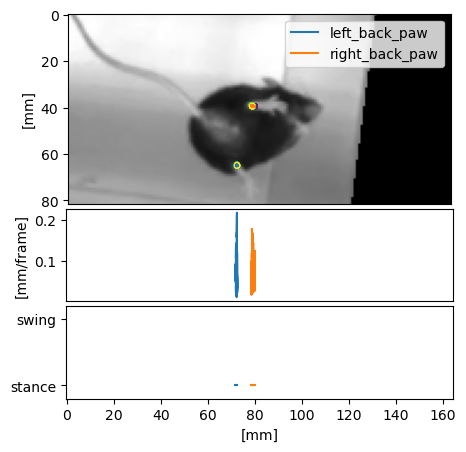

100%|██████████| 66000/66000 [00:00<00:00, 259560.44it/s]


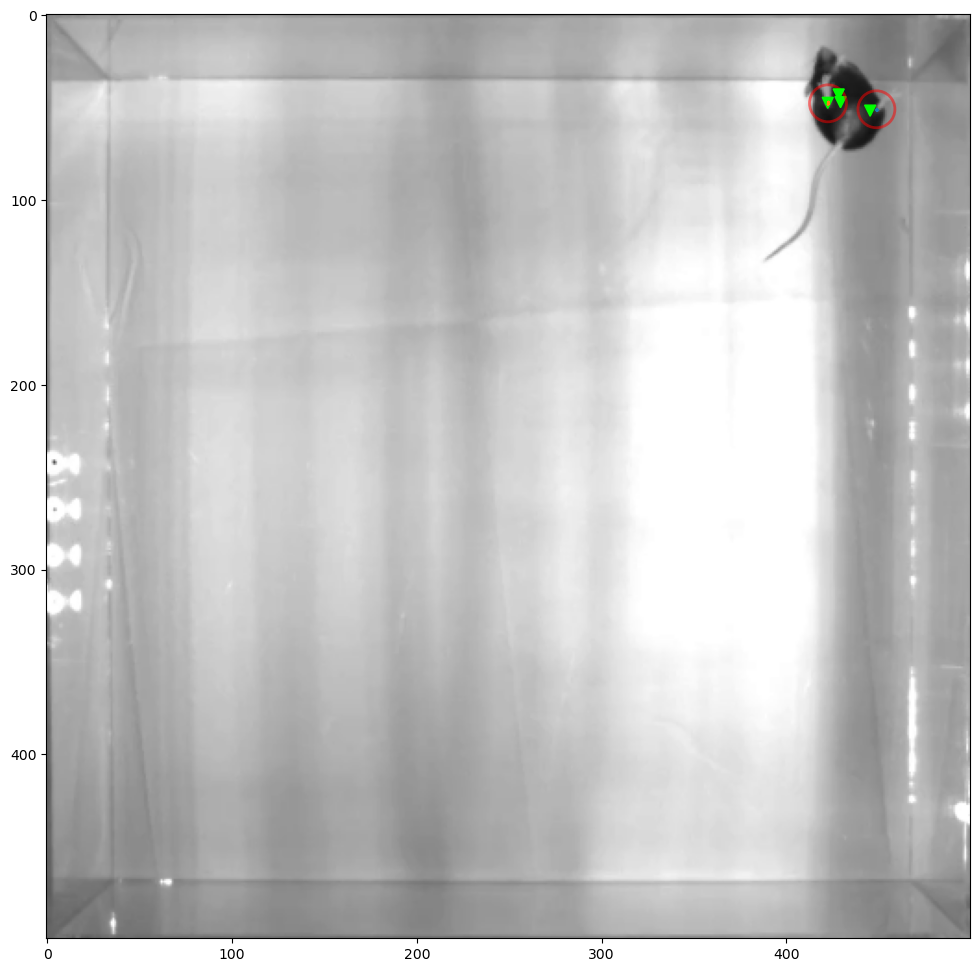

Video 64/64


/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
100%|██████████| 2749/2749 [00:10<00:00, 265.47it/s]
/home/andretelfer/anaconda3/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


m20_recording3, steps: 561 -- left_back_paw, stride-length: 4.02 +/- 2.40, duration: 11.47 +/- 7.69


100%|██████████| 2795/2795 [00:10<00:00, 268.09it/s]


m20_recording3, steps: 574 -- right_back_paw, stride-length: 4.12 +/- 2.63, duration: 11.51 +/- 7.42


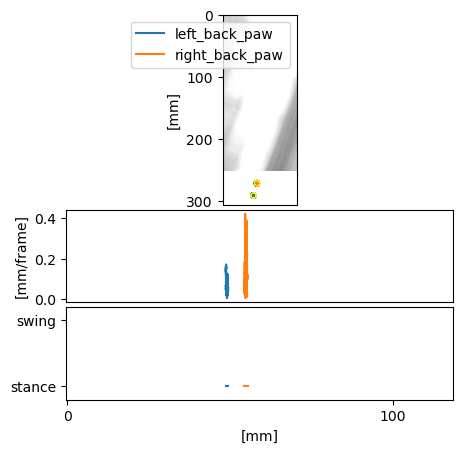

100%|██████████| 65780/65780 [00:00<00:00, 257961.63it/s]


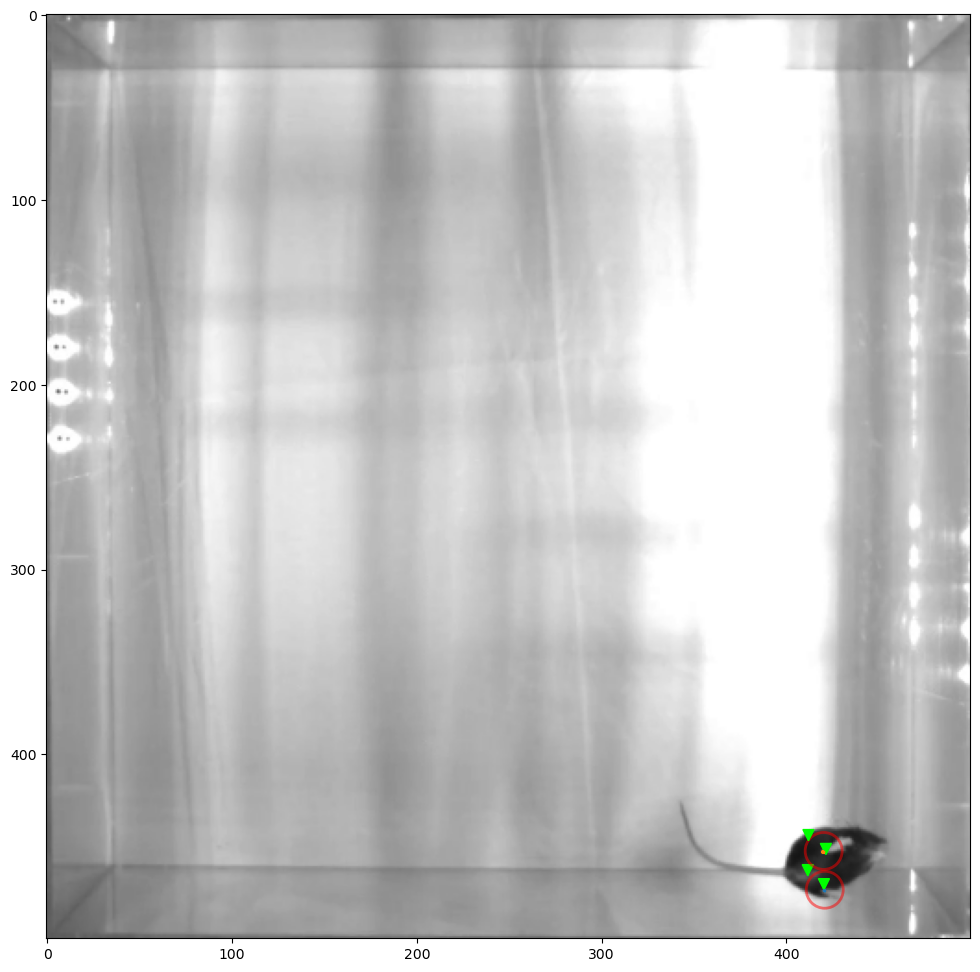

In [6]:
results = []

validation_dir = Path("validation")
! rm -rf {validation_dir}
! mkdir -p {validation_dir} 

print(len(raw_videos))
for video_idx, video in enumerate(raw_videos):
    print(f"Video {video_idx+1}/{len(raw_videos)}")
    fname = video.parts[-1].split('.')[0]

    try:
        dlc_file = next(data_folder.glob(f'labels/{fname}DLC*.h5'))
    except:
        print("DID NOT FIND DLC FILE!")
        continue

    video_analysis = VideoAnalysis(
        video,
        dlc_file)

    video_analysis.keypoints = filter_likelihood(video_analysis.keypoints, 0.8)
    video_analysis.keypoints = filter_distance_traveled(video_analysis.keypoints, 10, 1)
    
    # Registration
    video = Path(video_analysis.video).parts[-1]
    registration_points = pd.read_csv(data_folder / "registration_points.csv")
    registration_points['video'] = registration_points.video.apply(lambda x: Path(x).parts[-1])
    points = registration_points.groupby('video').get_group(video)[['y', 'x']].values
    w, h = 500, 500

    target = [[0,0], [w,0], [w,h], [0,h]]
    target = np.array(target)
    transformer = PerspectiveTransformer()
    transformer.register(points, target)
    keypoints = transformer.apply(video_analysis.keypoints)
    reader = VideoReader(video_analysis.video, transforms=[transformer])

    # Steps
    # for bodypart in ['left_back_paw']:
    for bodypart in ['left_back_paw', 'right_back_paw']:
        bodypart_df = keypoints.xs(bodypart, axis=1, level='bodyparts').droplevel(0, axis=1)

        distances = []
        distance_threshold = 0.8
        # distance_threshold = 1.4
        d = 5
        for i in range(1, d):
            deltas = bodypart_df.diff(i).shift(-i)
            distance = np.log(np.sqrt(deltas.x**2 + deltas.y**2))
            distances.append(distance)
            
        distances = sum(distances) / len(distances)
        distance_forward = distances < distance_threshold

        distances = []
        for i in range(-d, 0):
            deltas = bodypart_df.diff(i)
            distance = np.log(np.sqrt(deltas.x**2 + deltas.y**2))
            distances.append(distance)
            
        distances = sum(distances) / len(distances)
        distance_backwards = distances < distance_threshold
        phase = distance_forward | distance_backwards

        # Correction
        # ----------
        step_df = pd.DataFrame(index=distance.index, columns=['state', 'episode'])
        step_df.state = phase.apply(lambda x: 'swing' if x else 'stance')
        episode = 0
        last = None
        segment_start = 0
        for idx in tqdm(step_df.index):
            current = step_df.loc[idx].state
            if current != last:
                step_df.loc[segment_start:idx, 'episode'] = episode
                episode += 1
                segment_start = idx
                last = current

        step_df.loc[segment_start:idx, 'episode'] = episode

        # Collapse small episodes
        min_episode_size = 3
        for episode in tqdm(sorted(step_df.episode.unique())):
            index = step_df[step_df.episode == episode].iloc[0].name
            if index-1 not in step_df.index:
                continue

            previous = step_df.loc[index-1]

            # Collapse small episodes
            if (step_df.episode == episode).sum() < min_episode_size:
                step_df.loc[step_df.episode == episode, 'episode'] = previous.episode
                step_df.loc[step_df.episode == episode, 'state'] = previous.state
                
            # Collapse side by side episodes of the same state
            if step_df.loc[index, 'state'] == previous.state:
                step_df.loc[step_df.episode == episode, 'episode'] = previous.episode

        # Renumber episodes
        episode_renumbering = {o:n for n,o in enumerate(sorted(step_df.episode.unique()))}
        step_df.episode = step_df.episode.apply(lambda x: episode_renumbering[x])

        # Episode output
        episode_df = pd.DataFrame(columns=['stride_length', 'duration', 'state', 'start', 'end'], index=sorted(step_df.episode.unique()))

        for episode, group in step_df.groupby('episode'):
            group = group.dropna()

            start_index = group.iloc[0].name
            end_index = group.iloc[-1].name

            deltas = bodypart_df.loc[[start_index,end_index]].diff().iloc[1]
            distance = np.sqrt(deltas.x**2 + deltas.y**2)

            episode_df.loc[episode, 'state'] = group.iloc[0].state
            episode_df.loc[episode, 'stride_length'] = distance
            episode_df.loc[episode, 'duration'] = end_index - start_index
            episode_df.loc[episode, 'start'] = start_index
            episode_df.loc[episode, 'end'] = end_index
            # TODO look at distance left/right along line

        episode_df = episode_df.dropna()

        # Remove outliers 
        episode_df['duration'] = episode_df['duration'].apply(lambda x: np.nan if x > 30 else x)
        # episode_df['stride_length'] = episode_df['stride_length'].apply(lambda x: np.nan if x < 10 else x)
        episode_df['stride_length'] = episode_df['stride_length'].apply(lambda x: np.nan if x > 120 else x)

        # for column in ['stride_length', 'duration']:
        #     std = episode_df[column].std()
        #     mean = episode_df[column].mean()
        #     episode_df[column] = episode_df[column].apply(lambda x: np.nan if x > mean+3*std else x)

        episode_df = episode_df.dropna()

        swing = episode_df[episode_df.state == 'swing']
        print(f"{fname}, steps: {len(swing)} -- {bodypart}, "
              f"stride-length: {swing.stride_length.mean():.2f} +/- {swing.stride_length.std():.2f}, "
              f"duration: {swing.duration.mean():.2f} +/- {swing.duration.std():.2f}")

        result = dict(
            video=video,
            bodypart=bodypart,
            steps=len(swing),
            stride_length_median=swing.stride_length.median(),
            stride_length_mean=swing.stride_length.mean(),
            stride_length_var=swing.stride_length.var(),
            duration_median=swing.duration.median(),
            duration_mean=swing.duration.mean(),
            duration_std=swing.duration.std(),
        )
        results.append(result)    

    # Validate
    ! mkdir -p {validation_dir/fname}
    start = 11000
    duration = 500
    end = start + duration
    bodyparts = ['left_back_paw', 'right_back_paw' ]
    keypoints = transformer.apply(video_analysis.keypoints)
    reader = VideoReader(video_analysis.video, transforms=[transformer])
    visualize_step_by_distance(
        reader, keypoints, bodyparts, start, duration, marker_size=10, threshold=2)
    
    plt.savefig(validation_dir / fname / 'fig1.png')
    plt.show()
    plt.close()

    plot_steps(
        reader, 
        keypoints, 
        start, 
        duration,
        stance_threshold=1.4, 
        swing_threshold=2.0,
        rolling_window=5,
        display_touch_positions=True)

    plt.savefig(validation_dir / fname / 'fig2.png')
    plt.show()
    plt.close()


In [129]:
ls {data_folder}/labels/m13

/home/andretelfer/shared/curated/thea/v3/labels/m13-1_recording1DLC_resnet50_GaitFeb28shuffle2_1030000.h5
/home/andretelfer/shared/curated/thea/v3/labels/m13-1_recording1DLC_resnet50_GaitFeb28shuffle2_1030000_labeled.mp4
/home/andretelfer/shared/curated/thea/v3/labels/m13-1_recording1DLC_resnet50_GaitFeb28shuffle2_1030000_meta.pickle
/home/andretelfer/shared/curated/thea/v3/labels/m13-2_recording1DLC_resnet50_GaitFeb28shuffle2_1030000.h5
/home/andretelfer/shared/curated/thea/v3/labels/m13-2_recording1DLC_resnet50_GaitFeb28shuffle2_1030000_labeled.mp4
/home/andretelfer/shared/curated/thea/v3/labels/m13-2_recording1DLC_resnet50_GaitFeb28shuffle2_1030000_meta.pickle
/home/andretelfer/shared/curated/thea/v3/labels/m13_acclimationDLC_resnet50_GaitFeb28shuffle2_1030000.h5
/home/andretelfer/shared/curated/thea/v3/labels/m13_acclimationDLC_resnet50_GaitFeb28shuffle2_1030000_labeled.mp4
/home/andretelfer/shared/curated/thea/v3/labels/m13_acclimationDLC_resnet50_GaitFeb28shuffle2_1030000_meta.pi

In [144]:
results

[{'video': 'm01_baseline.mp4',
  'bodypart': 'left_back_paw',
  'steps': 801,
  'stride_length_median': 3.449254637454601,
  'stride_length_mean': 4.036070838749013,
  'stride_length_var': 5.845523026393395,
  'duration_median': 9.0,
  'duration_mean': 11.379525593008738,
  'duration_std': 7.798447298960017},
 {'video': 'm01_baseline.mp4',
  'bodypart': 'right_back_paw',
  'steps': 914,
  'stride_length_median': 3.5825895386123863,
  'stride_length_mean': 4.088551642888013,
  'stride_length_var': 6.0557268447697945,
  'duration_median': 12.0,
  'duration_mean': 12.560175054704596,
  'duration_std': 7.4744684354209605},
 {'video': 'm01_recording1.mp4',
  'bodypart': 'left_back_paw',
  'steps': 412,
  'stride_length_median': 3.6275146724560168,
  'stride_length_mean': 4.20083394719876,
  'stride_length_var': 6.524085208131775,
  'duration_median': 11.0,
  'duration_mean': 12.048543689320388,
  'duration_std': 7.572364457030977},
 {'video': 'm01_recording1.mp4',
  'bodypart': 'right_back_

In [7]:
pd.DataFrame(results).to_csv('results.csv')

In [8]:
df = pd.DataFrame(results)
df

,video,bodypart,steps,stride_length_median,stride_length_mean,stride_length_var,duration_median,duration_mean,duration_std
0,m01_baseline.mp4,left_back_paw,801,3.449255,4.036071,5.845523,9.0,11.379526,7.798447
1,m01_baseline.mp4,right_back_paw,914,3.582590,4.088552,6.055727,12.0,12.560175,7.474468
2,m01_recording1.mp4,left_back_paw,412,3.627515,4.200834,6.524085,11.0,12.048544,7.572364
3,m01_recording1.mp4,right_back_paw,438,4.173680,4.669902,9.214440,13.0,14.116438,8.131227
4,m01_recording2.mp4,left_back_paw,644,3.849859,4.386099,6.587060,10.0,11.767081,7.661487
...,...,...,...,...,...,...,...,...,...
117,m20_recording1.mp4,right_back_paw,256,4.363286,4.521368,6.181111,11.0,11.843750,7.373974
118,m20_recording2.mp4,left_back_paw,332,4.257842,4.584656,7.389509,10.0,11.948795,7.855594
119,m20_recording2.mp4,right_back_paw,340,3.819282,4.258941,5.191321,10.0,11.520588,7.481907
120,m20_recording3.mp4,left_back_paw,561,3.567442,4.024475,5.771035,10.0,11.465241,7.692015


In [132]:
for v in df.video:
    try:
        name_extraction.match(v).groups()
    except:
        print(v)


In [9]:
import re

name_extraction = re.compile("(m\d+)(\-\d)?\_([a-zA-Z0-9]*)\.mp4")
for idx, row in df.iterrows():
    mouse, version, recording = name_extraction.match(row.video).groups()
    df.loc[idx, 'mouse'] = mouse
    df.loc[idx, 'version'] = version
    df.loc[idx, 'recording'] = recording

df

,video,bodypart,steps,stride_length_median,stride_length_mean,stride_length_var,duration_median,duration_mean,duration_std,mouse,version,recording
0,m01_baseline.mp4,left_back_paw,801,3.449255,4.036071,5.845523,9.0,11.379526,7.798447,m01,NaN,baseline
1,m01_baseline.mp4,right_back_paw,914,3.582590,4.088552,6.055727,12.0,12.560175,7.474468,m01,NaN,baseline
2,m01_recording1.mp4,left_back_paw,412,3.627515,4.200834,6.524085,11.0,12.048544,7.572364,m01,NaN,recording1
3,m01_recording1.mp4,right_back_paw,438,4.173680,4.669902,9.214440,13.0,14.116438,8.131227,m01,NaN,recording1
4,m01_recording2.mp4,left_back_paw,644,3.849859,4.386099,6.587060,10.0,11.767081,7.661487,m01,NaN,recording2
...,...,...,...,...,...,...,...,...,...,...,...,...
117,m20_recording1.mp4,right_back_paw,256,4.363286,4.521368,6.181111,11.0,11.843750,7.373974,m20,NaN,recording1
118,m20_recording2.mp4,left_back_paw,332,4.257842,4.584656,7.389509,10.0,11.948795,7.855594,m20,NaN,recording2
119,m20_recording2.mp4,right_back_paw,340,3.819282,4.258941,5.191321,10.0,11.520588,7.481907,m20,NaN,recording2
120,m20_recording3.mp4,left_back_paw,561,3.567442,4.024475,5.771035,10.0,11.465241,7.692015,m20,NaN,recording3


In [10]:
df.to_csv('results2.csv')

In [11]:
results = pd.read_csv('results2.csv', index_col=0)
results

,video,bodypart,steps,stride_length_median,stride_length_mean,stride_length_var,duration_median,duration_mean,duration_std,mouse,version,recording
0,m01_baseline.mp4,left_back_paw,801,3.449255,4.036071,5.845523,9.0,11.379526,7.798447,m01,NaN,baseline
1,m01_baseline.mp4,right_back_paw,914,3.582590,4.088552,6.055727,12.0,12.560175,7.474468,m01,NaN,baseline
2,m01_recording1.mp4,left_back_paw,412,3.627515,4.200834,6.524085,11.0,12.048544,7.572364,m01,NaN,recording1
3,m01_recording1.mp4,right_back_paw,438,4.173680,4.669902,9.214440,13.0,14.116438,8.131227,m01,NaN,recording1
4,m01_recording2.mp4,left_back_paw,644,3.849859,4.386099,6.587060,10.0,11.767081,7.661487,m01,NaN,recording2
...,...,...,...,...,...,...,...,...,...,...,...,...
117,m20_recording1.mp4,right_back_paw,256,4.363286,4.521368,6.181111,11.0,11.843750,7.373974,m20,NaN,recording1
118,m20_recording2.mp4,left_back_paw,332,4.257842,4.584656,7.389509,10.0,11.948795,7.855594,m20,NaN,recording2
119,m20_recording2.mp4,right_back_paw,340,3.819282,4.258941,5.191321,10.0,11.520588,7.481907,m20,NaN,recording2
120,m20_recording3.mp4,left_back_paw,561,3.567442,4.024475,5.771035,10.0,11.465241,7.692015,m20,NaN,recording3


In [17]:
results = pd.read_csv('results2.csv', index_col=0)
temp = results.groupby('video').agg({'mouse': 'first', 'steps': 'mean', 'stride_length_mean': 'mean', 'stride_length_var': 'mean', 'duration_mean': 'mean', 'duration_std': 'mean', 'recording': 'first'})

for idx, group in temp.groupby('mouse'):
    baseline = group[group.recording == 'baseline'].iloc[0]

    temp.loc[group.index, 'stride_length_mean'] /= baseline['stride_length_mean']
    temp.loc[group.index, 'stride_length_var'] /= baseline['stride_length_var']
    temp.loc[group.index, 'duration_mean'] /= baseline['duration_mean']
    temp.loc[group.index, 'duration_std'] /= baseline['duration_std']

treatments = pd.read_csv(data_folder/'treatments.csv')
treatments['mouse'] = treatments.Animal.apply(lambda x: f"m{x:02}")
treatments['treatment'] = treatments['Treatment ']
treatments = treatments[['mouse', 'treatment']]
temp = temp.merge(treatments, on='mouse')

order = ['baseline', 'recording1', 'recording2', 'recording3']
temp['order'] = temp.recording.apply(lambda x: order.index(x))
temp.to_csv('final.csv')
temp

,mouse,steps,stride_length_mean,stride_length_var,duration_mean,duration_std,recording,treatment,order
0,m01,857.5,1.000000,1.000000,1.000000,1.000000,baseline,PQ,0
1,m01,857.5,1.000000,1.000000,1.000000,1.000000,baseline,PQ,0
2,m01,857.5,1.000000,1.000000,1.000000,1.000000,baseline,PQ,0
3,m01,857.5,1.000000,1.000000,1.000000,1.000000,baseline,PQ,0
4,m01,425.0,1.091834,1.322426,1.092954,1.028199,recording1,PQ,1
...,...,...,...,...,...,...,...,...,...
239,m20,336.0,0.947668,0.877666,0.916769,0.984566,recording2,SAL,2
240,m20,567.5,0.872937,0.886317,0.897485,0.970228,recording3,SAL,3
241,m20,567.5,0.872937,0.886317,0.897485,0.970228,recording3,SAL,3
242,m20,567.5,0.872937,0.886317,0.897485,0.970228,recording3,SAL,3


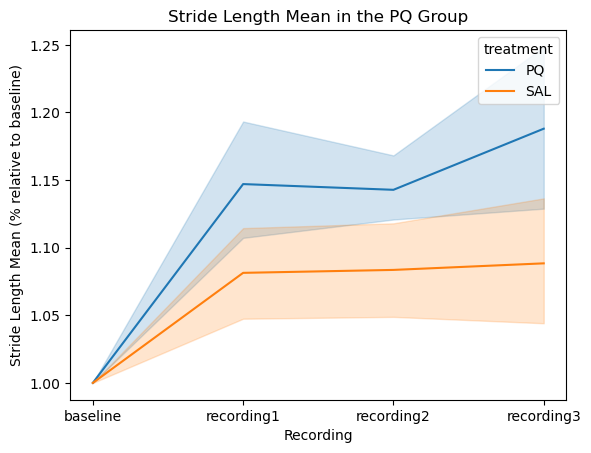

In [13]:
sns.lineplot(data=temp, x='order', y='stride_length_mean', hue='treatment')
plt.ylabel('Stride Length Mean (% relative to baseline)')

xticks, xlabels = plt.xticks()
plt.xticks(ticks=[0,1,2,3], labels=order)
plt.xlabel("Recording")
plt.title("Stride Length Mean in the PQ Group")
plt.savefig('PQ-stride-length-mean.png')

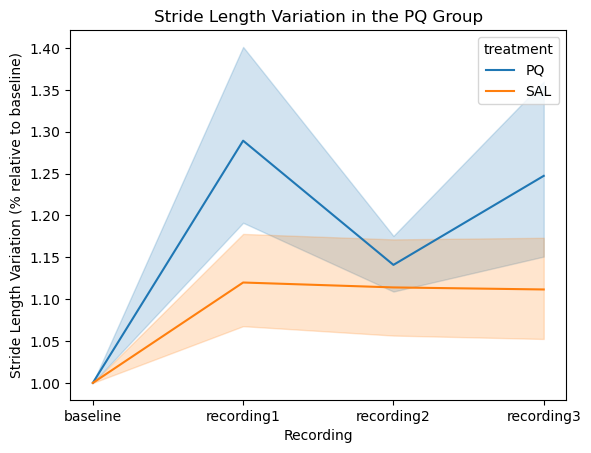

In [14]:
sns.lineplot(data=temp, x='order', y='stride_length_var', hue='treatment')
plt.ylabel('Stride Length Variation (% relative to baseline)')

xticks, xlabels = plt.xticks()
plt.xticks(ticks=[0,1,2,3], labels=order)
plt.xlabel("Recording")
plt.title("Stride Length Variation in the PQ Group")
plt.savefig('PQ-stride-length-var.png')

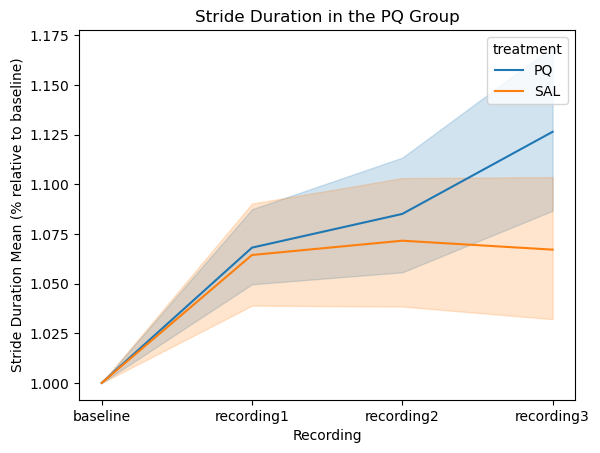

In [15]:
sns.lineplot(data=temp, x='order', y='duration_mean', hue='treatment')
plt.ylabel('Stride Duration Mean (% relative to baseline)')

xticks, xlabels = plt.xticks()
plt.xticks(ticks=[0,1,2,3], labels=order)
plt.xlabel("Recording")
plt.title("Stride Duration in the PQ Group")
plt.savefig('PQ-stride-duration-mean.png')

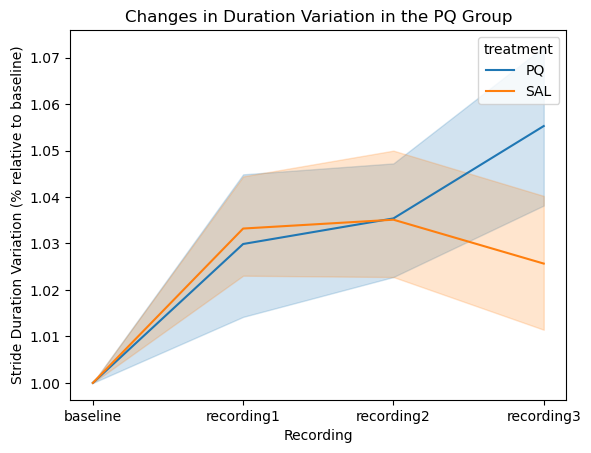

In [16]:
sns.lineplot(data=temp, x='order', y='duration_std', hue='treatment')
plt.ylabel('Stride Duration Variation (% relative to baseline)')

xticks, xlabels = plt.xticks()
plt.xticks(ticks=[0,1,2,3], labels=order)
plt.xlabel("Recording")
plt.title("Changes in Duration Variation in the PQ Group")
plt.savefig('PQ-stride-duration-var.png')